## **Group Members**

Group 35: Our Group is composed by:

  - Filipe Ferreira -20240741
  - Helena Duarte- 20240530
  - Iris Moreira-20240659
  - João Freire-20240528
  - Osmainy Raimundo-e20191506



# **THE PROBLEM**

* New York Workers' Compensation Board (WCB) handles and reviews a lot of claims for workplace injuries
* Our job is to predict the "Claim Injury Type" (type of injury) that represents the deliberation of WCB relative to benefits awarded to the injured worker
* <strong>"Claim Injury Type"</strong> is our main target variable, and it’s a multiclass classification problem
* The injury type indicates the severity of the injury , and the model will predict the most appropriate injury type for each new claim



## Other small problems

* Create a model that predicts other variables : **WCB Decision** or **Agreement Reached**
* Check whether using these variables as features improves the performance of your models.

## **METADATA**

- *Accident Date* - Injury date of the claim. 
- *Age at Injury* - Age of injured worker when the injury occurred.
- *Alternative Dispute Resolution* - Adjudication processes external to the Board.
- *Assembly Date* - The date the claim was first assembled.
- *Attorney/Representative* - Is the claim being represented by an Attorney?
- *Average Weekly Wage*  - The wage used to calculate workers’ compensation, disability, or an Paid Leave wage replacement benefits.
- *Birth Year* - The reported year of birth of the injured worker.
- *C-2 Date* - Date of receipt of the Employer's Report of Work-Related Injury/Illness or equivalent (formerly Form C-2).
- *C-3 Date* -  Date Form C-3 (Employee Claim Form) was received.
- *Carrier Name* - Name of primary insurance provider responsible for providing workers’ compensation coverage to the injured worker’s employer.
- *Carrier Type* - Type of primary insurance provider responsible for providing workers’ compensation coverage.
- *Claim Identifier* - Unique identifier for each claim, assigned by WCB
- *County of Injury* - Name of the New York County where the injury occurred.
- *COVID-19 Indicator* - Indication that the claim may be associated with COVID-19.
- *District Name* - Name of the WCB district office that oversees claims for that region or area of the state.
- *First Hearing Date* - Date the first hearing was held on a claim at a WCB hearing location. A blank date means the claim has not yet had a hearing held.
- *Gender* - The reported gender of the injured worker.
- *IME-4 Count* - Number of IME-4 forms received per claim. The IME-4 form is the “Independent Examiner's Report of Independent Medical Examination” form.
- *Industry Code* - NAICS code and descriptions are available at: https://www.naics.com/search-naics-codes-by-industry/.
- *Industry Code Description* - 2-digit NAICS industry code description used to classify businesses according to their economic activity.
- *Medical Fee Region* - Approximate region where the injured worker would receive medical service.
  
- *OIICS Nature of Injury Description* - The OIICS nature of injury codes & descriptions are available at bls.gov/iif/oiics_manual_2007.pemployees_train .
- *WCIO Cause of Injury Code* - The WCIO cause of injury codes & descriptions are at https://www.wcio.org/Active%20PNC/WCIO_Cause_Table.pemployees_train .
- *WCIO Cause of Injury Description* - See description of field above.
- *WCIO Nature of Injury Code* -The WCIO nature of injury are available at https://wwwn.cdc.gov/wisards/oiics/Trees/MultiTree.aspx?TreeType=BodyPart
- *WCIO Nature of Injury Description* - See description of field above.
- *WCIO Part Of Body Code* - The WCIO part of body codes & descriptions are available at https://wwwn.cdc.gov/wisards/oiics/Trees/MultiTree.aspx?TreeType=BodyPart
- *WCIO Part Of Body Description* - See description of field above.
- *Zip Code* - The reported ZIP code of the injured worker’s home address.
- *Agreement Reached* - Binary variable: Yes if there is an agreement without the involvement of the WCB -> unknown at the start of a claim.
- *WCB Decision* - Multiclass variable: Decision of the WCB relative to the claim: “Accident” means that claim refers to workplace accident, “Occupational Disease” means illness from the workplace. -> requires WCB deliberation so it is unknown at start of claim.
- <strong> *Claim Injury Type* - Main target variable: Deliberation of the WCB relative to benefits awarded to the claim. Numbering indicates severity. </strong>




## **Table of Contents**

<div class="alert alert-block alert-info">

- [1.Importing the necessary libraries](#2nd-bullet)<br>
- [2.Data Exploration](#2nd-bullet)<br>
- [3.Data Pre-Processing](#2nd-bullet)<br>
- [4.Feature Selection](#2nd-bullet)<br>
- [5.Modelling](#2nd-bullet)<br>
- [6.Deploymennt](#2nd-bullet)<br>

    
</div>

# Import the dataset and the libraries

Importing the necessary libraries

In [10]:
#Basic libraries libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from itertools import combinations
from math import ceil

#Exploratory Data Analysis
import scipy.stats as stats
from scipy.stats import chi2_contingency
pd.set_option('display.max_columns', None)


#Data Pre-Processing

#Scaling
from sklearn.preprocessing import MinMaxScaler

# encoders
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OrdinalEncoder, LabelEncoder
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

#Feature Selection
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import chi2, f_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LassoCV
from sklearn.feature_selection import mutual_info_classif


#Modelling
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import CategoricalNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.neighbors import KNeighborsClassifier


# metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report, confusion_matrix

StackingClassifier

import warnings
warnings.filterwarnings('ignore')



In [11]:
def overview(data):
    column = []
    dtypes = []
    unique = []
    missing = []
    pc_missing = []
    
    for item in data.columns:
        column.append(item) # feature name
        dtypes.append(data[item].dtype) # data type
        unique.append(len(data[item].unique())) # how many unique values in the feature
        missing.append(data[item].isna().sum()) # amount of missing values
        pc_missing.append(round((data[item].isna().sum() / len(data[item])) * 100, 2)) # percentage of missing values
    
    result = pd.DataFrame({
        'Column': column, 
        'Type': dtypes,
        'Unique': unique,
        'Missing': missing, 
        'Percentage Missing': pc_missing
    })
    
    return result

In [345]:
X_train_num = pd.read_csv("copy_X_train_num.csv", index_col="Claim Identifier")
X_train_cat = pd.read_csv("copy_X_train_cat.csv", index_col="Claim Identifier")
df_target_train = pd.read_csv("copy_target_train.csv", index_col="Claim Identifier")
X_train_all = pd.concat([X_train_num, X_train_cat], axis=1)

In [13]:
print(len(X_train_num))
print(len(X_train_cat))
print(len(df_target_train))
print(len(X_train_all))

401222
401222
401222
401222


In [14]:
X_val_num = pd.read_csv("copy_X_val_num.csv", index_col="Claim Identifier")
X_val_cat = pd.read_csv("copy_X_val_cat.csv", index_col="Claim Identifier")
df_target_val = pd.read_csv("copy_target_val.csv", index_col="Claim Identifier")
X_val_all = pd.concat([X_val_num, X_val_cat], axis=1)

In [15]:
print(len(X_val_num))
print(len(X_val_cat))
print(len(df_target_val))
print(len(X_val_all))

172208
172208
172208
172208


In [16]:
employees_test_num = pd.read_csv("copy_employees_test_num.csv", index_col="Claim Identifier")
employees_test_cat = pd.read_csv("copy_employees_test_cat.csv", index_col="Claim Identifier")
employees_test_all = pd.concat([employees_test_num,employees_test_cat], axis=1)

In [17]:
print(len(employees_test_num))
print(len(employees_test_cat))
print(len(employees_test_all))

387975
387975
387975


In [18]:
target_train = df_target_train['Claim Injury Type'].to_numpy()
target_val = df_target_val['Claim Injury Type'].to_numpy()

In [19]:
print(len(target_train))
print(len(target_val))

401222
172208


# Feature Selection

## Filter Methods

### Univariate Variables

In [347]:
X_train_num.var()

Age at Injury                             0.024672
Average Weekly Wage                       0.022368
Birth Year                                0.013612
Number of Dependents                      0.111173
Diff_days_assembly_accident               0.000697
Average Weekly Wage log                   0.156858
Carrier Name_Frqc                         0.142203
County of Injury_Frqc                     0.120710
District Name_Frqc                        0.163658
Industry Code Description_Frqc            0.103845
WCIO Part Of Body Description_Frqc        0.096446
WCIO Nature of Injury Description_Frqc    0.136776
WCIO Cause of Injury Description_Frqc     0.077929
AWW_Category_Frqc                         0.179375
age_injury_group_Frqc                     0.049953
Classification_Zip_Code_Frqc              0.098913
dtype: float64

### Correlation Indices

#### Pearson and Spearman Correlations (Numerical)

<Axes: >

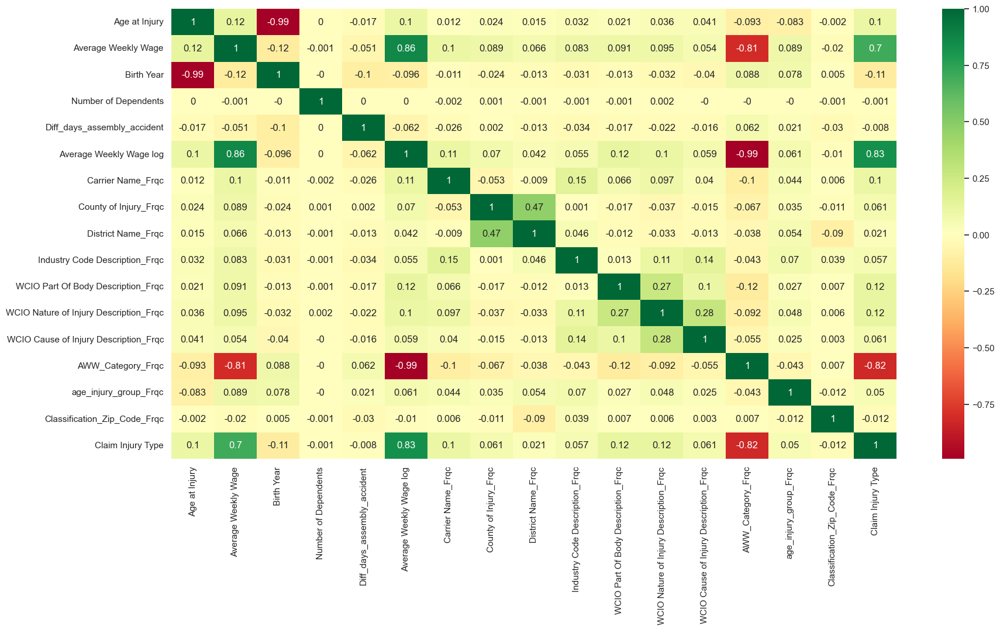

In [186]:
#plot heat map
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

<Axes: >

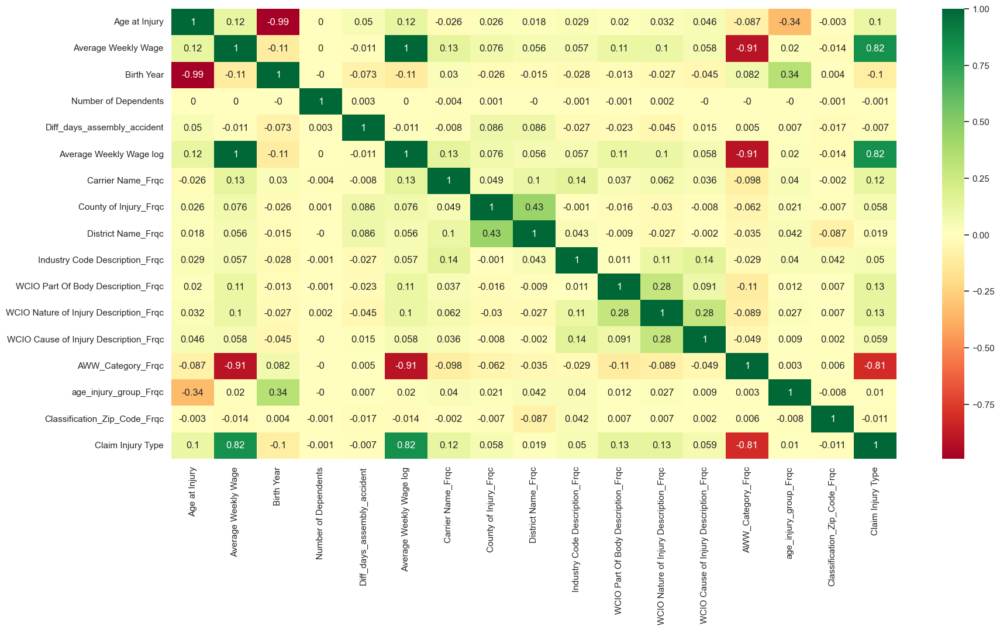

In [195]:
#plot heat map
plt.figure(figsize=(20,10))
sns.heatmap(X_train_and_target.corr(method='spearman').round(3), annot=True, cmap="RdYlGn")

**`Conclusion`**: <br>

*Very High Correlations:*
* Average Weekly Wage & Average Weekly Wage log & AWW_Category_Frq
* Birth Year & Age At Injury

*Highest Feature Relevancy with the target variable:*
* Average Weekly Wage & Average Weekly Wage log (choose one of these to keep)

**For now, We can discard AWW_Category_Frq variable.**

*Lowest Feature Relevancy with the target variable (considering a threshould of 0.05):*
* Number of Dependents
* Diff_days_assembly_accident
* District Name_Frqc
* age_injury_group_Frqc
* Classification_Zip_Code_Frqc

#### Chi-Squared (Categorical)

In [31]:
def TestIndependence(X,y,var,alpha=0.05):        
    dfObserved = pd.crosstab(y,X) 
    chi2, p, dof, expected = stats.chi2_contingency(dfObserved.values)
    dfExpected = pd.DataFrame(expected, columns=dfObserved.columns, index = dfObserved.index)
    if p<alpha:
        result="{0} is  \033[1;35mIMPORTANT\033[0m for Prediction".format(var)
    else:
        result="{0} is \033[1;36mNOT\033[0m an important predictor. (Discard {0} from model)".format(var)
    print(result)

In [32]:
for var in X_train_cat:
    print(var)

Attorney/Representative
has_c3_date
COVID-19 Indicator
has_first_hearing_date
has_ime
Alternative Dispute Resolution_N
Alternative Dispute Resolution_UNKNOWN
Alternative Dispute Resolution_Y
Carrier Type_1A. PRIVATE
Carrier Type_2A. SIF
Carrier Type_3A. SELF PUBLIC
Carrier Type_4A. SELF PRIVATE
Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)
Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS
Carrier Type_5D. SPECIAL FUND - UNKNOWN
Carrier Type_UNKNOWN
Gender_F
Gender_M
Gender_UNKNOWN
Gender_X
Medical Fee Region_I
Medical Fee Region_II
Medical Fee Region_III
Medical Fee Region_IV
Medical Fee Region_UNKNOWN
WCIO Part of Body Description Category_Head
WCIO Part of Body Description Category_Lower Extremities
WCIO Part of Body Description Category_Multiple Body Parts
WCIO Part of Body Description Category_Neck
WCIO Part of Body Description Category_Trunk
WCIO Part of Body Description Category_Unknown
WCIO Part of Body Description Category_Upper Extremities
WCIO Nature of Injur

In [33]:
for var in X_train_cat:
    TestIndependence(X_train_cat[var],target_train, var)

Attorney/Representative is  IMPORTANT for Prediction
has_c3_date is  IMPORTANT for Prediction
COVID-19 Indicator is  IMPORTANT for Prediction
has_first_hearing_date is  IMPORTANT for Prediction
has_ime is  IMPORTANT for Prediction
Alternative Dispute Resolution_N is  IMPORTANT for Prediction
Alternative Dispute Resolution_UNKNOWN is NOT an important predictor. (Discard Alternative Dispute Resolution_UNKNOWN from model)
Alternative Dispute Resolution_Y is  IMPORTANT for Prediction
Carrier Type_1A. PRIVATE is  IMPORTANT for Prediction
Carrier Type_2A. SIF is  IMPORTANT for Prediction
Carrier Type_3A. SELF PUBLIC is  IMPORTANT for Prediction
Carrier Type_4A. SELF PRIVATE is  IMPORTANT for Prediction
Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A) is  IMPORTANT for Prediction
Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS is  IMPORTANT for Prediction
Carrier Type_5D. SPECIAL FUND - UNKNOWN is  IMPORTANT for Prediction
Carrier Type_UNKNOWN is  IMPORTANT for Prediction
Gend

#### Mutual Information (Categorical)

In [35]:
mi_scores = mutual_info_classif(X_train_cat, target_train)

In [36]:
feature_importance = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'MI_Score': mi_scores
})
feature_importance = feature_importance.sort_values(by='MI_Score', ascending=False)
feature_importance

,Feature,MI_Score
51,AWW_Category_Zero,0.515118
4,has_ime,0.210682
0,Attorney/Representative,0.209929
3,has_first_hearing_date,0.162393
49,AWW_Category_Medium,0.148285
1,has_c3_date,0.121836
48,AWW_Category_Low,0.111461
34,WCIO Nature of Injury Description Category_Spe...,0.048266
46,WCIO Cause of Injury Description Category_Unknown,0.039028
35,WCIO Nature of Injury Description Category_Unk...,0.038839


Features with an MI score lower than 0.001:
- 'WCIO Cause of Injury Description Category_Striking Against or Stepping On'
- 'Alternative Dispute Resolution_UNKNOWN'
- 'Medical Fee Region_III'
- 'WCIO Cause of Injury Description Category_Caught In, Under or Between'
- 'age_injury_group_65+'
- 'Gender_UNKNOWN'
- 'WCIO Nature of Injury Description Category_Multiple Injuries'
- 'WCIO Cause of Injury Description Category_Rubbed or Abraded By'
- 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'
- 'age_injury_group_< 18'

**Class Specific mutual information classification**

In [38]:


for target_class in df_target_train['Claim Injury Type'].unique():

    binary_target = (df_target_train['Claim Injury Type'] == target_class).astype(int)
    
    mi_scores = mutual_info_classif(X_train_cat, binary_target)
    
    mi_df = pd.DataFrame({
        'Feature': X_train_cat.columns,
        'MI Score': mi_scores
    })
    
    mi_df = mi_df.sort_values(by='MI Score', ascending=False)
    
    print(f"MI scores for class \033[1;35m{target_class}\033[1;0m:")
    print(mi_df) 
    print("\n")


MI scores for class 1:
                                              Feature  MI Score
51                                  AWW_Category_Zero  0.420100
0                             Attorney/Representative  0.176831
4                                             has_ime  0.167600
3                              has_first_hearing_date  0.152627
49                                AWW_Category_Medium  0.126050
1                                         has_c3_date  0.112329
48                                   AWW_Category_Low  0.097635
17                                           Gender_M  0.041467
5                    Alternative Dispute Resolution_N  0.038491
34  WCIO Nature of Injury Description Category_Spe...  0.038355
8                            Carrier Type_1A. PRIVATE  0.037869
47                                  AWW_Category_High  0.032825
50                              AWW_Category_Very Low  0.031669
23                              Medical Fee Region_IV  0.029213
16               

We observed that although most of the features have common abundant features, some features score higher for some categories.

In [ ]:
X_train_cat['WCIO Nature of Injury Description Category_Multiple Injuries' 

Highest and second highest MI score for each class:

- class 0 - 'WCIO Nature of Injury Description Category_Specific Injury'; 'AWW_Category_Zero'
- class 1 - 'AWW_Category_Zero'; 'Attorney/Representative'
- class 2 - 'AWW_Category_Zero'; 'Gender_M'
- class 3 - 'AWW_Category_Zero'; 'AWW_Category_Low'
- class 4 - 'AWW_Category_Zero'; 'Attorney/Representative'
- class 5 - 'AWW_Category_Zero'; 'Gender_M'
- class 6 - 'AWW_Category_Zero'; 'Gender_M'
- class 7 - 'AWW_Category_Zero'; 'WCIO Nature of Injury Description Category_Specific Injury'

Lowest MI score for each class (MI score = 0.000000):

- class 0 - 'age_injury_group_< 18'; 'WCIO Cause of Injury Description Category_Rubbed or Abraded By; 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'; 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'WCIO Part of Body Description Category_Neck'; 'Alternative Dispute Resolution_UNKNOWN'; 'Alternative Dispute Resolution_Y'
- class 1 - 'Alternative Dispute Resolution_UNKNOWN'; 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'; 'WCIO Part of Body Description Category_Unknown';
- class 2 - 'Alternative Dispute Resolution_UNKNOWN'; 'Alternative Dispute Resolution_Y'; 'WCIO Nature of Injury Description Category_Multiple Injuries' ; 'WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With'
- class 3 - 'age_injury_group_< 18'; 'WCIO Cause of Injury Description Category_Caught In, Under or Between'; 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'; 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- class 4 - 'age_injury_group_< 18'; 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'; 'Gender_X'; 'Carrier Type_UNKNOWN'
- class 5 - 'age_injury_group_< 18'; 'Alternative Dispute Resolution_UNKNOWN'
- class 6 - 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'; 'Gender_X'
- class 7 - 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS'; 'Gender_X'; 'WCIO Cause of Injury Description Category_Rubbed or Abraded By'; 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'

Should drop?
- 'WCIO Cause of Injury Description Category_Striking Against or Stepping On' 
- 'Alternative Dispute Resolution_UNKNOWN'
- 'Medical Fee Region_III'
- 'WCIO Cause of Injury Description Category_Caught In, Under or Between'
- 'age_injury_group_65+'
- 'Gender_UNKNOWN'
- 'WCIO Nature of Injury Description Category_Multiple Injuries'
- 'WCIO Cause of Injury Description Category_Rubbed or Abraded By'
- 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- 'Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)'
- 'Carrier Type_5D. SPECIAL FUND - UNKNOWN'
- 'age_injury_group_< 18'

#### Cramers' V (Categorical)

In [531]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = stats.chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    return np.sqrt(chi2 / (n * (min(confusion_matrix.shape) - 1)))

In [533]:
df_cramers = pd.concat([X_train_cat, df_target_train], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1  #perfect association with itself

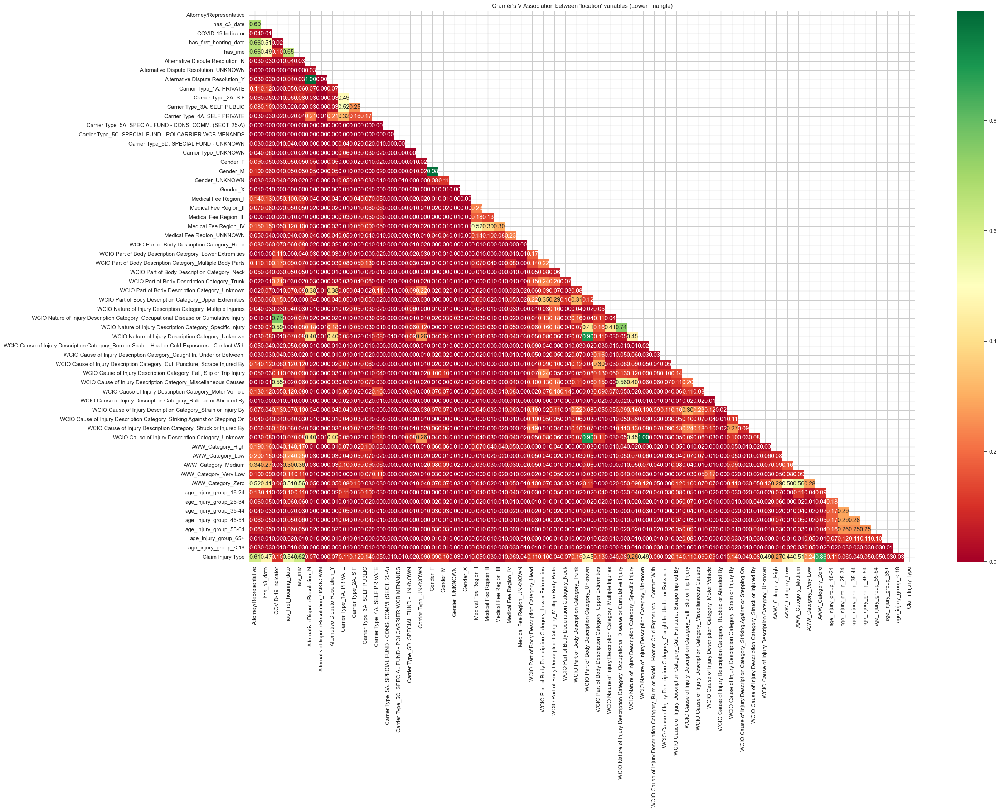

In [534]:
#Heatmap of Cramér's V
results = results.astype(float)
mask = np.triu(np.ones_like(results, dtype=bool))
plt.figure(figsize=(30, 20))
sns.heatmap(results, annot=True, cmap="RdYlGn", cbar=True, mask=mask, fmt='.2f', linewidths=0, linecolor='white')
plt.title("Cramér's V Association between 'location' variables (Lower Triangle)")

plt.show()

`Feature Relevancy`  (Threshould used: 0.5)

In [319]:
results[results.iloc[:, -1] > 0.15]["Claim Injury Type"].sort_values(ascending=False)

Claim Injury Type                                             1.000000
AWW_Category_Zero                                             0.864949
has_ime                                                       0.622540
Attorney/Representative                                       0.612566
has_first_hearing_date                                        0.540942
AWW_Category_Medium                                           0.510765
WCIO Nature of Injury Description Category_Unknown            0.493561
WCIO Cause of Injury Description Category_Unknown             0.493496
has_c3_date                                                   0.472179
WCIO Part of Body Description Category_Unknown                0.454744
AWW_Category_Low                                              0.441319
AWW_Category_High                                             0.267268
WCIO Nature of Injury Description Category_Specific Injury    0.261297
AWW_Category_Very Low                                         0.242665
Name: 

`Feature Redundancy` (Threshould used: 0.6)
- 'Attorney/Representative' & 'has_ime' & 'has_first_hearing_date' & 'has_c3_date' (***Maybe drop 'has_c3_date'***)
- 'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury' & 'Covid-19_indicator' & 'WCIO Nature of Injury Description Category_Specific Injury' (***Maybe drop the WCIO related to Occupational Disease and 'Covid-19_indicator'***)
- 'Alternative Dispute Resolution_Y' & 'Alternative Dispute Resolution_N' (***Maybe drop both***)
- 'Gender_M' & 'Gender_F' -> (***Maybe drop 'Gender_F'***)
- 'WCIO Part of Body Description Category_Unknown' & 'WCIO Cause of Injury Description Category_Unknown' & 'WCIO Nature of Injury Description Category_Unknown -> (***Maybe drop 'WCIO Part of Body Description Category_Unknown'***)

In [315]:
#(results[(results.iloc[:, :-1] > 0.5) & (results.iloc[:, :-1] < 1)])

### SelectKBest

In [46]:
X_new = SelectKBest(k='all').fit(X_train_num, target_train)
kbest_features = pd.DataFrame(X_new.scores_, X_new.feature_names_in_).rename(columns={0: "Score"})

In [47]:
kbest_features.sort_values("Score", ascending=False, inplace=True)

In [48]:
kbest_features

,Score
Average Weekly Wage log,166920.189588
AWW_Category_Frqc,160866.056110
Average Weekly Wage,61542.254139
WCIO Nature of Injury Description_Frqc,1273.657321
WCIO Part Of Body Description_Frqc,1044.805881
Birth Year,932.632181
Carrier Name_Frqc,858.593741
Age at Injury,821.796168
Industry Code Description_Frqc,599.964819
Diff_days_assembly_accident,513.113070


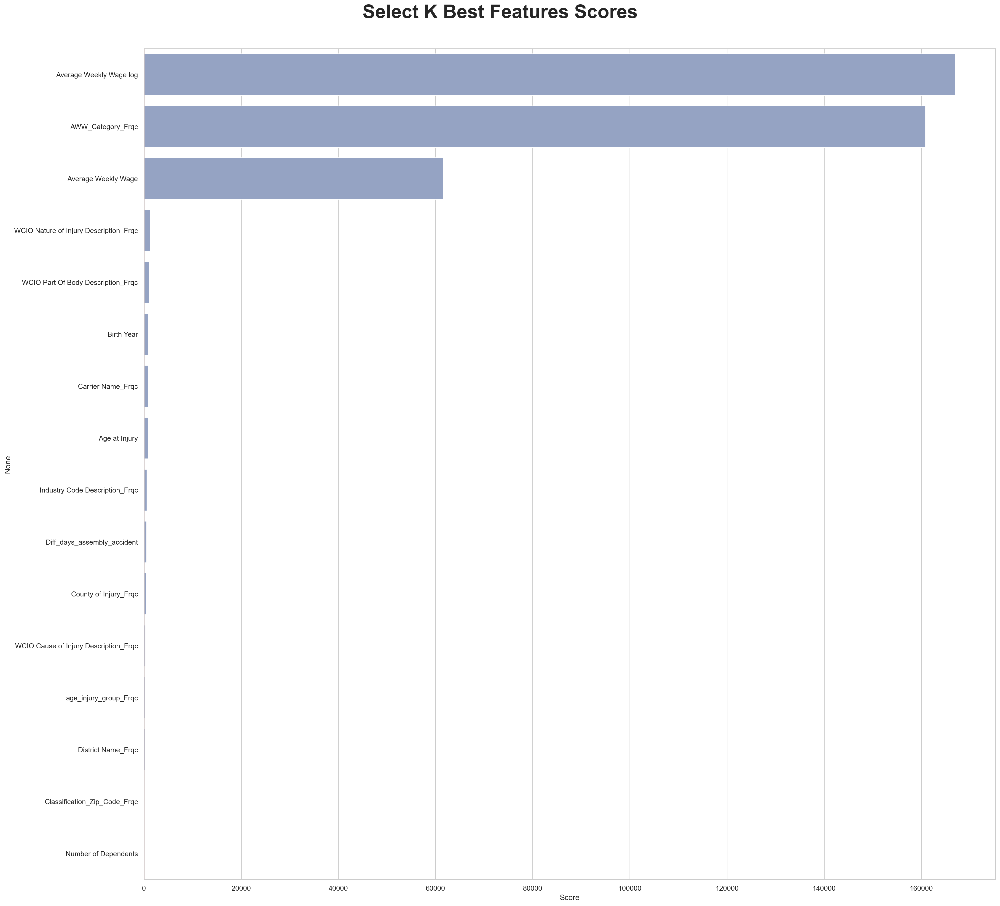

In [49]:
sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
#plt.savefig('Figures/SelectKBest_BarChart.png', dpi=600, bbox_inches='tight')
plt.show()

In [50]:
kbest_features_bool=[]
for elem in kbest_features["Score"]:
    if elem > 300:  #limit of 300: seems reasonable given the x range and distribution
        kbest_features_bool.append(True)
    else:
        kbest_features_bool.append(False)

In [51]:
k_features = pd.Series(kbest_features_bool, index = kbest_features.index).reindex(X_train_num.columns)

In [52]:
k_features

Age at Injury                              True
Average Weekly Wage                        True
Birth Year                                 True
Number of Dependents                      False
Diff_days_assembly_accident                True
Average Weekly Wage log                    True
Carrier Name_Frqc                          True
County of Injury_Frqc                      True
District Name_Frqc                        False
Industry Code Description_Frqc             True
WCIO Part Of Body Description_Frqc         True
WCIO Nature of Injury Description_Frqc     True
WCIO Cause of Injury Description_Frqc     False
AWW_Category_Frqc                          True
age_injury_group_Frqc                     False
Classification_Zip_Code_Frqc              False
dtype: bool

**Select K-Best: Categorical Variables**

In [54]:
X_new = SelectKBest(k='all').fit(X_train_cat, target_train)
kbest_features = pd.DataFrame(X_new.scores_, X_new.feature_names_in_).rename(columns={0: "Score"})

In [55]:
kbest_features.sort_values("Score", ascending=False, inplace=True)

In [56]:
kbest_features

,Score
AWW_Category_Zero,170253.532399
has_ime,36269.973235
Attorney/Representative,34424.595446
has_first_hearing_date,23709.701886
AWW_Category_Medium,20230.466597
WCIO Nature of Injury Description Category_Unknown,18459.024137
WCIO Cause of Injury Description Category_Unknown,18452.681577
has_c3_date,16445.397315
WCIO Part of Body Description Category_Unknown,14942.566597
AWW_Category_Low,13863.054631


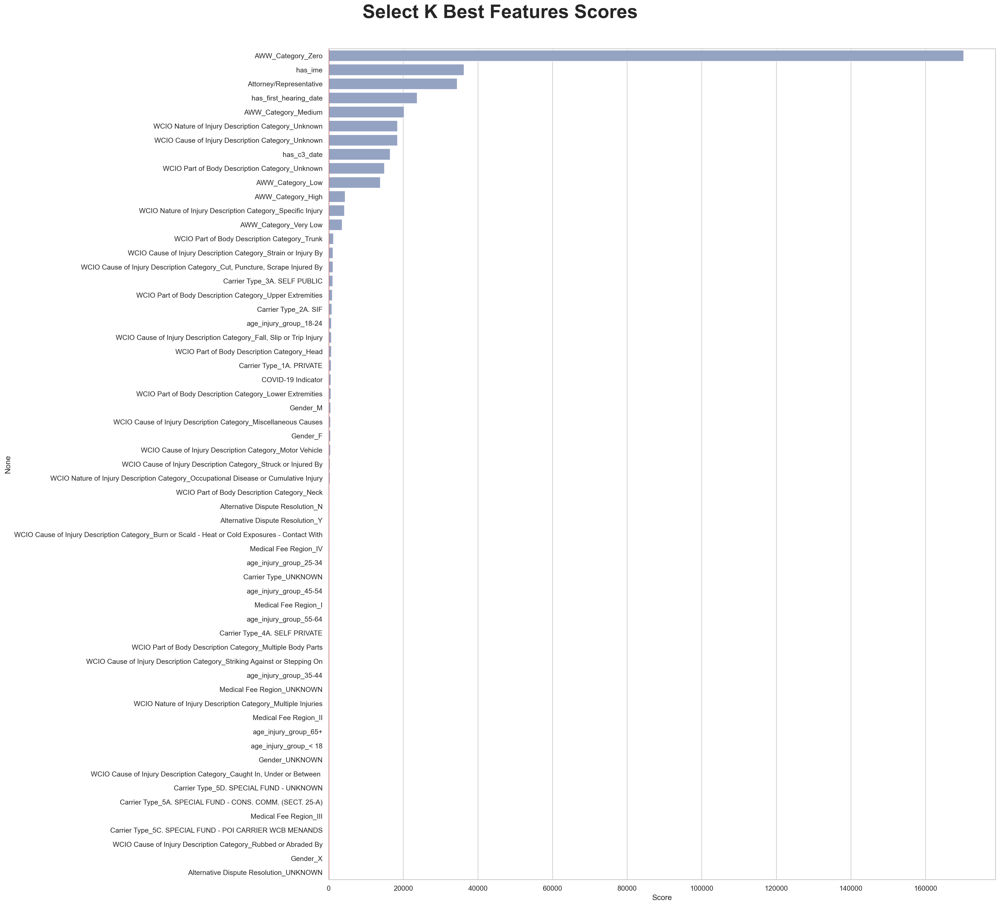

In [57]:
sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
#plt.savefig('Figures/SelectKBest_BarChart.png', dpi=600, bbox_inches='tight')
plt.show()

In [58]:
kbest_features_bool=[]
for elem in kbest_features["Score"]:
    if elem > 80:  #limit of 80: seems reasonable given the x range and distribution
        kbest_features_bool.append(True)
    else:
        kbest_features_bool.append(False)

In [59]:
k_features = pd.Series(kbest_features_bool, index = kbest_features.index).reindex(X_train_cat.columns)

In [60]:
k_features

Attorney/Representative                                                                             True
has_c3_date                                                                                         True
COVID-19 Indicator                                                                                  True
has_first_hearing_date                                                                              True
has_ime                                                                                             True
Alternative Dispute Resolution_N                                                                    True
Alternative Dispute Resolution_UNKNOWN                                                             False
Alternative Dispute Resolution_Y                                                                    True
Carrier Type_1A. PRIVATE                                                                            True
Carrier Type_2A. SIF                                   

## Wrapper Methods

### RFECV - Using Logistic Regression as the base estimator

In [63]:
#Setting Logistic regression as the base estimator
model = LogisticRegression()

In [64]:
rfe = RFE(estimator = model, n_features_to_select = 11)
X_rfe = rfe.fit_transform(X = X_train_num, y = target_train)

In [66]:
rfe.support_

array([ True,  True,  True, False,  True,  True,  True, False, False,
        True,  True,  True, False,  True,  True, False])

In [67]:
selected_features = pd.Series(rfe.support_, index = X_train_num.columns)
selected_features

Age at Injury                              True
Average Weekly Wage                        True
Birth Year                                 True
Number of Dependents                      False
Diff_days_assembly_accident                True
Average Weekly Wage log                    True
Carrier Name_Frqc                          True
County of Injury_Frqc                     False
District Name_Frqc                        False
Industry Code Description_Frqc             True
WCIO Part Of Body Description_Frqc         True
WCIO Nature of Injury Description_Frqc     True
WCIO Cause of Injury Description_Frqc     False
AWW_Category_Frqc                          True
age_injury_group_Frqc                      True
Classification_Zip_Code_Frqc              False
dtype: bool

### Random Forest

**Random Forest- Numerical Variables**

In [70]:
embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=110))
embeded_rf_selector.fit(X_train_num,target_train)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X_train_num.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features:')
for feature in embeded_rf_feature:
    print(feature)


5 selected features:
Average Weekly Wage
Diff_days_assembly_accident
Average Weekly Wage log
Carrier Name_Frqc
AWW_Category_Frqc


In [361]:
embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=110))
embeded_rf_selector.fit(X_train_num.drop(columns=['Average Weekly Wage log', 'AWW_Category_Frqc']),target_train)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = (X_train_num.drop(columns=['Average Weekly Wage log', 'AWW_Category_Frqc'])).loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features:')
for feature in embeded_rf_feature:
    print(feature)

2 selected features:
Average Weekly Wage
Diff_days_assembly_accident


**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [72]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train)
importances = rf.feature_importances_

In [403]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
51,AWW_Category_Zero,0.234757
0,Attorney/Representative,0.083740
4,has_ime,0.066918
49,AWW_Category_Medium,0.063101
3,has_first_hearing_date,0.062413
48,AWW_Category_Low,0.057817
1,has_c3_date,0.046807
50,AWW_Category_Very Low,0.020002
47,AWW_Category_High,0.015956
55,age_injury_group_45-54,0.014793


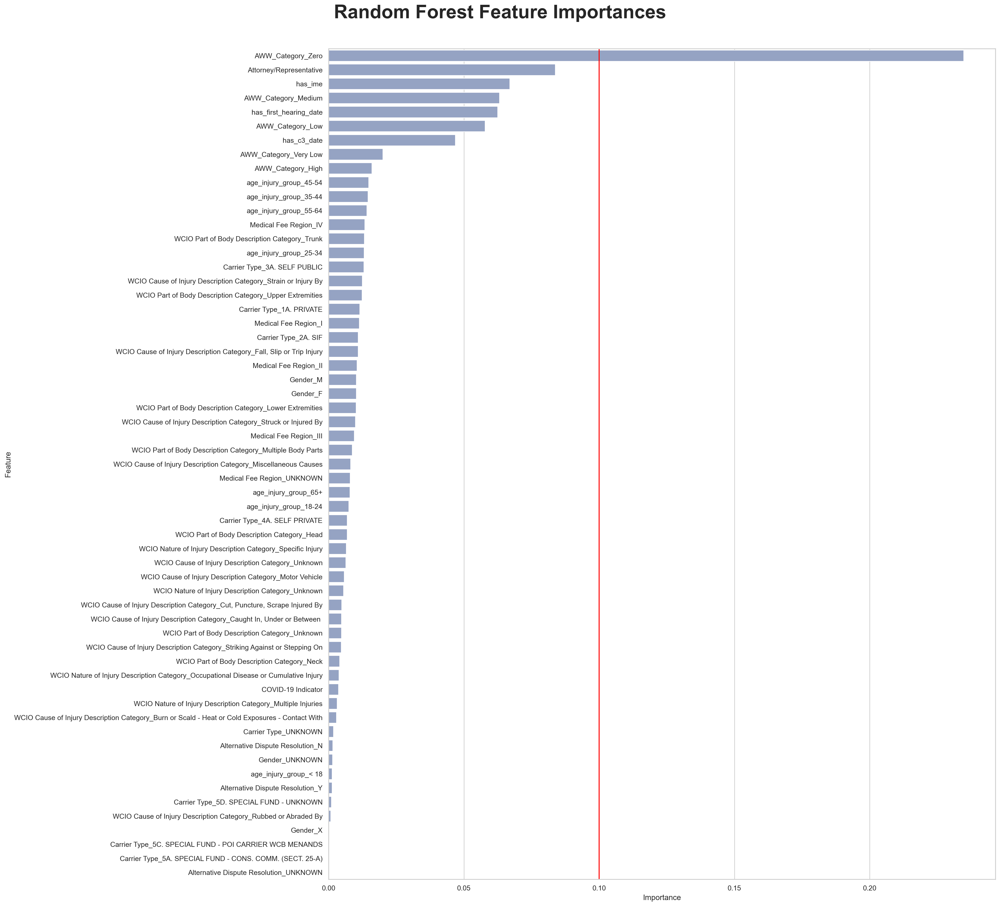

In [74]:
sns.set(font_scale=1)
sns.set_style("whitegrid")

plt.figure(figsize=(23, 20), dpi=200)
sns.barplot(data=feature_importance_df, y='Feature', x='Importance', color=sns.color_palette("Set2")[2], orient="h")

plt.axvline(x=0.1, color='red')  
plt.tight_layout(pad=4)

plt.suptitle("Random Forest Feature Importances", fontweight="bold", fontsize=30, y=1.015)

plt.show()

## Embedded Methods

### Lasso Regression

In [77]:
def plot_importance(coef,name):
    imp_coef = coef.sort_values()
    plt.figure(figsize=(8,10))
    imp_coef.plot(kind = "barh")
    plt.title("Feature importance using " + name + " Model")
    plt.show()

In [78]:
reg = LassoCV()

In [79]:
reg.fit(X_train_num, target_train)

LassoCV()

In [367]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 14 variables and eliminated the other 2 variables


Average Weekly Wage                      -0.360550
Birth Year                               -0.218081
AWW_Category_Frqc                        -0.126593
District Name_Frqc                       -0.047680
Classification_Zip_Code_Frqc             -0.014964
Number of Dependents                     -0.000461
Age at Injury                            -0.000000
WCIO Cause of Injury Description_Frqc     0.000000
age_injury_group_Frqc                     0.000850
Carrier Name_Frqc                         0.016834
Industry Code Description_Frqc            0.034746
County of Injury_Frqc                     0.040934
WCIO Part Of Body Description_Frqc        0.058960
WCIO Nature of Injury Description_Frqc    0.084541
Diff_days_assembly_accident               1.255773
Average Weekly Wage log                   2.326468
dtype: float64

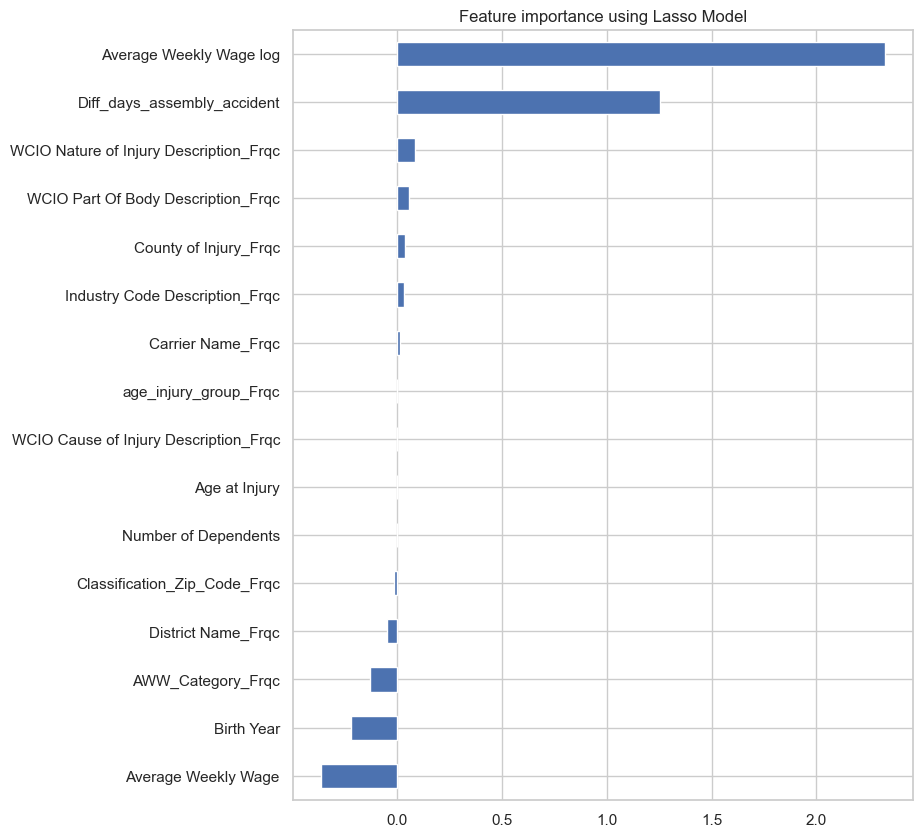

In [82]:
plot_importance(coef,'Lasso') 

According to Lasso, we should keep the following features:
- Average Weekly Wage Log
- WCIO Nature of Injury Description_Fqrc
- WCIO Part of Body Description_Frqc
- Average Weekly Wage
- County of Injury_Frqc
- Industry Code Description_Frqc
- Carrier Name_Frqc
- District Name_Frqc
- Assembly Year
- Birth Year
- AWW_Category_Frqc


### Ridge Regression

In [85]:
#Initializing the instance
ridge = RidgeCV()

In [86]:
ridge.fit(X_train_num, target_train)

RidgeCV()

In [87]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Birth Year                               -5.085115
Age at Injury                            -3.591502
Diff_days_assembly_accident              -0.729686
Average Weekly Wage                      -0.477226
AWW_Category_Frqc                        -0.055426
District Name_Frqc                       -0.050732
Classification_Zip_Code_Frqc             -0.020560
Number of Dependents                     -0.003883
WCIO Cause of Injury Description_Frqc     0.001142
age_injury_group_Frqc                     0.003407
Carrier Name_Frqc                         0.016515
Industry Code Description_Frqc            0.034232
County of Injury_Frqc                     0.046925
WCIO Part Of Body Description_Frqc        0.072140
WCIO Nature of Injury Description_Frqc    0.087717
Average Weekly Wage log                   2.439003
dtype: float64

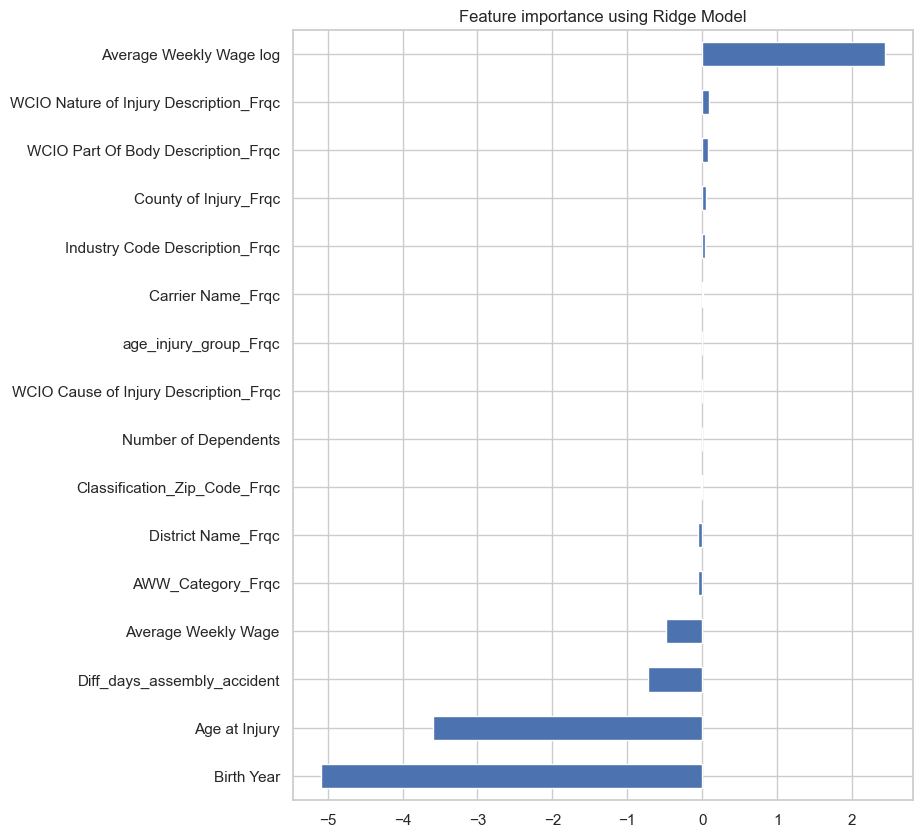

In [88]:
plot_importance(coef_ridge,'Ridge')

Considered threshould = 

According to Ridge, we should keep the following features:
- Average Weekly Wage Log
- WCIO Nature of Injury Description_Fqrc
- WCIO Part of Body Description_Frqc
- Average Weekly Wage
- County of Injury_Frqc
- Industry Code Description_Frqc
- District Name_Frqc
- Birth Year
- AWW_Category_Frqc
- Diff_days_assembly_accident 

## Use a decision tree to evaluate feature importance -- practical class

In [91]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train).feature_importances_

<Axes: xlabel='Value', ylabel='Col'>

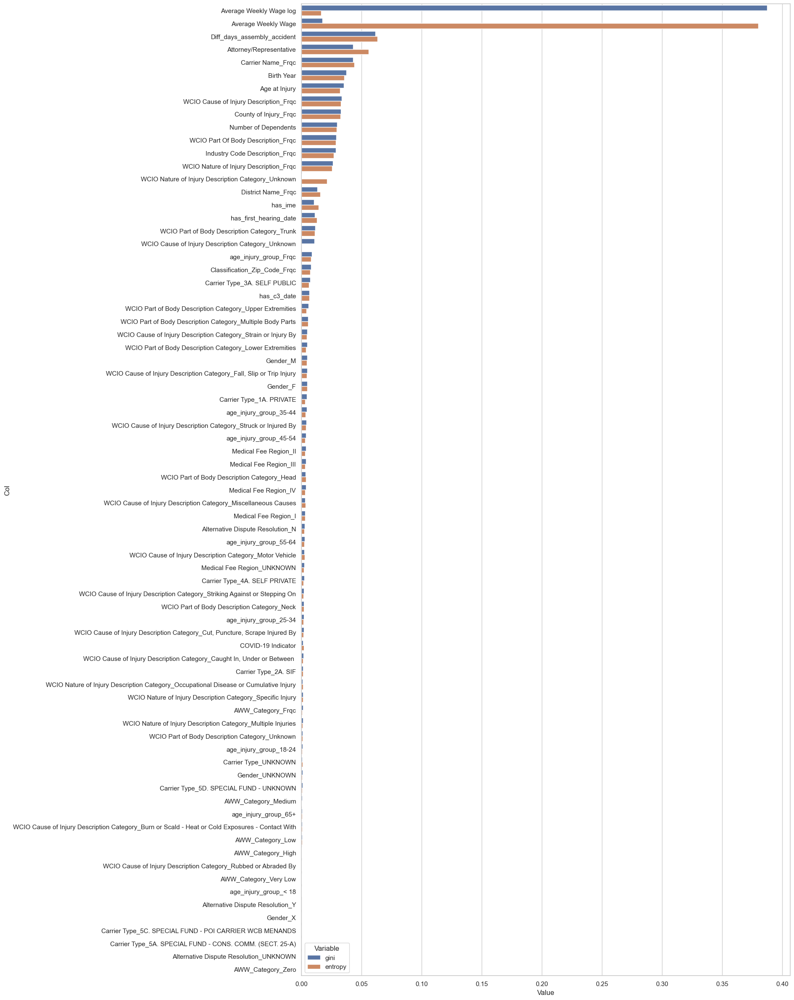

In [92]:
zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

## Class specific analysis - Open-ended section

In [38]:
for target_class in df_target_train['Claim Injury Type'].unique():

    binary_target = (df_target_train['Claim Injury Type'] == target_class).astype(int)
    
    mi_scores = mutual_info_classif(X_train_cat, binary_target)
    
    mi_df = pd.DataFrame({
        'Feature': X_train_cat.columns,
        'MI Score': mi_scores
    })
    
    mi_df = mi_df.sort_values(by='MI Score', ascending=False)
    
    print(f"MI scores for class \033[1;35m{target_class}\033[1;0m:")
    print(mi_df) 
    print("\n")


MI scores for class 1:
                                              Feature  MI Score
51                                  AWW_Category_Zero  0.420100
0                             Attorney/Representative  0.176831
4                                             has_ime  0.167600
3                              has_first_hearing_date  0.152627
49                                AWW_Category_Medium  0.126050
1                                         has_c3_date  0.112329
48                                   AWW_Category_Low  0.097635
17                                           Gender_M  0.041467
5                    Alternative Dispute Resolution_N  0.038491
34  WCIO Nature of Injury Description Category_Spe...  0.038355
8                            Carrier Type_1A. PRIVATE  0.037869
47                                  AWW_Category_High  0.032825
50                              AWW_Category_Very Low  0.031669
23                              Medical Fee Region_IV  0.029213
16               

In [506]:
df_target_train0 = (df_target_train == 0).astype(int)
df_target_train1 = (df_target_train == 1).astype(int)
df_target_train2 = (df_target_train == 2).astype(int)
df_target_train3 = (df_target_train == 3).astype(int)
df_target_train4 = (df_target_train == 4).astype(int)
df_target_train5 = (df_target_train == 5).astype(int)
df_target_train6 = (df_target_train == 6).astype(int)
df_target_train7 = (df_target_train == 7).astype(int)

target_train0 = df_target_train0['Claim Injury Type'].to_numpy()
target_train1 = df_target_train1['Claim Injury Type'].to_numpy()
target_train2 = df_target_train2['Claim Injury Type'].to_numpy()
target_train3 = df_target_train3['Claim Injury Type'].to_numpy()
target_train4 = df_target_train4['Claim Injury Type'].to_numpy()
target_train5 = df_target_train5['Claim Injury Type'].to_numpy()
target_train6 = df_target_train6['Claim Injury Type'].to_numpy()
target_train7 = df_target_train7['Claim Injury Type'].to_numpy()

### Class 0

**Pearson correlation matrix**

<Axes: >

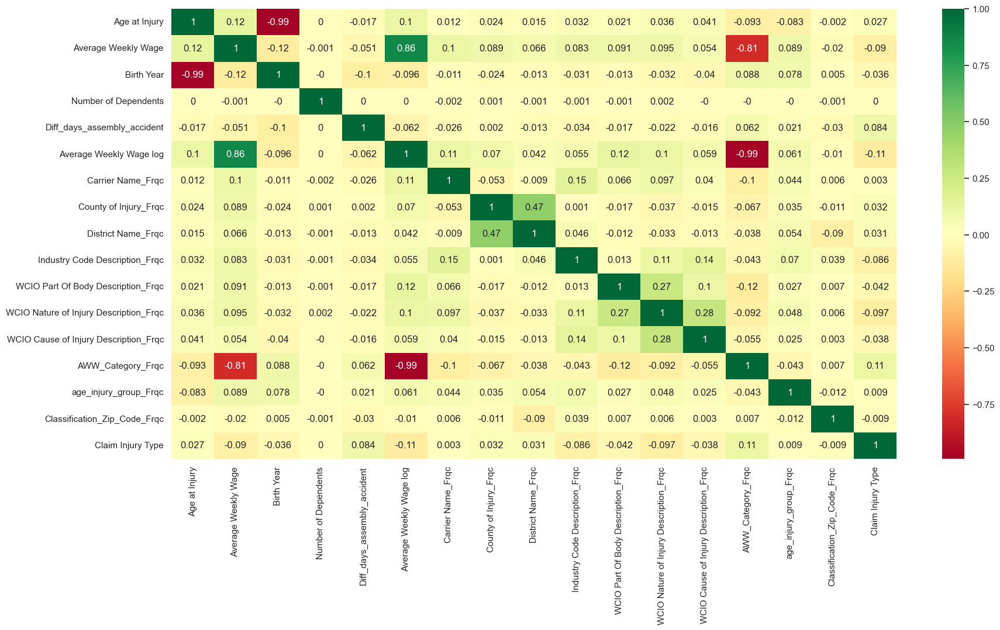

In [509]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train0], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [565]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train0], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,WCIO Part of Body Description Category_Unknown,WCIO Nature of Injury Description Category_Specific Injury,AWW_Category_Zero,has_ime,AWW_Category_Medium,WCIO Part of Body Description Category_Upper Extremities,AWW_Category_Low,WCIO Cause of Injury Description Category_Struck or Injured By,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Part of Body Description Category_Lower Extremities,has_c3_date,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",WCIO Cause of Injury Description Category_Strain or Injury By,Carrier Type_UNKNOWN,WCIO Part of Body Description Category_Trunk,AWW_Category_High,WCIO Part of Body Description Category_Head,AWW_Category_Very Low,has_first_hearing_date,Medical Fee Region_IV,Attorney/Representative,Medical Fee Region_I,Gender_F,WCIO Cause of Injury Description Category_Striking Against or Stepping On,age_injury_group_18-24,Gender_M,age_injury_group_35-44,"WCIO Cause of Injury Description Category_Caught In, Under or Between",age_injury_group_25-34,WCIO Part of Body Description Category_Multiple Body Parts,Medical Fee Region_II,WCIO Cause of Injury Description Category_Motor Vehicle,Medical Fee Region_UNKNOWN,Carrier Type_4A. SELF PRIVATE,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,COVID-19 Indicator,age_injury_group_55-64,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),WCIO Part of Body Description Category_Neck,Gender_UNKNOWN,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_1A. PRIVATE,Carrier Type_3A. SELF PUBLIC,age_injury_group_45-54,WCIO Cause of Injury Description Category_Miscellaneous Causes,age_injury_group_65+,age_injury_group_< 18,Carrier Type_2A. SIF,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_III,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Nature of Injury Description Category_Multiple Injuries,Gender_X,Alternative Dispute Resolution_UNKNOWN
Claim Injury Type,1.0,0.486949,0.486897,0.448921,0.244745,0.110787,0.071644,0.062285,0.059596,0.054622,0.052893,0.050328,0.047611,0.038626,0.03561,0.03418,0.03286,0.03232,0.032117,0.0307,0.030628,0.02893,0.027052,0.026818,0.026145,0.023079,0.023021,0.022769,0.021634,0.020101,0.019915,0.019467,0.018361,0.018109,0.01701,0.015862,0.015172,0.014553,0.011743,0.010658,0.008971,0.007612,0.007508,0.007396,0.007385,0.005975,0.005461,0.004582,0.004551,0.004396,0.004321,0.003878,0.003507,0.003496,0.002718,0.001095,0.000575,0.000315,0.000093,0.0


**Select K-Best: Numerical Variables**

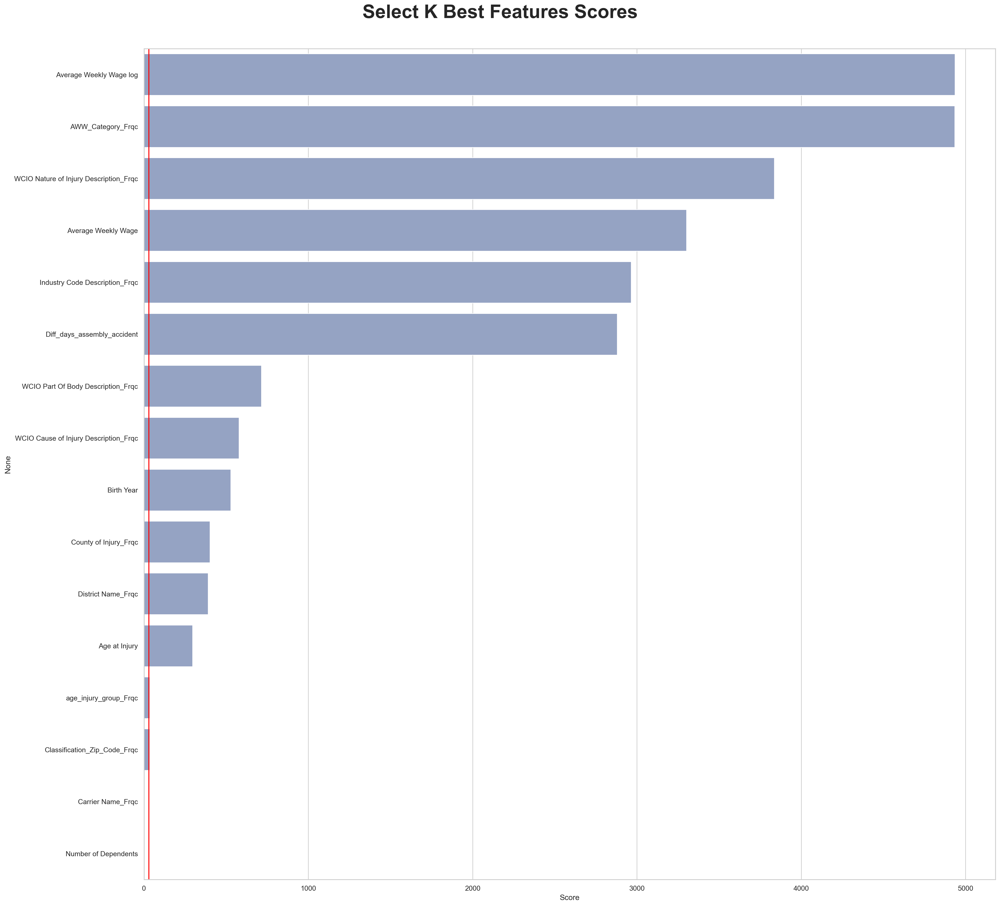

In [664]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train0)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

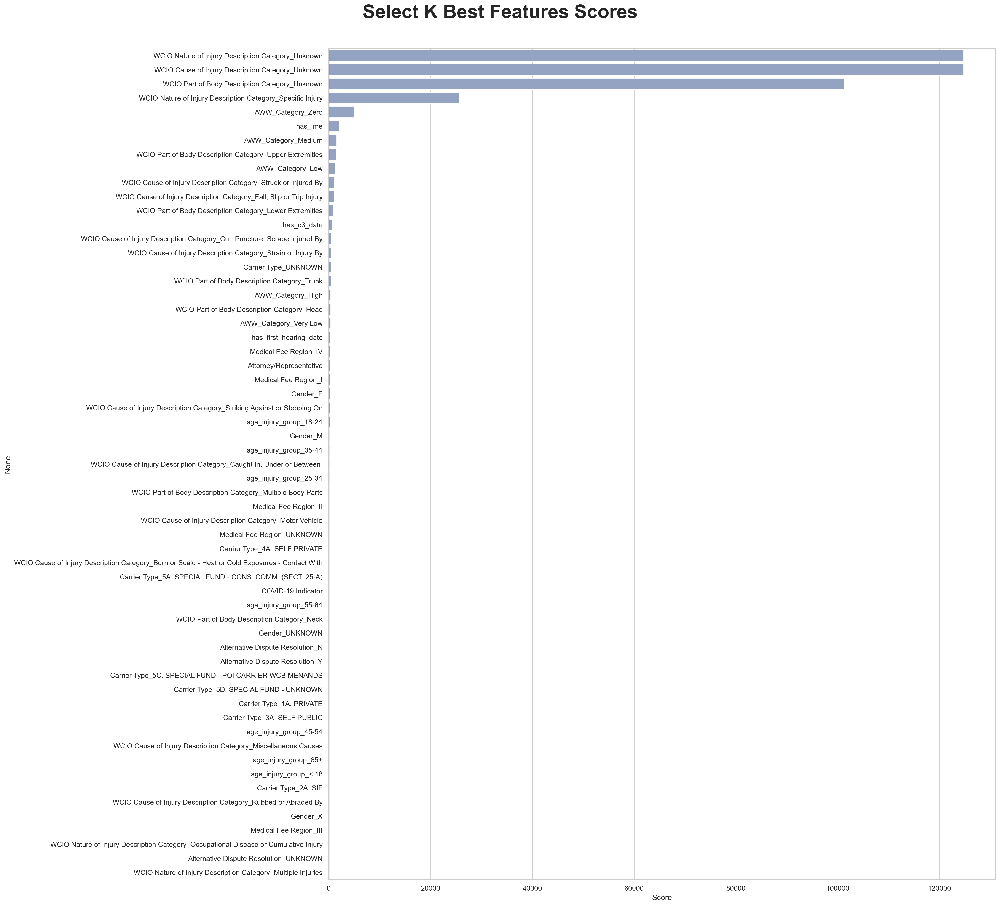

In [596]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train0)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [639]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train0)
importances = rf.feature_importances_

In [640]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
35,WCIO Nature of Injury Description Category_Unk...,0.129132
46,WCIO Cause of Injury Description Category_Unknown,0.108915
30,WCIO Part of Body Description Category_Unknown,0.097490
1,has_c3_date,0.040376
0,Attorney/Representative,0.033714
34,WCIO Nature of Injury Description Category_Spe...,0.032455
3,has_first_hearing_date,0.030261
7,Alternative Dispute Resolution_Y,0.028988
8,Carrier Type_1A. PRIVATE,0.027574
9,Carrier Type_2A. SIF,0.026976


**Lasso Regression**

In [649]:
reg = LassoCV()
reg.fit(X_train_num, target_train0)

LassoCV()

In [650]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 15 variables and eliminated the other 1 variables


Industry Code Description_Frqc           -0.035484
WCIO Nature of Injury Description_Frqc   -0.030994
Average Weekly Wage log                  -0.021102
WCIO Part Of Body Description_Frqc       -0.004500
Classification_Zip_Code_Frqc             -0.000865
Birth Year                               -0.000000
Number of Dependents                      0.000009
WCIO Cause of Injury Description_Frqc     0.000024
Average Weekly Wage                       0.006058
District Name_Frqc                        0.008609
County of Injury_Frqc                     0.010154
Carrier Name_Frqc                         0.013729
age_injury_group_Frqc                     0.014545
AWW_Category_Frqc                         0.018471
Age at Injury                             0.040927
Diff_days_assembly_accident               0.402308
dtype: float64

**Ridge Regression**

In [654]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train0)

RidgeCV()

In [655]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Industry Code Description_Frqc           -0.035456
WCIO Nature of Injury Description_Frqc   -0.031087
Average Weekly Wage log                  -0.022612
WCIO Part Of Body Description_Frqc       -0.004749
Classification_Zip_Code_Frqc             -0.000857
Number of Dependents                      0.000068
WCIO Cause of Injury Description_Frqc     0.000199
Average Weekly Wage                       0.007699
District Name_Frqc                        0.008609
County of Injury_Frqc                     0.010188
Carrier Name_Frqc                         0.013861
age_injury_group_Frqc                     0.014722
AWW_Category_Frqc                         0.017484
Birth Year                                0.094617
Age at Injury                             0.110945
Diff_days_assembly_accident               0.461506
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

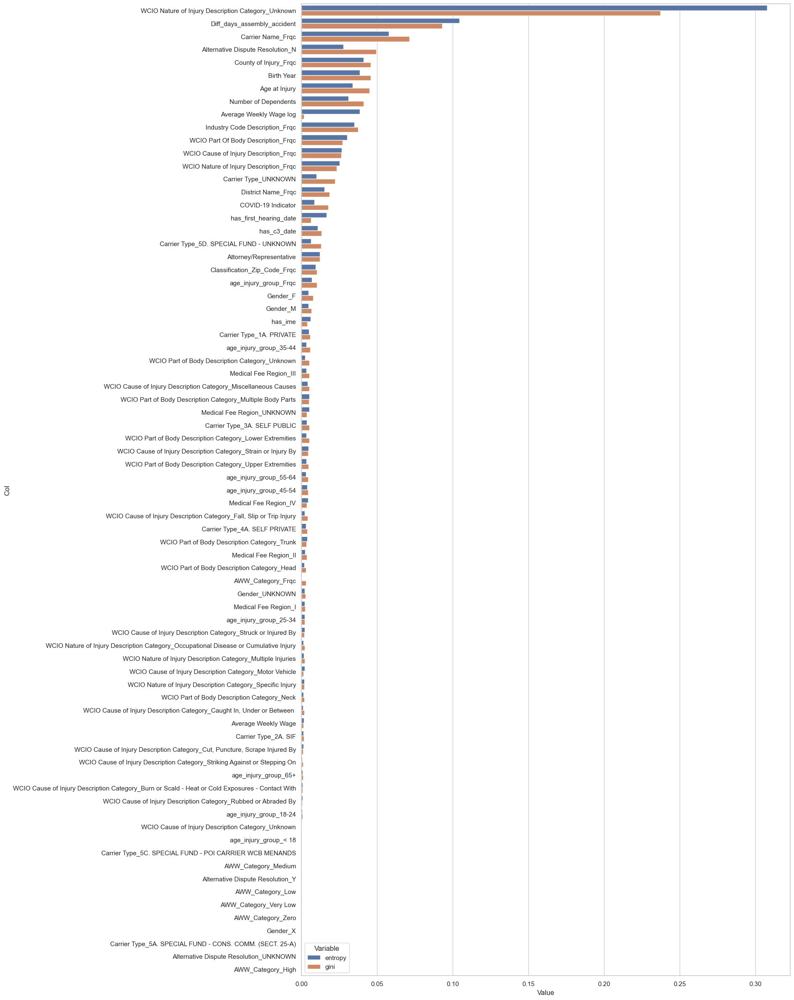

In [920]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train0).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 0

***Best Categorical:*** 'WCIO Nature of Injury Description Category_Specific Injury', 'WCIO Nature of Injury Description Category_Unknown'<br>
***Best Numerical:*** 'Average Weekly Wage log', 'Diff_days_assembly_accident'<br>

***Worst Categorical:*** 'age_injury_group_< 18', 'WCIO Nature of Injury Description Category_Multiple Injuries', 'Alternative Dispute Resolution_UNKNOWN' <br>
***Worst Numerical:*** 'Birth Year', 'Number of Dependents' <br>

### Class 1

**Pearson correlation matrix**

<Axes: >

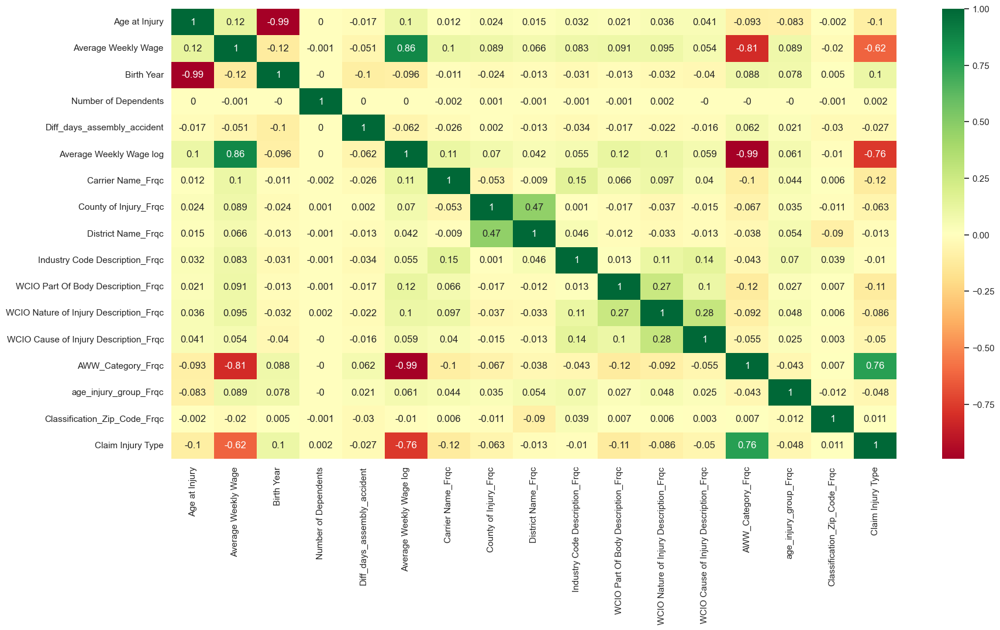

In [675]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train1], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [679]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train1], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,AWW_Category_Zero,Attorney/Representative,has_ime,has_first_hearing_date,AWW_Category_Medium,has_c3_date,AWW_Category_Low,AWW_Category_High,AWW_Category_Very Low,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Carrier Type_2A. SIF,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Part of Body Description Category_Head,age_injury_group_18-24,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Miscellaneous Causes,Gender_M,Carrier Type_1A. PRIVATE,COVID-19 Indicator,Gender_F,WCIO Cause of Injury Description Category_Motor Vehicle,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,WCIO Cause of Injury Description Category_Struck or Injured By,WCIO Part of Body Description Category_Lower Extremities,age_injury_group_25-34,age_injury_group_45-54,Medical Fee Region_IV,Carrier Type_4A. SELF PRIVATE,age_injury_group_55-64,WCIO Nature of Injury Description Category_Specific Injury,Carrier Type_UNKNOWN,Medical Fee Region_I,WCIO Cause of Injury Description Category_Striking Against or Stepping On,WCIO Part of Body Description Category_Neck,age_injury_group_35-44,WCIO Part of Body Description Category_Multiple Body Parts,Gender_UNKNOWN,WCIO Part of Body Description Category_Upper Extremities,WCIO Nature of Injury Description Category_Multiple Injuries,Medical Fee Region_II,Carrier Type_3A. SELF PUBLIC,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Trunk,age_injury_group_65+,age_injury_group_< 18,Carrier Type_5D. SPECIAL FUND - UNKNOWN,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,Medical Fee Region_III,WCIO Part of Body Description Category_Unknown,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Alternative Dispute Resolution_UNKNOWN,Gender_X,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Rubbed or Abraded By
Claim Injury Type,1.0,0.764936,0.532761,0.511524,0.493203,0.428695,0.42172,0.37962,0.218487,0.214007,0.132957,0.113519,0.110431,0.098334,0.097496,0.088344,0.083394,0.080131,0.078782,0.077131,0.075572,0.070505,0.065767,0.065712,0.060011,0.058282,0.055847,0.05418,0.049357,0.048756,0.042184,0.041066,0.040118,0.038923,0.038859,0.037045,0.033918,0.030729,0.029363,0.027747,0.026225,0.024618,0.02362,0.02085,0.020255,0.015148,0.012665,0.012223,0.009263,0.006924,0.005529,0.005458,0.004958,0.002938,0.001864,0.001783,0.00138,0.00115,0.000827,0.00035


**Select K-Best: Numerical Variables**

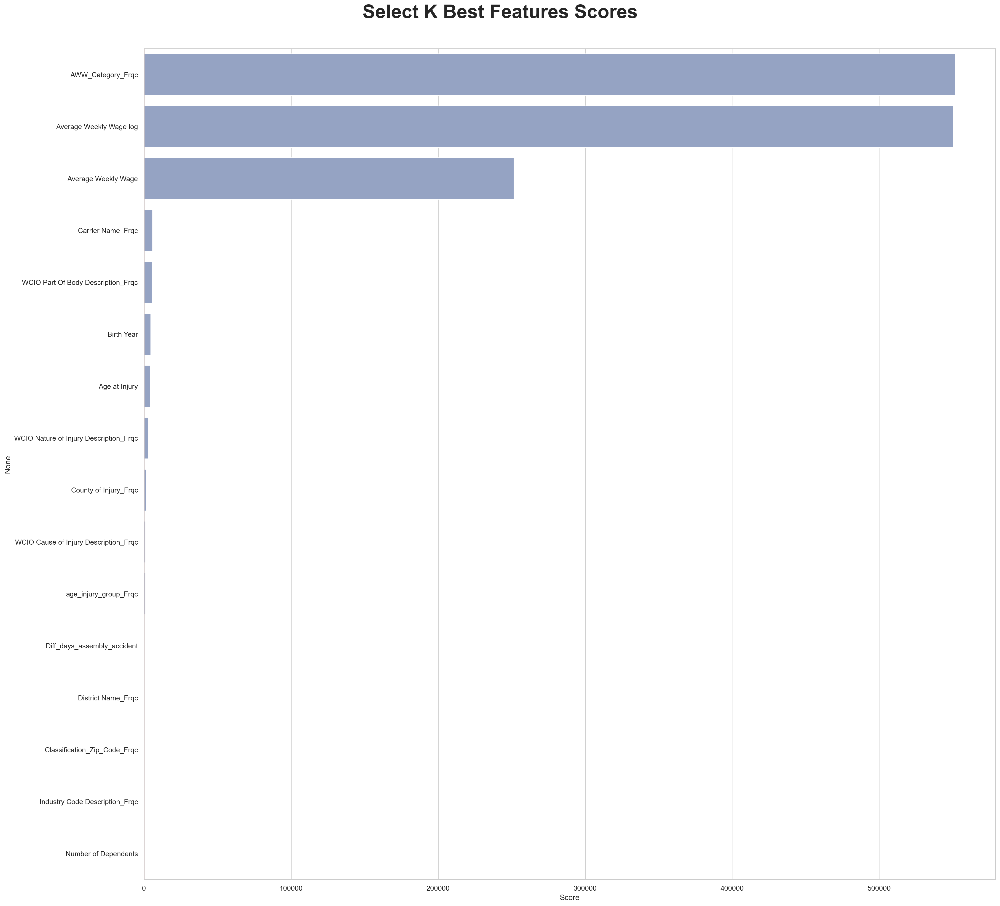

In [681]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train1)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

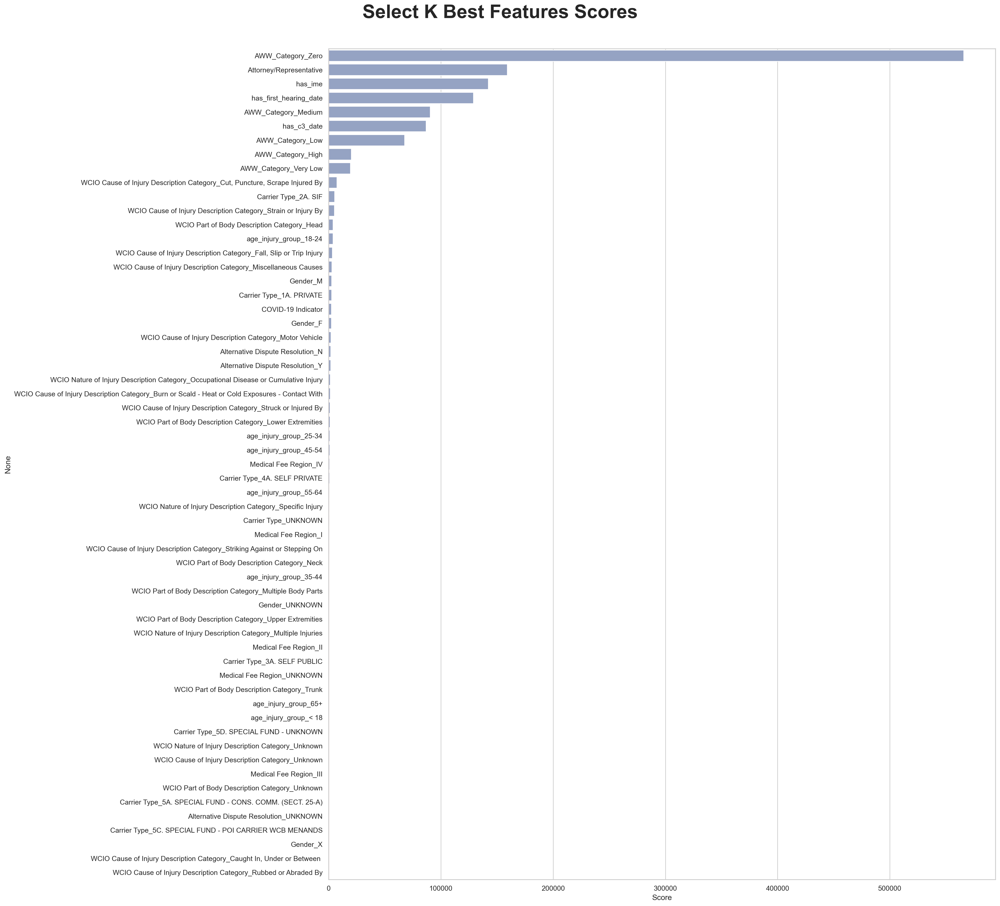

In [684]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train1)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [686]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train1)
importances = rf.feature_importances_

In [687]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
51,AWW_Category_Zero,0.331245
0,Attorney/Representative,0.110542
4,has_ime,0.088363
49,AWW_Category_Medium,0.082689
3,has_first_hearing_date,0.077251
48,AWW_Category_Low,0.065443
1,has_c3_date,0.046575
50,AWW_Category_Very Low,0.022784
47,AWW_Category_High,0.018722
9,Carrier Type_2A. SIF,0.006678


**Lasso Regression**

In [689]:
reg = LassoCV()
reg.fit(X_train_num, target_train1)

LassoCV()

In [690]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 15 variables and eliminated the other 1 variables


Diff_days_assembly_accident              -1.116927
Average Weekly Wage log                  -0.721790
Carrier Name_Frqc                        -0.052269
County of Injury_Frqc                    -0.036767
WCIO Part Of Body Description_Frqc       -0.034682
age_injury_group_Frqc                    -0.022165
WCIO Cause of Injury Description_Frqc    -0.006669
WCIO Nature of Injury Description_Frqc   -0.006630
Age at Injury                            -0.000000
Number of Dependents                      0.001896
Classification_Zip_Code_Frqc              0.005160
District Name_Frqc                        0.029478
Industry Code Description_Frqc            0.045707
Birth Year                                0.129268
AWW_Category_Frqc                         0.315681
Average Weekly Wage                       0.318981
dtype: float64

**Ridge Regression**

In [692]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train1)

RidgeCV()

In [693]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Diff_days_assembly_accident              -1.355882
Average Weekly Wage log                  -0.763276
Carrier Name_Frqc                        -0.053536
County of Injury_Frqc                    -0.039337
WCIO Part Of Body Description_Frqc       -0.035757
age_injury_group_Frqc                    -0.025425
Age at Injury                            -0.015786
WCIO Cause of Injury Description_Frqc    -0.008545
WCIO Nature of Injury Description_Frqc   -0.007228
Number of Dependents                      0.003372
Classification_Zip_Code_Frqc              0.006480
District Name_Frqc                        0.031038
Industry Code Description_Frqc            0.046847
Birth Year                                0.116026
AWW_Category_Frqc                         0.292806
Average Weekly Wage                       0.368638
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

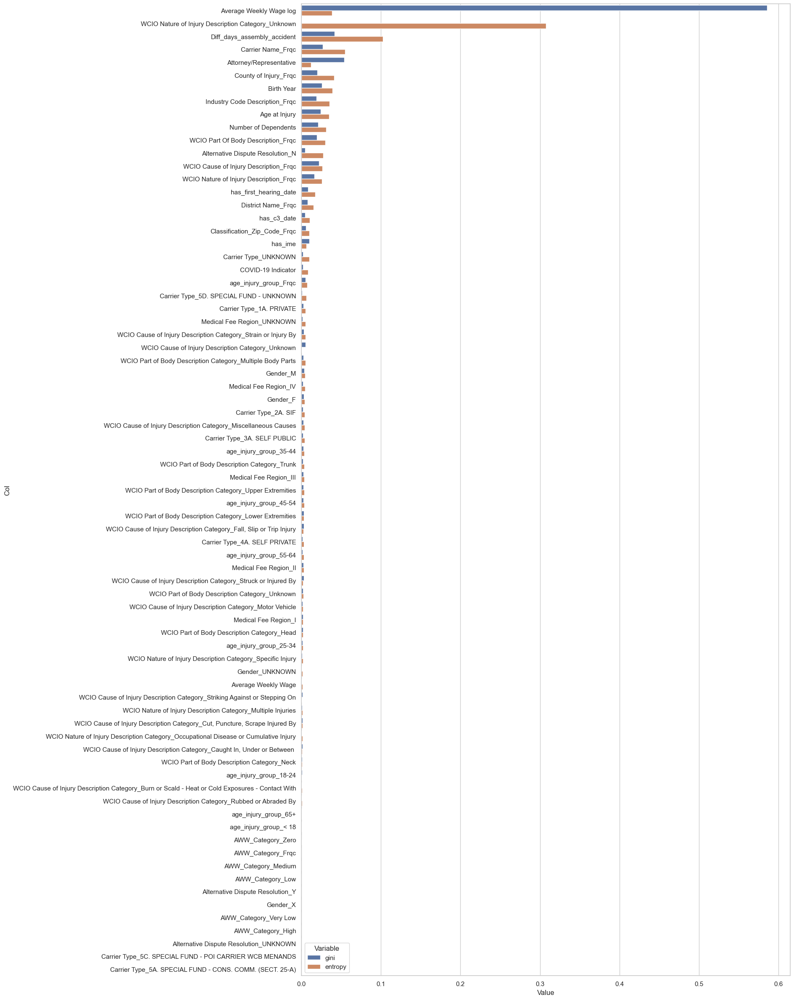

In [922]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train1).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 1

***Best Categorical:*** 'AWW_Category_Zero' <br>
***Best Numerical:*** 'Average Weekly Wage log', 'AWW_Category_Frqc', 'Diff_days_assembly_accident'<br>

***Worst Categorical:*** 'WCIO Cause of Injury Description Category_Rubbed or Abraded By', 'Alternative Dispute Resolution_UNKNOWN', 'Gender_F'  <br>
***Worst Numerical:*** 'Number of Dependents', 'Industry Code Description_Frqc', 'Age at Injury' <br>

### Class 2

**Pearson correlation matrix**

<Axes: >

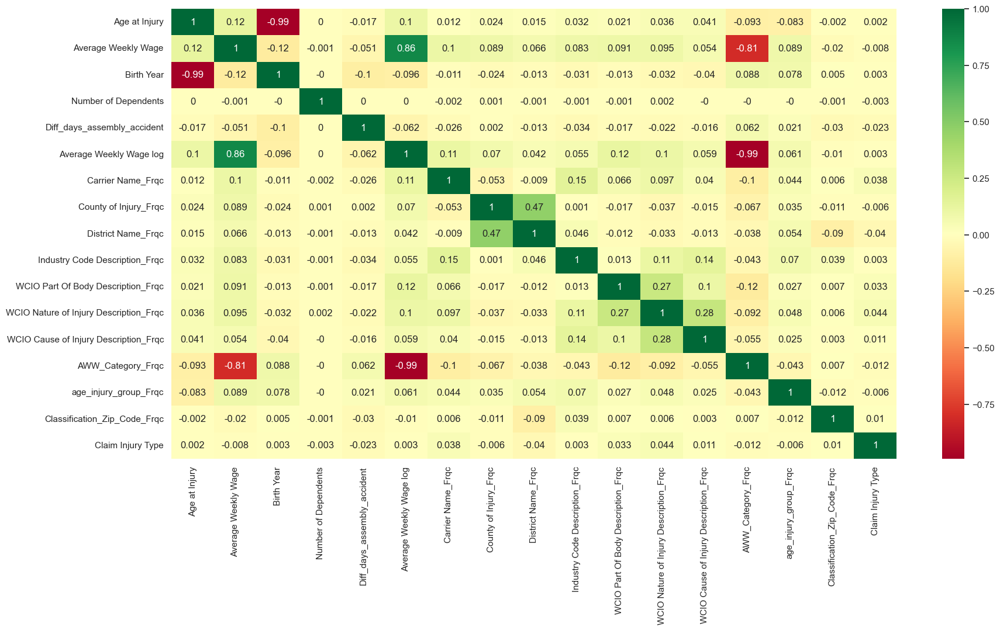

In [708]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train2], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [712]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train2], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,WCIO Cause of Injury Description Category_Unknown,WCIO Nature of Injury Description Category_Unknown,WCIO Part of Body Description Category_Unknown,has_first_hearing_date,WCIO Nature of Injury Description Category_Specific Injury,AWW_Category_Very Low,WCIO Cause of Injury Description Category_Motor Vehicle,Carrier Type_2A. SIF,WCIO Cause of Injury Description Category_Miscellaneous Causes,Carrier Type_1A. PRIVATE,has_ime,COVID-19 Indicator,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,age_injury_group_< 18,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Part of Body Description Category_Multiple Body Parts,AWW_Category_Medium,Carrier Type_UNKNOWN,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Upper Extremities,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Carrier Type_3A. SELF PUBLIC,Medical Fee Region_I,has_c3_date,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Cause of Injury Description Category_Struck or Injured By,WCIO Part of Body Description Category_Trunk,Medical Fee Region_IV,Carrier Type_4A. SELF PRIVATE,AWW_Category_Zero,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Lower Extremities,WCIO Part of Body Description Category_Head,Gender_UNKNOWN,Medical Fee Region_III,WCIO Nature of Injury Description Category_Multiple Injuries,age_injury_group_25-34,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,AWW_Category_Low,age_injury_group_55-64,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Gender_X,"WCIO Cause of Injury Description Category_Caught In, Under or Between",Medical Fee Region_II,Attorney/Representative,age_injury_group_35-44,Gender_F,age_injury_group_18-24,Gender_M,age_injury_group_65+,age_injury_group_45-54,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),AWW_Category_High,WCIO Cause of Injury Description Category_Striking Against or Stepping On,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Alternative Dispute Resolution_UNKNOWN
Claim Injury Type,1.0,0.057637,0.057624,0.052322,0.050227,0.047305,0.04635,0.040529,0.040314,0.036807,0.03673,0.028361,0.026899,0.026754,0.024879,0.024858,0.023081,0.02061,0.019992,0.01932,0.019226,0.019124,0.016407,0.015894,0.014777,0.014338,0.013436,0.013202,0.009497,0.009254,0.008242,0.008156,0.007976,0.007484,0.006611,0.006561,0.006531,0.005623,0.005616,0.004823,0.004705,0.004427,0.004403,0.004001,0.003403,0.002748,0.002426,0.002317,0.002222,0.001727,0.001062,0.000579,0.000569,0.000552,0.000393,0.000388,0.00025,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

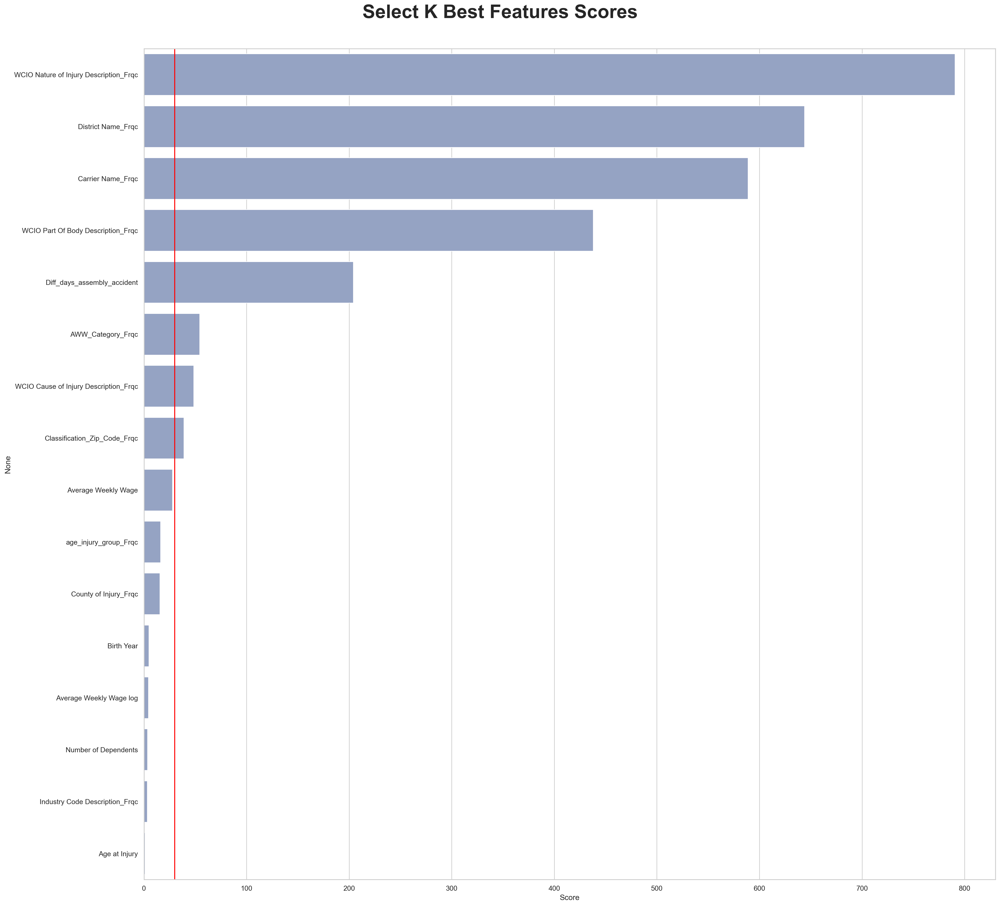

In [714]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train2)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

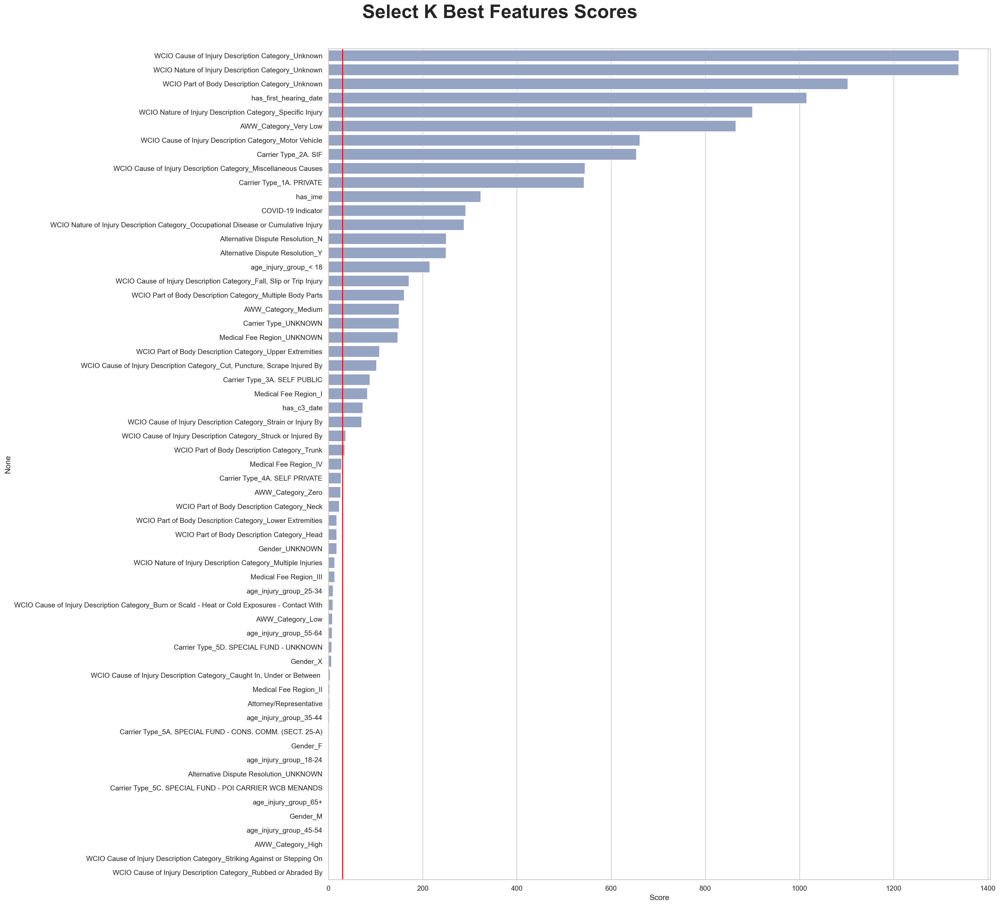

In [716]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train2)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [718]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train2)
importances = rf.feature_importances_

In [719]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,4.989787e-02
0,Attorney/Representative,4.828657e-02
4,has_ime,4.303571e-02
3,has_first_hearing_date,4.302197e-02
55,age_injury_group_45-54,3.637099e-02
54,age_injury_group_35-44,3.606869e-02
56,age_injury_group_55-64,3.480445e-02
53,age_injury_group_25-34,3.392881e-02
51,AWW_Category_Zero,3.221947e-02
23,Medical Fee Region_IV,2.880278e-02


**Lasso Regression**

In [721]:
reg = LassoCV()
reg.fit(X_train_num, target_train2)

LassoCV()

In [722]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 16 variables and eliminated the other 0 variables


Average Weekly Wage log                  -0.285484
AWW_Category_Frqc                        -0.258051
District Name_Frqc                       -0.037241
Number of Dependents                     -0.002848
age_injury_group_Frqc                    -0.002290
WCIO Cause of Injury Description_Frqc    -0.001909
Industry Code Description_Frqc           -0.000194
Classification_Zip_Code_Frqc              0.004499
County of Injury_Frqc                     0.018887
WCIO Part Of Body Description_Frqc        0.019381
Average Weekly Wage                       0.024573
WCIO Nature of Injury Description_Frqc    0.032451
Carrier Name_Frqc                         0.032652
Diff_days_assembly_accident               0.323314
Age at Injury                             0.833732
Birth Year                                1.126802
dtype: float64

**Ridge Regression**

In [724]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train2)

RidgeCV()

In [725]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Average Weekly Wage log                  -2.902856e-01
AWW_Category_Frqc                        -2.619532e-01
District Name_Frqc                       -3.733647e-02
Number of Dependents                     -2.901170e-03
age_injury_group_Frqc                    -2.232043e-03
WCIO Cause of Injury Description_Frqc    -1.901339e-03
Industry Code Description_Frqc            2.095208e-07
Classification_Zip_Code_Frqc              4.645787e-03
County of Injury_Frqc                     1.896619e-02
WCIO Part Of Body Description_Frqc        1.904331e-02
Average Weekly Wage                       2.709695e-02
WCIO Nature of Injury Description_Frqc    3.244280e-02
Carrier Name_Frqc                         3.282830e-02
Diff_days_assembly_accident               4.292695e-01
Age at Injury                             9.722042e-01
Birth Year                                1.314346e+00
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

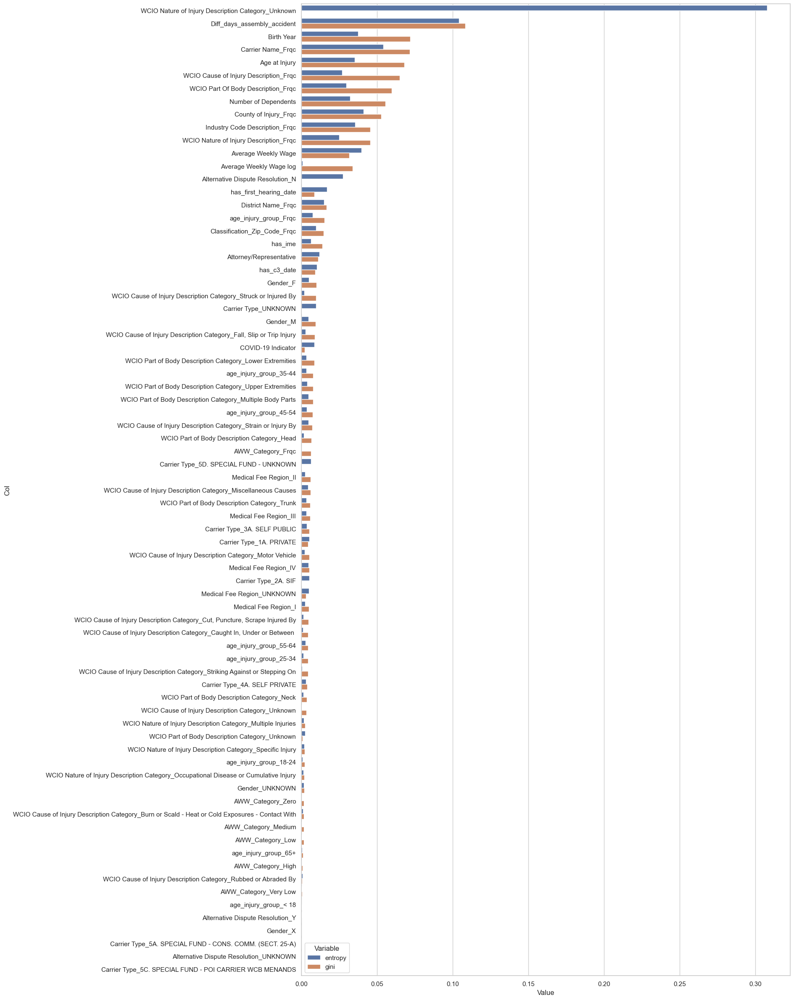

In [923]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train2).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 2

***Best Categorical:*** 'AWW_Category_Zero', 'WCIO Cause of Injury Description Category_Unknown', 'has_c3_date'<br>
***Best Numerical:*** 'WCIO Nature of Injury Description_Frqc', 'Birth Year'<br>

***Worst Categorical:*** 'Alternative Dispute Resolution_UNKNOWN' <br>
***Worst Numerical:*** 'Age at Injury', 'WCIO Cause of Injury Description Category_Rubbed or Abraded By' <br>

### Class 3

**Pearson correlation matrix**

<Axes: >

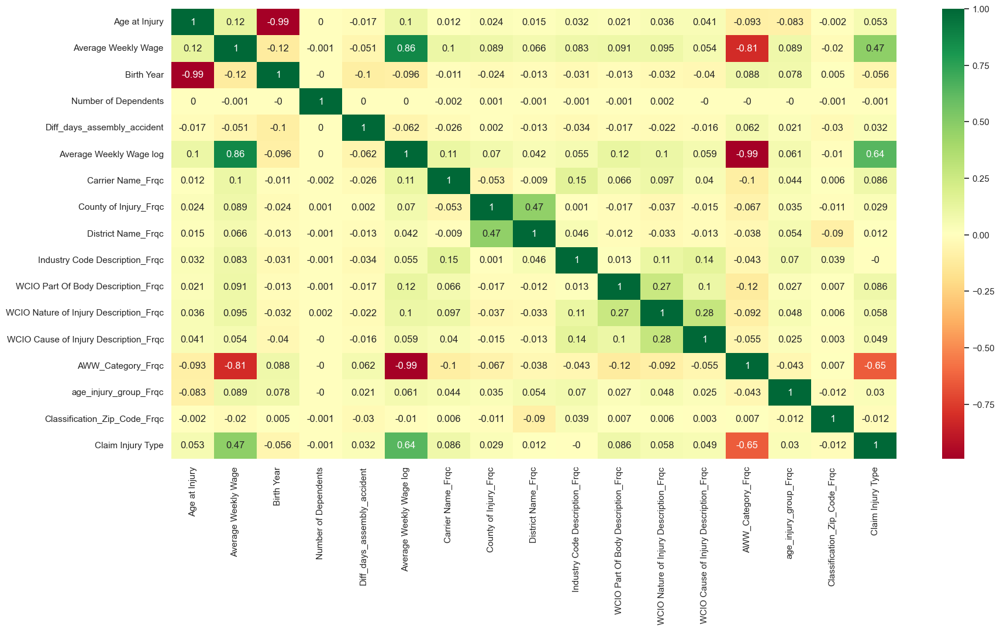

In [730]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train3], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [734]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train3], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,AWW_Category_Zero,AWW_Category_Low,has_ime,has_first_hearing_date,Attorney/Representative,AWW_Category_Medium,has_c3_date,AWW_Category_Very Low,AWW_Category_High,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,Carrier Type_2A. SIF,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Unknown,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Part of Body Description Category_Head,Carrier Type_3A. SELF PUBLIC,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Nature of Injury Description Category_Specific Injury,WCIO Part of Body Description Category_Upper Extremities,age_injury_group_18-24,WCIO Cause of Injury Description Category_Miscellaneous Causes,Gender_M,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,WCIO Part of Body Description Category_Neck,Gender_F,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,age_injury_group_45-54,WCIO Part of Body Description Category_Lower Extremities,WCIO Cause of Injury Description Category_Struck or Injured By,Carrier Type_UNKNOWN,WCIO Part of Body Description Category_Multiple Body Parts,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,age_injury_group_25-34,WCIO Nature of Injury Description Category_Multiple Injuries,Medical Fee Region_I,Medical Fee Region_UNKNOWN,COVID-19 Indicator,WCIO Cause of Injury Description Category_Striking Against or Stepping On,Gender_UNKNOWN,age_injury_group_35-44,Medical Fee Region_IV,age_injury_group_55-64,age_injury_group_< 18,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_4A. SELF PRIVATE,Medical Fee Region_III,Carrier Type_1A. PRIVATE,age_injury_group_65+,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_II,Gender_X,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Alternative Dispute Resolution_UNKNOWN,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS
Claim Injury Type,1.0,0.648965,0.390484,0.353314,0.340949,0.328063,0.312963,0.260207,0.211787,0.13434,0.091166,0.091076,0.090964,0.086349,0.085631,0.082568,0.079453,0.071461,0.068675,0.063418,0.059604,0.054878,0.054083,0.051239,0.046908,0.040769,0.039841,0.039808,0.038377,0.037731,0.033876,0.032359,0.030635,0.03032,0.029413,0.027218,0.026952,0.026829,0.026071,0.023727,0.021559,0.021206,0.019351,0.01694,0.016773,0.01626,0.016059,0.015601,0.012872,0.012681,0.006558,0.006098,0.004835,0.003604,0.003596,0.003297,0.002137,0.000574,0.000574,0.0


**Select K-Best: Numerical Variables**

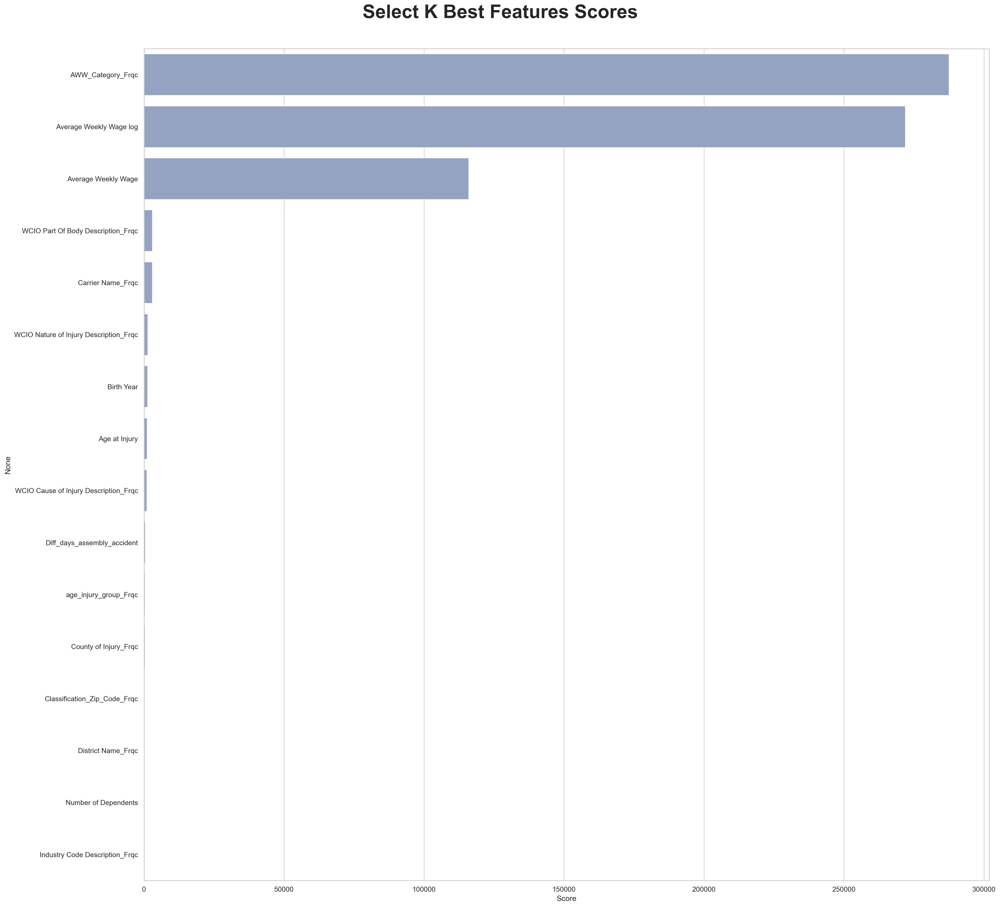

In [736]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train3)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

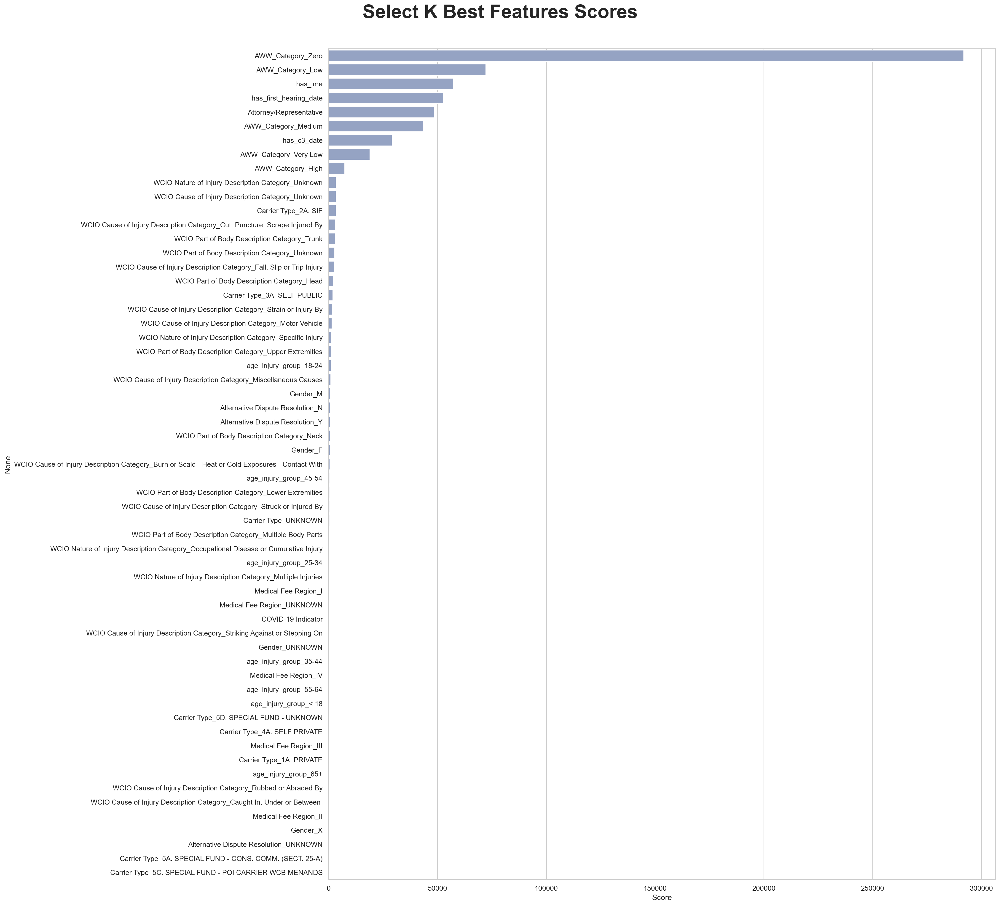

In [738]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train3)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [740]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train3)
importances = rf.feature_importances_

In [741]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
51,AWW_Category_Zero,2.839703e-01
48,AWW_Category_Low,9.043472e-02
49,AWW_Category_Medium,6.031779e-02
4,has_ime,6.004660e-02
0,Attorney/Representative,5.888750e-02
3,has_first_hearing_date,4.744721e-02
1,has_c3_date,3.259548e-02
50,AWW_Category_Very Low,2.474825e-02
47,AWW_Category_High,1.483657e-02
29,WCIO Part of Body Description Category_Trunk,1.468010e-02


**Lasso Regression**

In [743]:
reg = LassoCV()
reg.fit(X_train_num, target_train3)

LassoCV()

In [744]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 14 variables and eliminated the other 2 variables


Average Weekly Wage                      -0.684572
AWW_Category_Frqc                        -0.364539
Industry Code Description_Frqc           -0.033845
Classification_Zip_Code_Frqc             -0.008385
WCIO Nature of Injury Description_Frqc   -0.006832
County of Injury_Frqc                    -0.006610
District Name_Frqc                       -0.002286
Number of Dependents                     -0.000411
Age at Injury                             0.000000
Birth Year                               -0.000000
age_injury_group_Frqc                     0.008400
WCIO Part Of Body Description_Frqc        0.012885
Carrier Name_Frqc                         0.024538
WCIO Cause of Injury Description_Frqc     0.025811
Average Weekly Wage log                   0.542771
Diff_days_assembly_accident               1.026765
dtype: float64

**Ridge Regression**

In [746]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train3)

RidgeCV()

In [747]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Average Weekly Wage                      -0.723596
AWW_Category_Frqc                        -0.348520
Industry Code Description_Frqc           -0.033064
WCIO Nature of Injury Description_Frqc   -0.008993
Classification_Zip_Code_Frqc             -0.008761
County of Injury_Frqc                    -0.007151
District Name_Frqc                       -0.002732
Number of Dependents                     -0.001542
WCIO Part Of Body Description_Frqc        0.011622
age_injury_group_Frqc                     0.011686
Carrier Name_Frqc                         0.026084
WCIO Cause of Injury Description_Frqc     0.028444
Average Weekly Wage log                   0.574633
Age at Injury                             0.929509
Birth Year                                1.257025
Diff_days_assembly_accident               1.858581
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

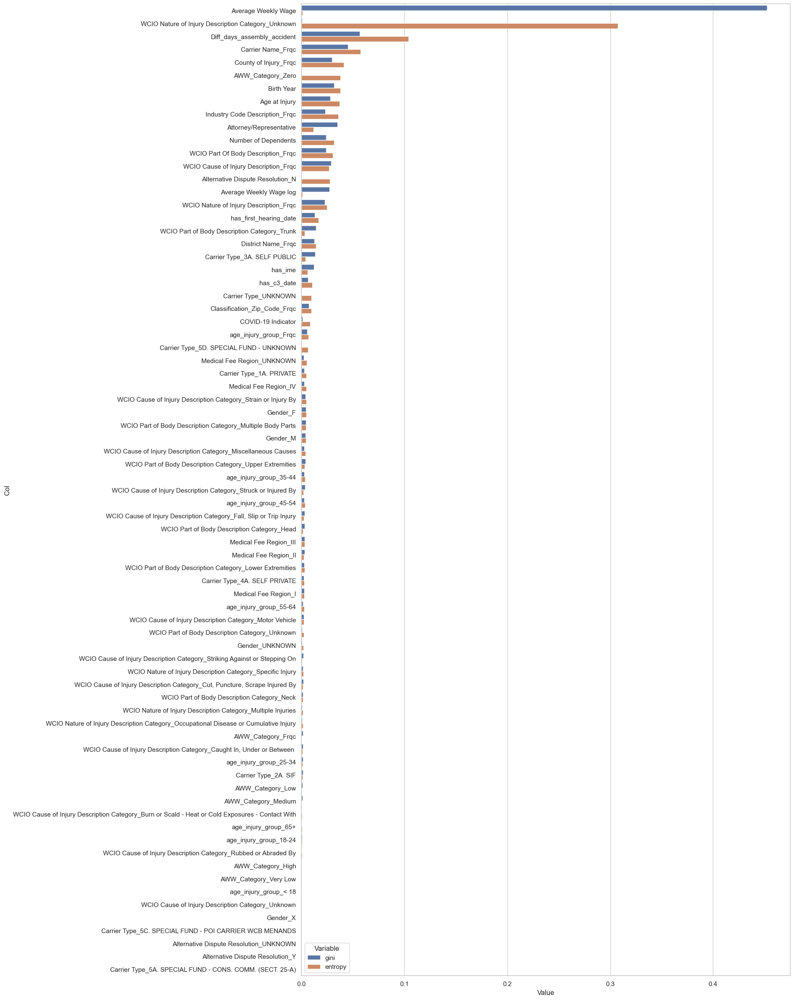

In [924]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train3).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 3

***Best Categorical:*** 'AWW_Category_Zero'<br>
***Best Numerical:*** 'AWW_Category_Frqc', 'Diff_days_assembly_accident'<br>

***Worst Categorical:*** 'age_injury_group_< 18', 'Alternative Dispute Resolution_UNKNOWN', 'Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS' <br>
***Worst Numerical:*** 'Industry Code Description_Frqc', 'Age at Injury', 'Number of Dependents' <br>

### Class 4

**Pearson correlation matrix**

<Axes: >

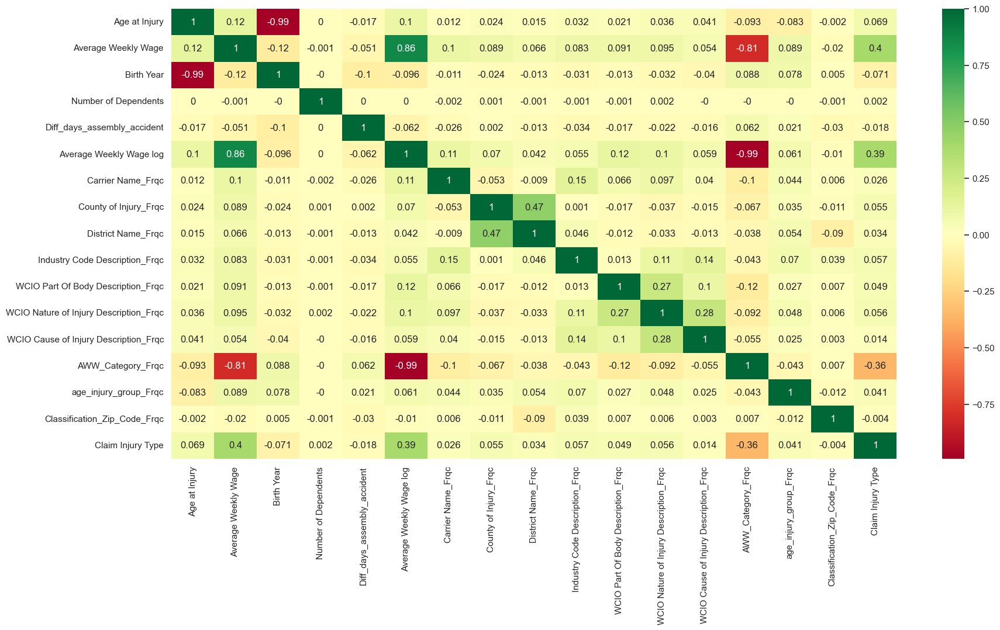

In [752]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train4], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [756]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train4], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_ime,Attorney/Representative,AWW_Category_Zero,AWW_Category_Medium,has_c3_date,has_first_hearing_date,AWW_Category_High,Carrier Type_3A. SELF PUBLIC,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Upper Extremities,WCIO Cause of Injury Description Category_Strain or Injury By,Carrier Type_1A. PRIVATE,AWW_Category_Low,WCIO Part of Body Description Category_Lower Extremities,age_injury_group_18-24,COVID-19 Indicator,Gender_M,Gender_F,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",WCIO Nature of Injury Description Category_Specific Injury,WCIO Part of Body Description Category_Head,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,WCIO Part of Body Description Category_Unknown,Medical Fee Region_IV,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,Carrier Type_4A. SELF PRIVATE,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Cause of Injury Description Category_Struck or Injured By,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Miscellaneous Causes,Medical Fee Region_I,age_injury_group_45-54,age_injury_group_55-64,Medical Fee Region_II,WCIO Part of Body Description Category_Neck,age_injury_group_25-34,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,age_injury_group_35-44,Carrier Type_UNKNOWN,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Cause of Injury Description Category_Striking Against or Stepping On,age_injury_group_< 18,Gender_UNKNOWN,WCIO Nature of Injury Description Category_Multiple Injuries,WCIO Part of Body Description Category_Multiple Body Parts,AWW_Category_Very Low,Carrier Type_5D. SPECIAL FUND - UNKNOWN,age_injury_group_65+,"WCIO Cause of Injury Description Category_Caught In, Under or Between",Carrier Type_2A. SIF,Medical Fee Region_III,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_UNKNOWN,Gender_X,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Alternative Dispute Resolution_UNKNOWN,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)
Claim Injury Type,1.0,0.389146,0.388682,0.368021,0.311497,0.287097,0.257322,0.187919,0.12809,0.121068,0.101838,0.098088,0.086848,0.074292,0.074125,0.073341,0.067383,0.067217,0.064699,0.058332,0.056454,0.053193,0.049719,0.049692,0.047362,0.044668,0.035828,0.034324,0.034037,0.033759,0.031683,0.030268,0.029552,0.029303,0.028829,0.025539,0.024197,0.023563,0.020393,0.020376,0.019078,0.01661,0.016172,0.015533,0.015419,0.015035,0.010418,0.010408,0.008885,0.007457,0.007347,0.006502,0.005497,0.004918,0.004293,0.003353,0.00273,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

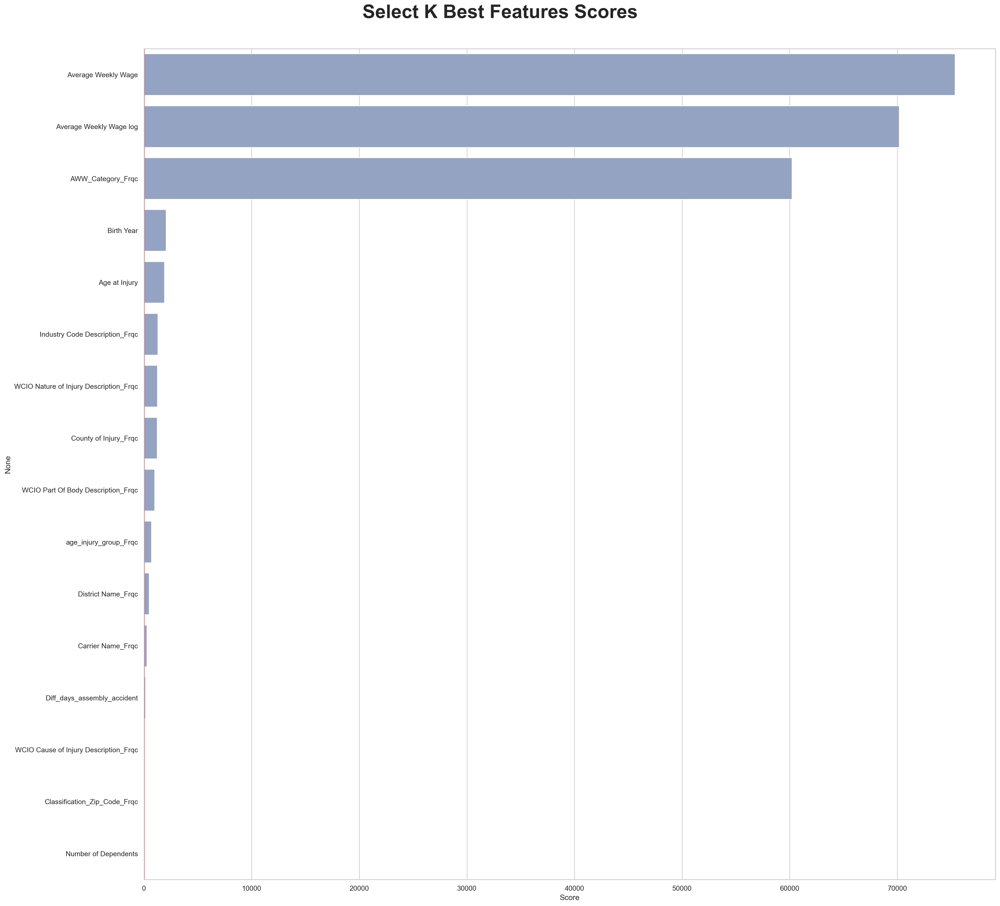

In [758]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train4)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

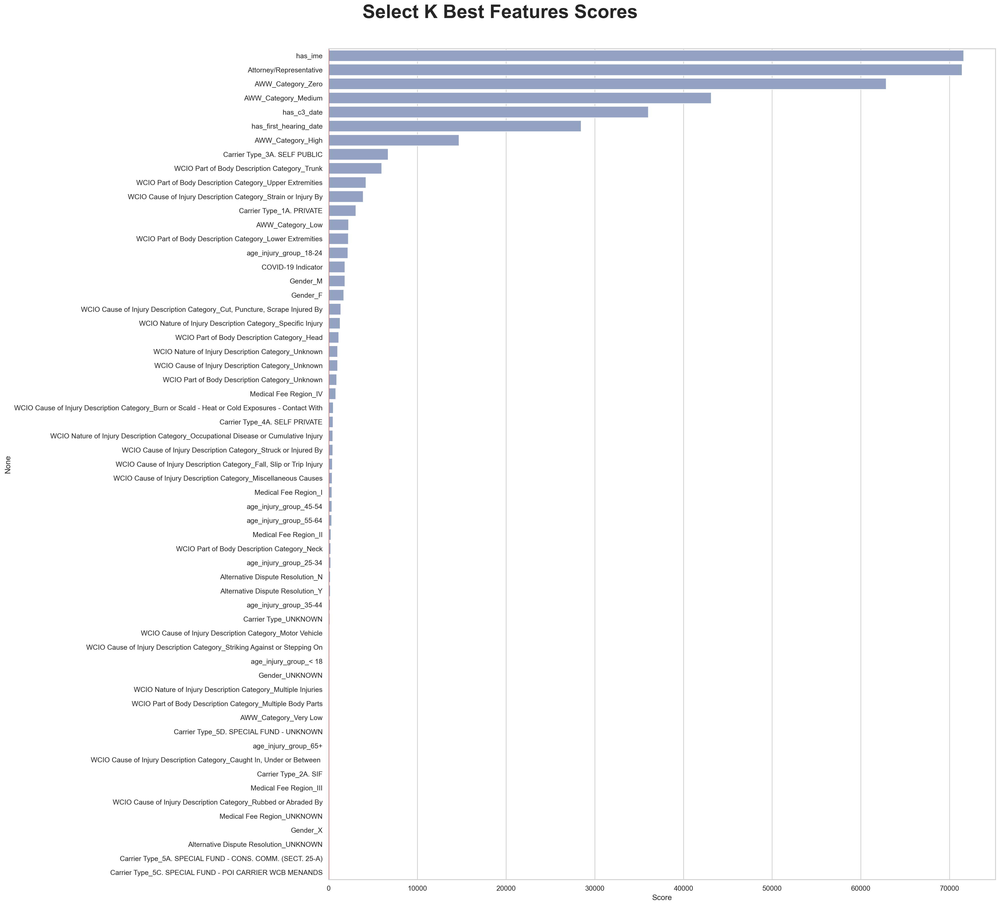

In [760]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train4)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [762]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train4)
importances = rf.feature_importances_

In [763]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
0,Attorney/Representative,1.059251e-01
4,has_ime,9.593113e-02
51,AWW_Category_Zero,7.260103e-02
3,has_first_hearing_date,5.678625e-02
1,has_c3_date,5.405690e-02
49,AWW_Category_Medium,5.399731e-02
29,WCIO Part of Body Description Category_Trunk,3.414769e-02
31,WCIO Part of Body Description Category_Upper E...,3.161074e-02
10,Carrier Type_3A. SELF PUBLIC,3.125754e-02
47,AWW_Category_High,2.432158e-02


**Lasso Regression**

In [765]:
reg = LassoCV()
reg.fit(X_train_num, target_train4)

LassoCV()

In [766]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 16 variables and eliminated the other 0 variables


Birth Year                               -0.874164
Age at Injury                            -0.606595
Diff_days_assembly_accident              -0.337251
Carrier Name_Frqc                        -0.019200
WCIO Cause of Injury Description_Frqc    -0.018291
District Name_Frqc                        0.000324
Number of Dependents                      0.001214
Classification_Zip_Code_Frqc              0.001427
age_injury_group_Frqc                     0.004332
WCIO Part Of Body Description_Frqc        0.006722
WCIO Nature of Injury Description_Frqc    0.012322
County of Injury_Frqc                     0.016187
Industry Code Description_Frqc            0.022931
AWW_Category_Frqc                         0.263188
Average Weekly Wage                       0.329014
Average Weekly Wage log                   0.437315
dtype: float64

**Ridge Regression**

In [768]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train4)

RidgeCV()

In [769]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Birth Year                               -2.360705
Age at Injury                            -1.704528
Diff_days_assembly_accident              -1.178120
Carrier Name_Frqc                        -0.020557
WCIO Cause of Injury Description_Frqc    -0.019764
District Name_Frqc                        0.000704
Classification_Zip_Code_Frqc              0.001148
Number of Dependents                      0.001644
age_injury_group_Frqc                     0.003669
WCIO Part Of Body Description_Frqc        0.010249
WCIO Nature of Injury Description_Frqc    0.013159
County of Injury_Frqc                     0.016303
Industry Code Description_Frqc            0.021283
AWW_Category_Frqc                         0.283862
Average Weekly Wage                       0.329028
Average Weekly Wage log                   0.457921
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

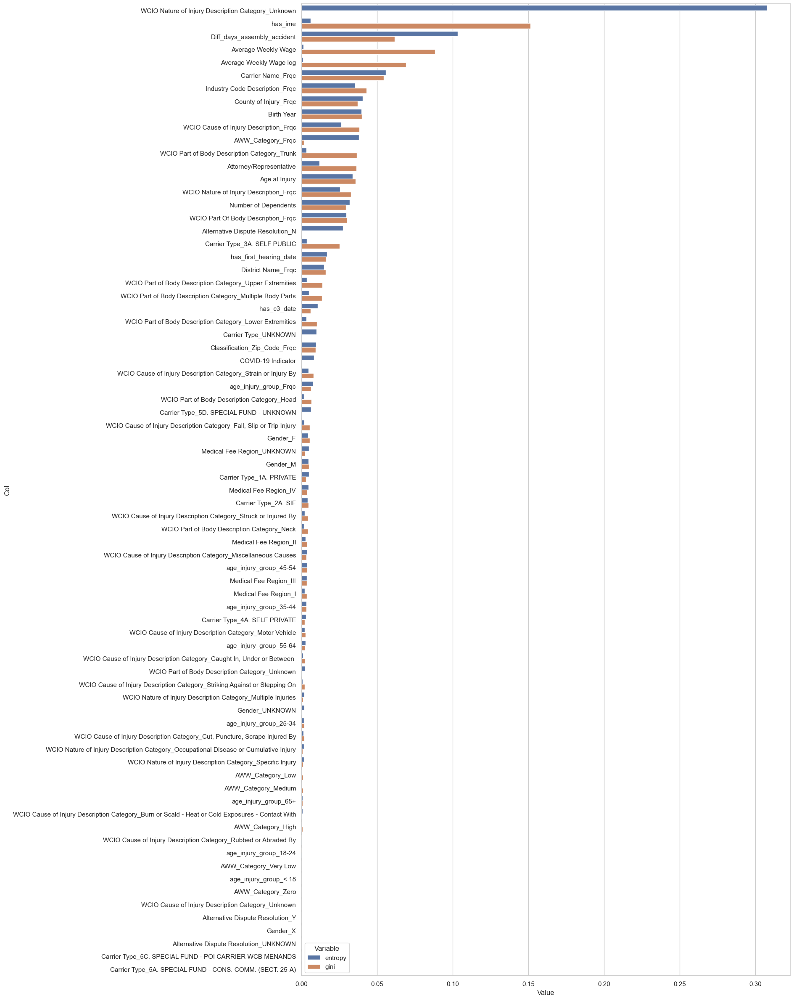

In [926]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train4).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 4

***Best Categorical:*** 'AWW_Category_Zero', 'has_ime', 'Attorney/Representative'<br>
***Best Numerical:*** 'Average Weekly Wage'<br>

***Worst Categorical:*** Carrier Type: 5A, 5C, 5D <br>
***Worst Numerical:*** 'District Name_Frqc', 'Number of Dependents' <br>

### Class 5

**Pearson correlation matrix**

<Axes: >

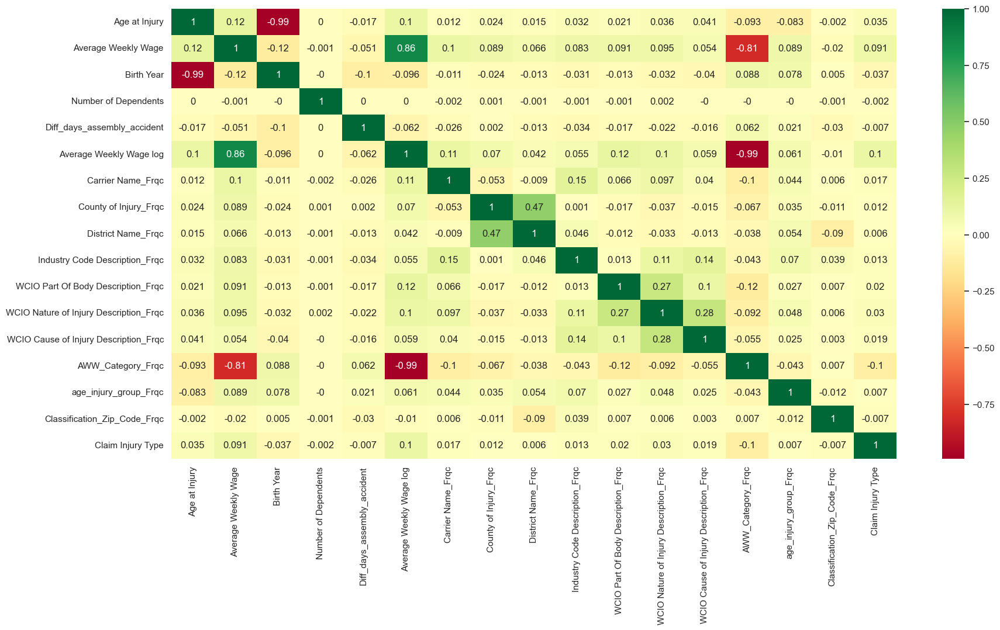

In [774]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train5], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [778]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train5], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_ime,has_first_hearing_date,Attorney/Representative,AWW_Category_Zero,has_c3_date,AWW_Category_Medium,AWW_Category_Low,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Trunk,AWW_Category_High,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Part of Body Description Category_Upper Extremities,age_injury_group_18-24,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",age_injury_group_55-64,WCIO Part of Body Description Category_Lower Extremities,age_injury_group_25-34,Carrier Type_2A. SIF,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",COVID-19 Indicator,WCIO Cause of Injury Description Category_Strain or Injury By,Carrier Type_1A. PRIVATE,WCIO Nature of Injury Description Category_Specific Injury,WCIO Cause of Injury Description Category_Miscellaneous Causes,age_injury_group_45-54,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,AWW_Category_Very Low,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Nature of Injury Description Category_Multiple Injuries,WCIO Part of Body Description Category_Head,Medical Fee Region_I,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,WCIO Cause of Injury Description Category_Striking Against or Stepping On,WCIO Part of Body Description Category_Unknown,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Multiple Body Parts,age_injury_group_65+,Carrier Type_3A. SELF PUBLIC,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,WCIO Cause of Injury Description Category_Struck or Injured By,Medical Fee Region_IV,Carrier Type_4A. SELF PRIVATE,age_injury_group_< 18,Carrier Type_UNKNOWN,Gender_UNKNOWN,Medical Fee Region_III,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Medical Fee Region_II,Gender_M,Carrier Type_5D. SPECIAL FUND - UNKNOWN,age_injury_group_35-44,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Alternative Dispute Resolution_UNKNOWN,Gender_F,Gender_X,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)
Claim Injury Type,1.0,0.146036,0.142457,0.122458,0.10376,0.087665,0.066593,0.050414,0.046178,0.040237,0.032245,0.031306,0.026271,0.023591,0.021747,0.020181,0.019632,0.018954,0.016782,0.016761,0.016226,0.016043,0.016041,0.015011,0.014973,0.014583,0.014364,0.014301,0.014294,0.012965,0.011696,0.011595,0.009813,0.009011,0.00871,0.008564,0.007715,0.007209,0.006855,0.006727,0.006366,0.005586,0.005581,0.005446,0.005359,0.004917,0.004632,0.004516,0.004435,0.003209,0.001791,0.001085,0.000841,0.000545,0.00019,0.0,0.0,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

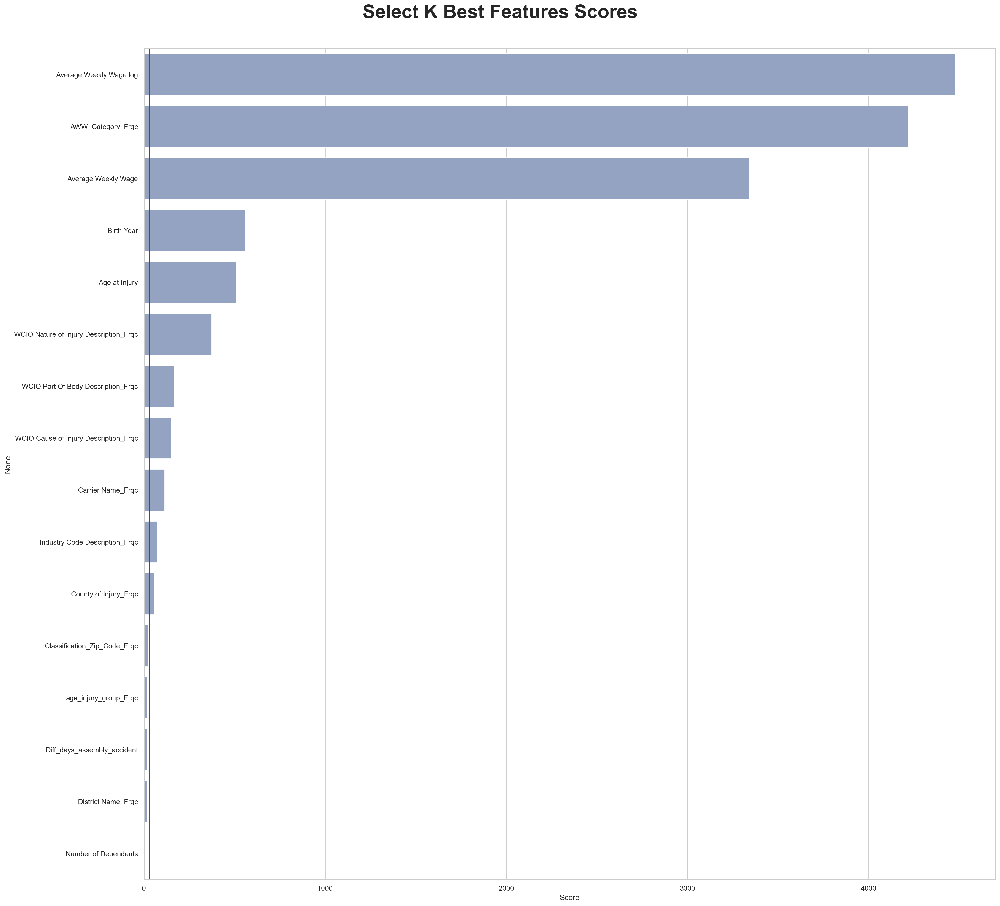

In [780]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train5)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

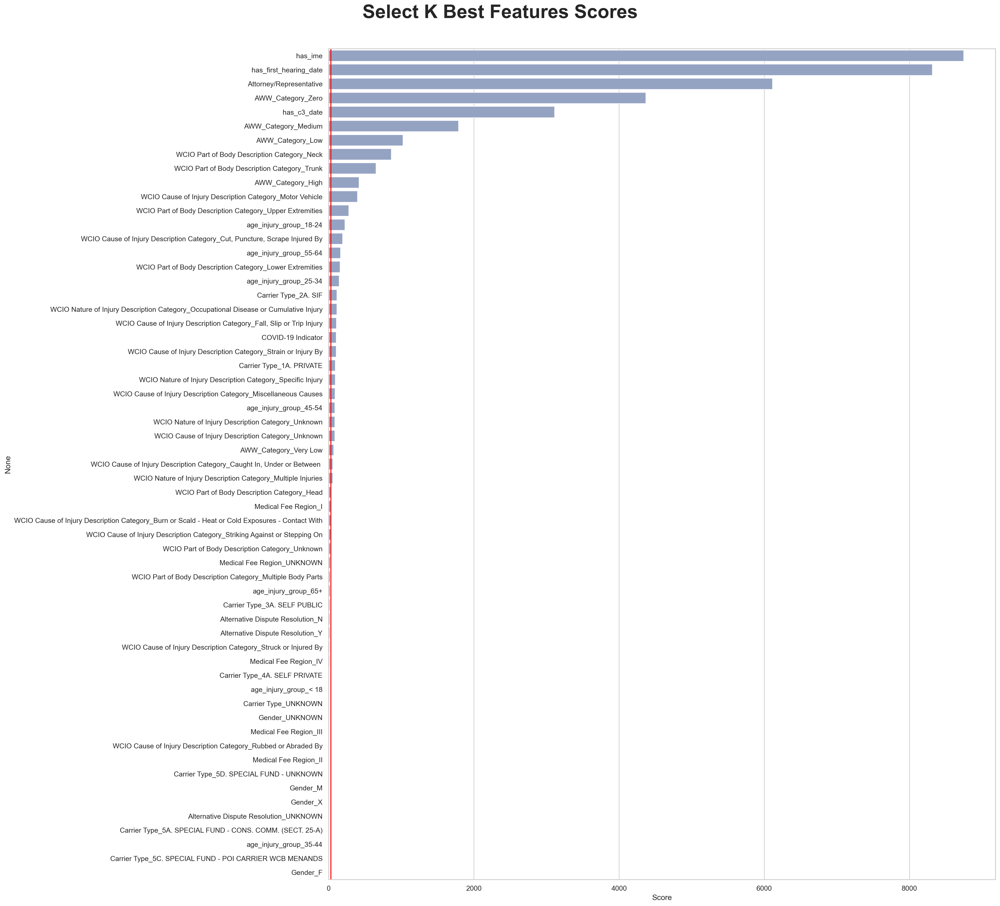

In [782]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train5)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [784]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train5)
importances = rf.feature_importances_

In [785]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,5.539020e-02
4,has_ime,3.674614e-02
55,age_injury_group_45-54,3.664133e-02
56,age_injury_group_55-64,3.486710e-02
54,age_injury_group_35-44,3.397422e-02
8,Carrier Type_1A. PRIVATE,3.350325e-02
39,WCIO Cause of Injury Description Category_Fall...,3.308814e-02
9,Carrier Type_2A. SIF,3.186351e-02
10,Carrier Type_3A. SELF PUBLIC,3.174668e-02
43,WCIO Cause of Injury Description Category_Stra...,3.152746e-02


**Lasso Regression**

In [787]:
reg = LassoCV()
reg.fit(X_train_num, target_train5)

LassoCV()

In [788]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 15 variables and eliminated the other 1 variables


Birth Year                               -0.260074
Age at Injury                            -0.178294
Diff_days_assembly_accident              -0.129817
Average Weekly Wage                      -0.006871
Classification_Zip_Code_Frqc             -0.001838
Number of Dependents                     -0.000499
District Name_Frqc                       -0.000059
age_injury_group_Frqc                     0.000000
Carrier Name_Frqc                         0.000442
Industry Code Description_Frqc            0.000757
County of Injury_Frqc                     0.001269
WCIO Part Of Body Description_Frqc        0.001400
WCIO Cause of Injury Description_Frqc     0.001900
WCIO Nature of Injury Description_Frqc    0.003835
AWW_Category_Frqc                         0.011470
Average Weekly Wage log                   0.035486
dtype: float64

**Ridge Regression**

In [790]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train5)

RidgeCV()

In [791]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Birth Year                               -0.389110
Age at Injury                            -0.273565
Diff_days_assembly_accident              -0.202773
Average Weekly Wage                      -0.008613
Classification_Zip_Code_Frqc             -0.001950
Number of Dependents                     -0.000529
District Name_Frqc                       -0.000082
age_injury_group_Frqc                    -0.000071
Carrier Name_Frqc                         0.000373
Industry Code Description_Frqc            0.000619
County of Injury_Frqc                     0.001331
WCIO Part Of Body Description_Frqc        0.001696
WCIO Cause of Injury Description_Frqc     0.001872
WCIO Nature of Injury Description_Frqc    0.003883
AWW_Category_Frqc                         0.014177
Average Weekly Wage log                   0.038798
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

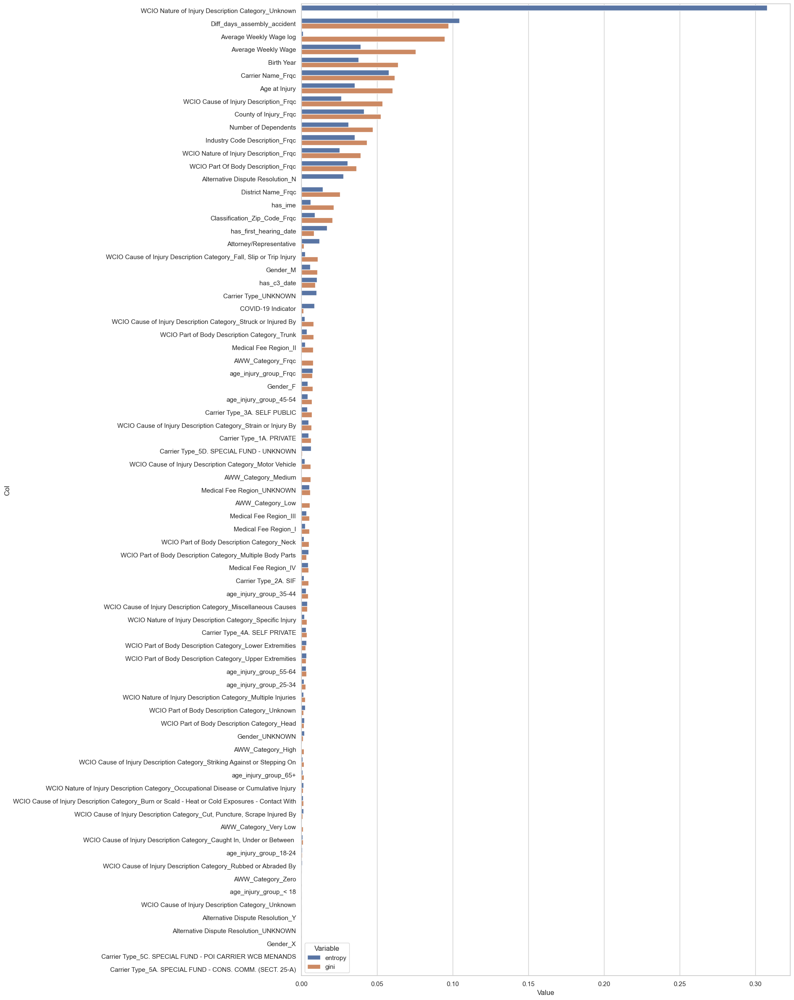

In [927]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train5).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 5

***Best Categorical:*** 'AWW_Category_Zero', 'has_ime', 'has_c3_date'<br>
***Best Numerical:*** 'Average Weekly Wage log', 'Birth Year'<br>

***Worst Categorical:*** 'age_injury_group_< 18', 'Alternative Dispute Resolution_UNKNOWN',  'Gender_F', Carrier Type 5A <br>
***Worst Numerical:*** 'age_injury_group_Frqc', 'Number of Dependents' <br>

### Class 6

**Pearson correlation matrix**

<Axes: >

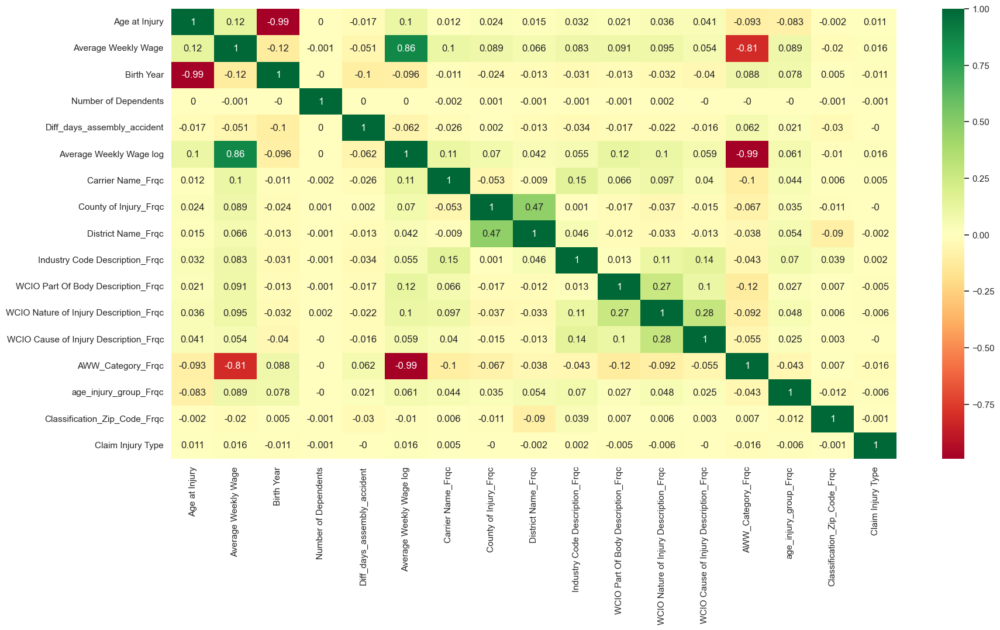

In [796]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train6], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [800]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train6], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_ime,has_first_hearing_date,Attorney/Representative,AWW_Category_Zero,has_c3_date,AWW_Category_Medium,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,age_injury_group_65+,AWW_Category_High,WCIO Nature of Injury Description Category_Specific Injury,AWW_Category_Low,WCIO Part of Body Description Category_Upper Extremities,COVID-19 Indicator,Carrier Type_5D. SPECIAL FUND - UNKNOWN,age_injury_group_25-34,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Head,age_injury_group_55-64,Carrier Type_2A. SIF,WCIO Cause of Injury Description Category_Miscellaneous Causes,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Gender_M,Medical Fee Region_UNKNOWN,Gender_F,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Lower Extremities,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Nature of Injury Description Category_Multiple Injuries,Carrier Type_3A. SELF PUBLIC,age_injury_group_18-24,Medical Fee Region_IV,Medical Fee Region_II,Carrier Type_4A. SELF PRIVATE,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",age_injury_group_35-44,AWW_Category_Very Low,Carrier Type_1A. PRIVATE,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Part of Body Description Category_Unknown,Medical Fee Region_III,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,age_injury_group_45-54,Medical Fee Region_I,Gender_UNKNOWN,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,WCIO Part of Body Description Category_Multiple Body Parts,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,WCIO Cause of Injury Description Category_Struck or Injured By,Carrier Type_UNKNOWN,WCIO Cause of Injury Description Category_Rubbed or Abraded By,Gender_X,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,Alternative Dispute Resolution_UNKNOWN,age_injury_group_< 18,WCIO Cause of Injury Description Category_Striking Against or Stepping On
Claim Injury Type,1.0,0.021688,0.021607,0.018937,0.015762,0.013236,0.008591,0.00811,0.007989,0.007837,0.007293,0.006928,0.006871,0.0065,0.006224,0.00598,0.00579,0.005601,0.005189,0.004543,0.00447,0.003207,0.003022,0.002882,0.002811,0.002782,0.002714,0.00266,0.002493,0.002323,0.002063,0.00193,0.00185,0.001821,0.001556,0.001501,0.001486,0.000889,0.000829,0.000626,0.000586,0.000573,0.000418,0.000416,0.000327,0.000254,0.000127,0.000073,0.000025,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

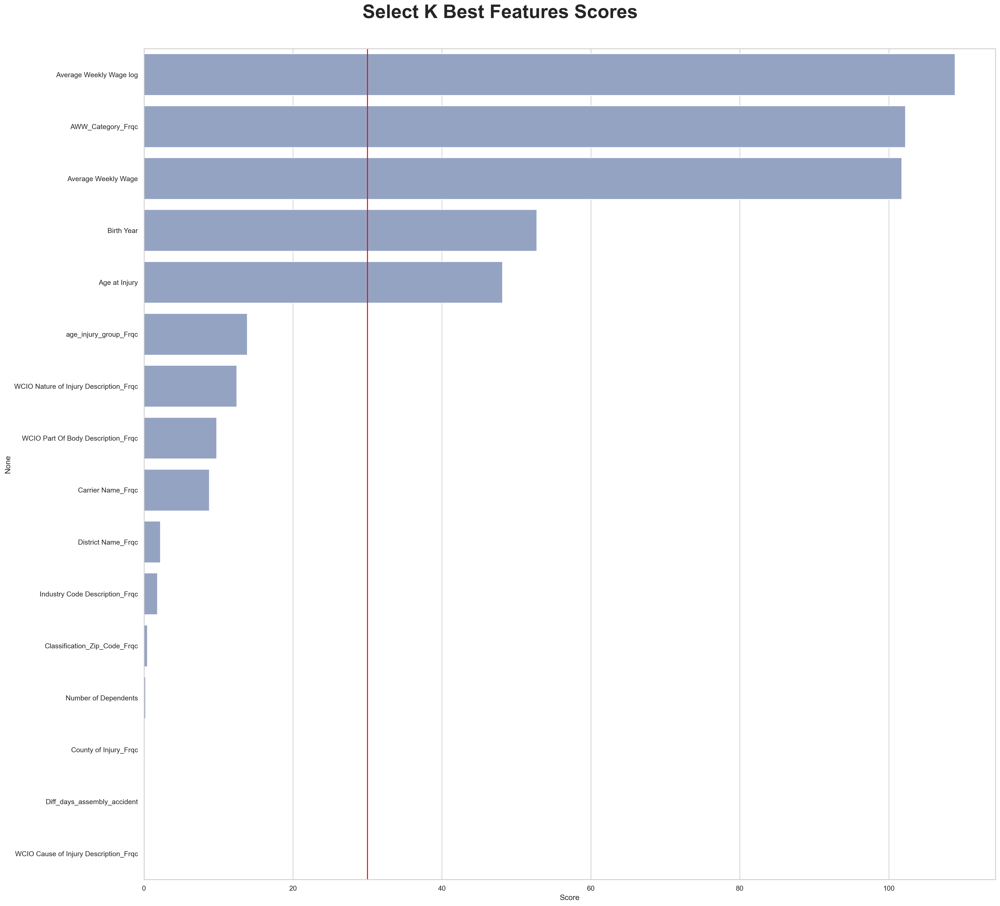

In [802]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train6)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

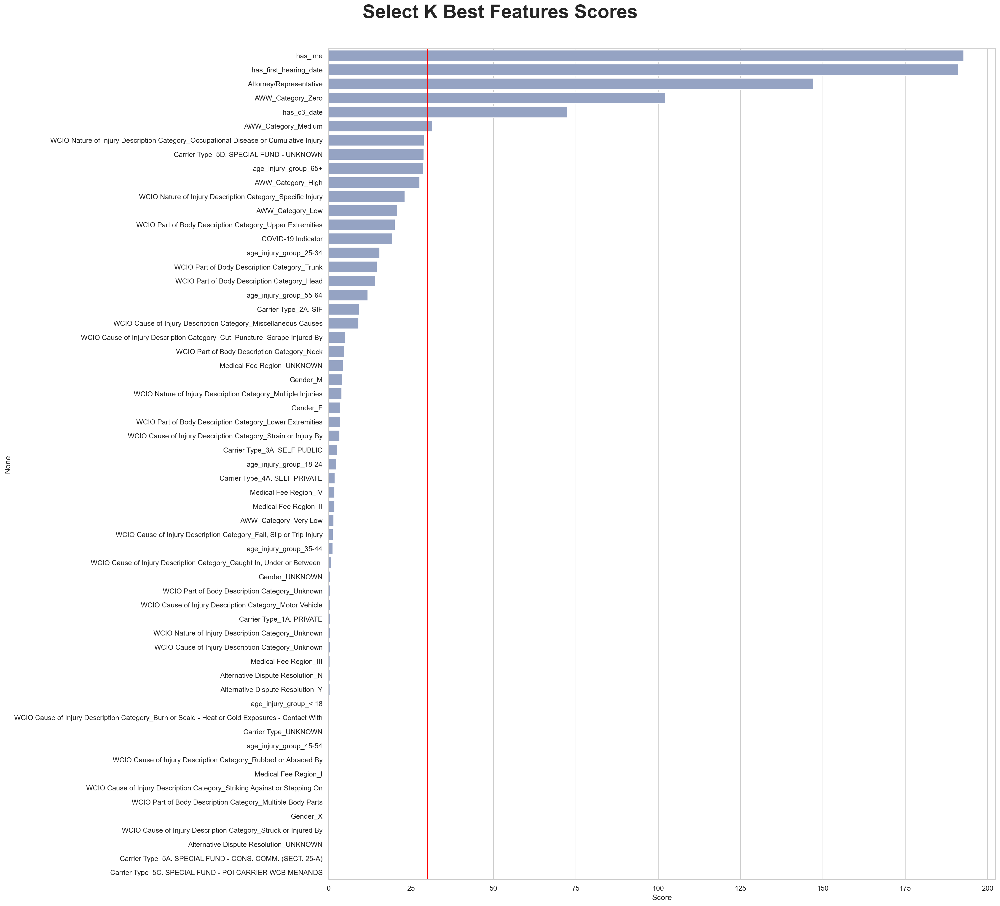

In [804]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train6)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [806]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train6)
importances = rf.feature_importances_

In [807]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,6.102431e-02
4,has_ime,5.915080e-02
20,Medical Fee Region_I,3.480455e-02
56,age_injury_group_55-64,3.397415e-02
49,AWW_Category_Medium,3.334280e-02
48,AWW_Category_Low,3.298610e-02
8,Carrier Type_1A. PRIVATE,3.243830e-02
55,age_injury_group_45-54,3.107570e-02
17,Gender_M,3.070594e-02
16,Gender_F,3.038336e-02


**Lasso Regression**

In [809]:
reg = LassoCV()
reg.fit(X_train_num, target_train6)

LassoCV()

In [810]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 16 variables and eliminated the other 0 variables


Birth Year                               -0.009759
Age at Injury                            -0.006459
Diff_days_assembly_accident              -0.004581
age_injury_group_Frqc                    -0.000359
WCIO Nature of Injury Description_Frqc   -0.000229
WCIO Part Of Body Description_Frqc       -0.000205
District Name_Frqc                       -0.000101
Classification_Zip_Code_Frqc             -0.000050
Number of Dependents                     -0.000026
County of Injury_Frqc                    -0.000019
WCIO Cause of Injury Description_Frqc     0.000016
Industry Code Description_Frqc            0.000049
AWW_Category_Frqc                         0.000060
Carrier Name_Frqc                         0.000119
Average Weekly Wage log                   0.000433
Average Weekly Wage                       0.000543
dtype: float64

**Ridge Regression**

In [812]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train6)

RidgeCV()

In [813]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Birth Year                               -0.012114
Age at Injury                            -0.008199
Diff_days_assembly_accident              -0.005922
age_injury_group_Frqc                    -0.000364
WCIO Nature of Injury Description_Frqc   -0.000229
WCIO Part Of Body Description_Frqc       -0.000201
District Name_Frqc                       -0.000101
Classification_Zip_Code_Frqc             -0.000052
Number of Dependents                     -0.000027
County of Injury_Frqc                    -0.000019
WCIO Cause of Injury Description_Frqc     0.000017
Industry Code Description_Frqc            0.000047
AWW_Category_Frqc                         0.000103
Carrier Name_Frqc                         0.000118
Average Weekly Wage log                   0.000477
Average Weekly Wage                       0.000542
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

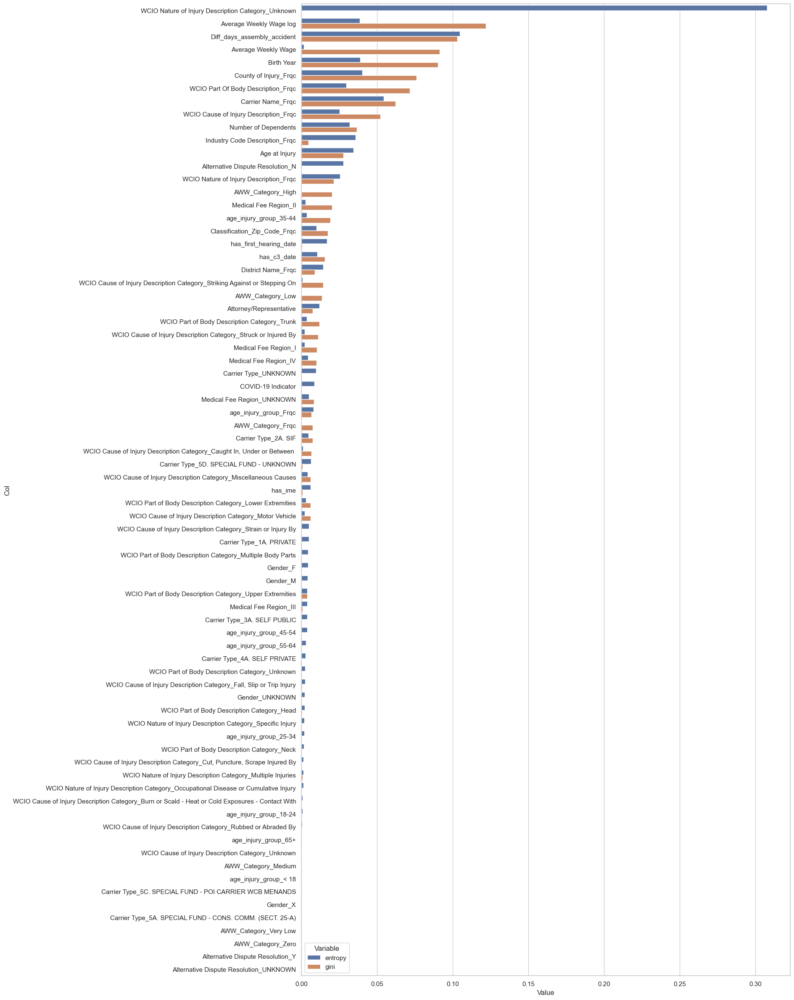

In [929]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train6).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 6

***Best Categorical:*** 'AWW_Category_Zero', 'has_ime'<br>
***Best Numerical:*** 'Average Weekly Wage log', 'Birth Year'<br>

***Worst Categorical:*** 'Alternative Dispute Resolution_UNKNOWN', Carrier Type: 5A, 5C, 5D, 'WCIO Cause of Injury Description Category_Striking Against or Stepping On' <br>
***Worst Numerical:*** 'WCIO Cause of Injury Description_Frqc' <br>

### Class 7

**Pearson correlation matrix**

<Axes: >

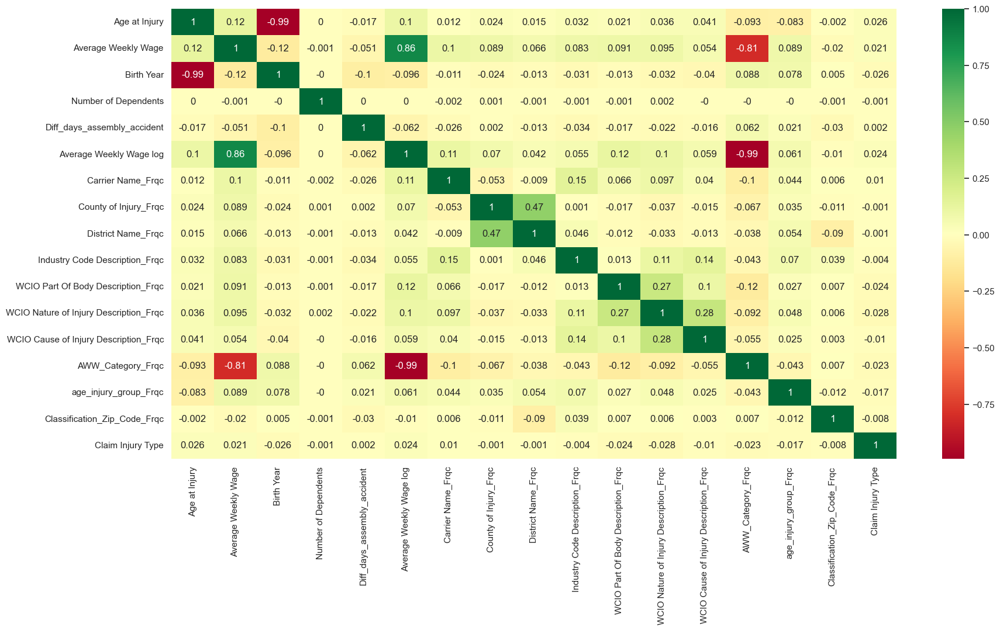

In [818]:
plt.figure(figsize=(20,10))
X_train_and_target= pd.concat([X_train_num, df_target_train7], axis=1)
sns.heatmap(X_train_and_target.corr(method='pearson').round(3), annot=True, cmap="RdYlGn")

**Cramer's V**

In [823]:
#Heatmap of Cramér's V
df_cramers = pd.concat([X_train_cat, df_target_train7], axis=1)
results = pd.DataFrame(index=df_cramers.columns, columns=df_cramers.columns)

for var1 in df_cramers.columns:
    for var2 in df_cramers.columns:
        if var1 != var2:
            results.loc[var1, var2] = cramers_v(df_cramers[var1], df_cramers[var2])
        else:
            results.loc[var1, var2] = 1

results = results.astype(float)
last_row_index = results.index[-1]
last_row = results.iloc[-1, :] 
lower_triangle_last_row = last_row.loc[:last_row_index]
pd.DataFrame(lower_triangle_last_row.sort_values(ascending=False)).T

,Claim Injury Type,has_first_hearing_date,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,COVID-19 Indicator,WCIO Nature of Injury Description Category_Specific Injury,WCIO Cause of Injury Description Category_Miscellaneous Causes,Attorney/Representative,age_injury_group_65+,AWW_Category_Zero,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Upper Extremities,Gender_M,WCIO Nature of Injury Description Category_Multiple Injuries,Gender_F,WCIO Part of Body Description Category_Multiple Body Parts,Medical Fee Region_UNKNOWN,AWW_Category_Medium,WCIO Cause of Injury Description Category_Strain or Injury By,has_c3_date,WCIO Part of Body Description Category_Lower Extremities,AWW_Category_Low,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_2A. SIF,age_injury_group_25-34,WCIO Cause of Injury Description Category_Motor Vehicle,age_injury_group_55-64,age_injury_group_18-24,AWW_Category_High,"WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By",Carrier Type_1A. PRIVATE,"WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Struck or Injured By,age_injury_group_35-44,Medical Fee Region_II,WCIO Cause of Injury Description Category_Striking Against or Stepping On,Carrier Type_4A. SELF PRIVATE,Medical Fee Region_IV,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Unknown,Gender_UNKNOWN,WCIO Part of Body Description Category_Unknown,AWW_Category_Very Low,Medical Fee Region_III,"WCIO Cause of Injury Description Category_Caught In, Under or Between",WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,Alternative Dispute Resolution_N,Alternative Dispute Resolution_Y,Carrier Type_UNKNOWN,WCIO Part of Body Description Category_Neck,has_ime,Carrier Type_3A. SELF PUBLIC,age_injury_group_45-54,WCIO Cause of Injury Description Category_Rubbed or Abraded By,WCIO Part of Body Description Category_Head,Medical Fee Region_I,Gender_X,Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),age_injury_group_< 18,Alternative Dispute Resolution_UNKNOWN
Claim Injury Type,1.0,0.047627,0.041305,0.041022,0.038764,0.036432,0.035552,0.028417,0.023596,0.021902,0.018437,0.016648,0.016455,0.016218,0.015193,0.015141,0.015095,0.014513,0.014251,0.013492,0.011585,0.01016,0.009928,0.009633,0.009146,0.008258,0.008103,0.007617,0.006975,0.006335,0.006328,0.006308,0.00572,0.00558,0.005086,0.004355,0.004248,0.002349,0.002346,0.00211,0.001986,0.001951,0.001817,0.001756,0.001574,0.001272,0.001269,0.000794,0.000792,0.000351,0.000293,0.000258,0.00012,0.0,0.0,0.0,0.0,0.0,0.0,0.0


**Select K-Best: Numerical Variables**

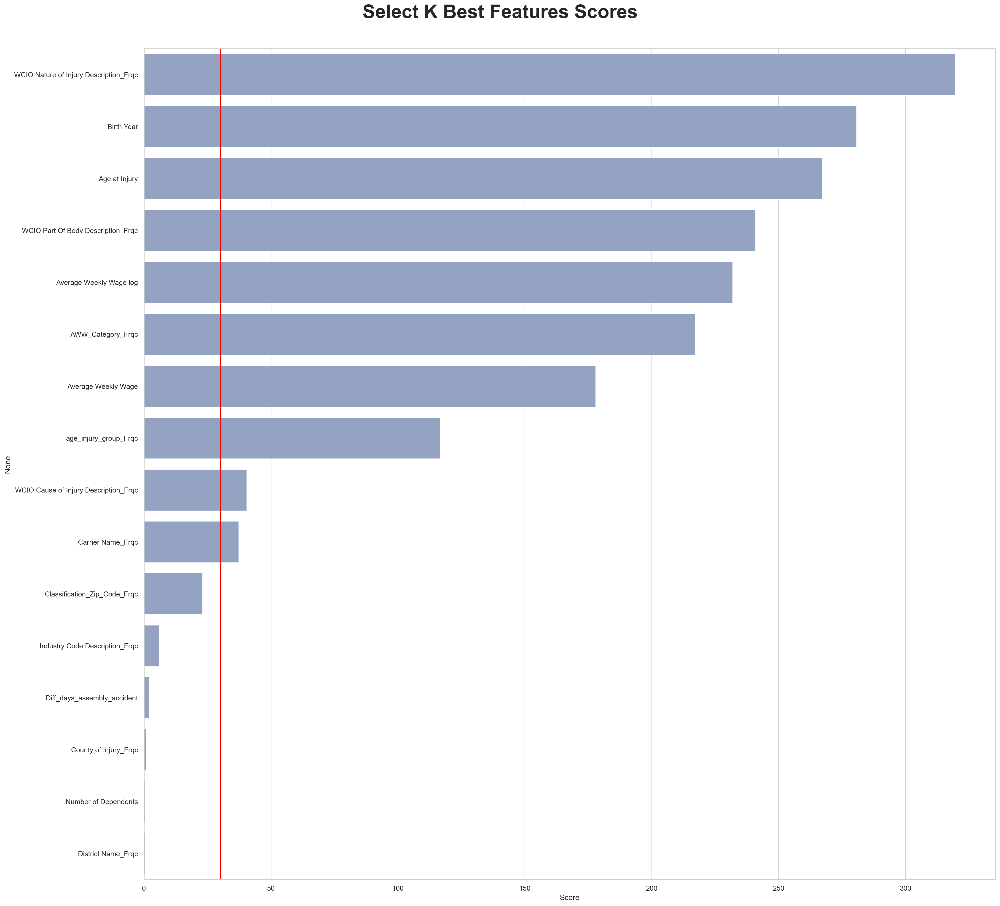

In [825]:
X_new2 = SelectKBest(k='all').fit(X_train_num, target_train7)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Select K-Best: Categorical Variables**

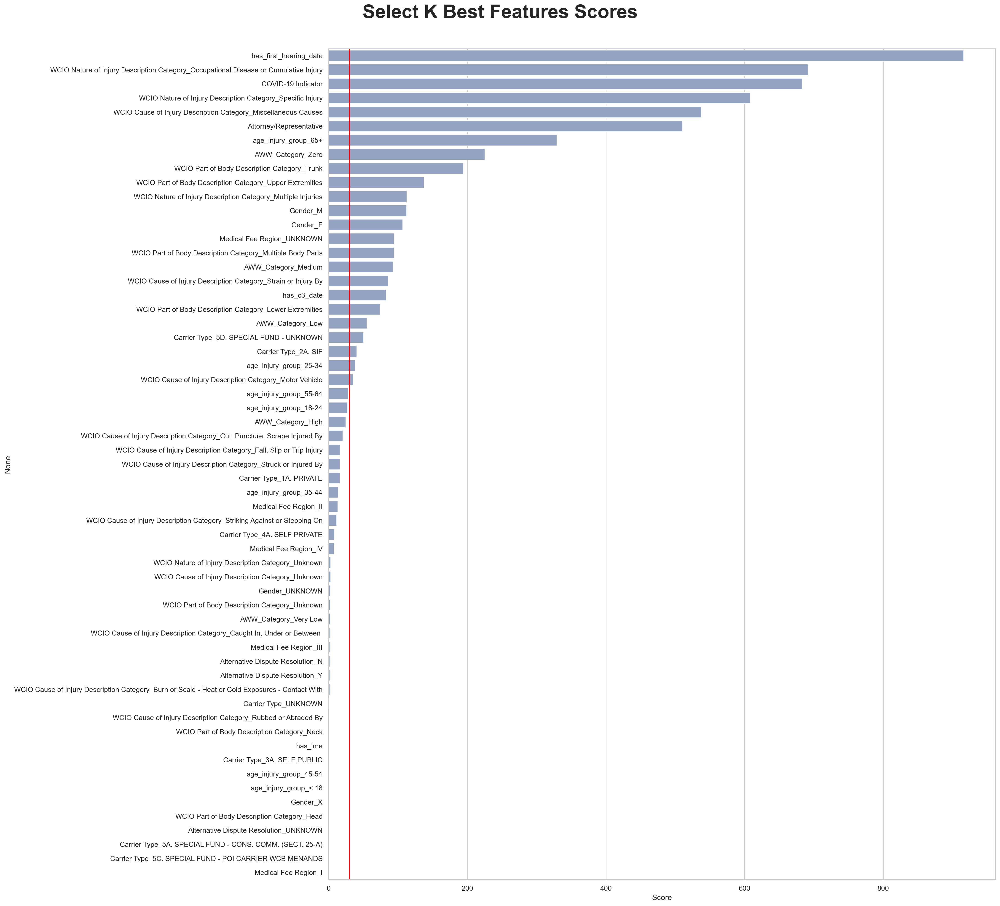

In [827]:
X_new2 = SelectKBest(k='all').fit(X_train_cat, target_train7)
kbest_features = pd.DataFrame(X_new2.scores_, X_new2.feature_names_in_).rename(columns={0: "Score"})
kbest_features.sort_values("Score", ascending=False, inplace=True)

sns.set(font_scale=1)
sns.set_style("whitegrid")
plt.figure(figsize=(23,20), dpi=200)
sns.barplot(data=kbest_features, y=kbest_features.index, x=kbest_features["Score"], color=sns.color_palette("Set2")[2], orient="h")
plt.axvline(x=30, color='red')
plt.tight_layout(pad=4)
plt.suptitle("Select K Best Features Scores", fontweight="bold", fontsize=30, y=1.015)
plt.show()

**Random Forest- Categorical Variables**

Threshould used: 0.017 (= 1 / 59 features)

In [829]:
rf = RandomForestClassifier()
rf.fit(X_train_cat, df_target_train7)
importances = rf.feature_importances_

In [830]:
feature_importance_df = pd.DataFrame({
    'Feature': X_train_cat.columns,
    'Importance': importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

feature_importance_df

,Feature,Importance
1,has_c3_date,1.048680e-01
4,has_ime,5.860629e-02
0,Attorney/Representative,4.516507e-02
51,AWW_Category_Zero,3.610683e-02
29,WCIO Part of Body Description Category_Trunk,3.109871e-02
49,AWW_Category_Medium,3.097997e-02
3,has_first_hearing_date,3.079126e-02
9,Carrier Type_2A. SIF,3.028421e-02
56,age_injury_group_55-64,3.005357e-02
8,Carrier Type_1A. PRIVATE,2.982687e-02


**Lasso Regression**

In [832]:
reg = LassoCV()
reg.fit(X_train_num, target_train7)

LassoCV()

In [833]:
coef = pd.Series(reg.coef_, index = X_train_num.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " +  str(sum(coef == 0)) + " variables")
coef.sort_values()

Lasso picked 16 variables and eliminated the other 0 variables


Birth Year                               -0.008987
Age at Injury                            -0.002388
age_injury_group_Frqc                    -0.001971
WCIO Nature of Injury Description_Frqc   -0.001951
WCIO Part Of Body Description_Frqc       -0.001924
Average Weekly Wage                      -0.000660
Classification_Zip_Code_Frqc             -0.000646
Diff_days_assembly_accident              -0.000391
WCIO Cause of Injury Description_Frqc    -0.000313
County of Injury_Frqc                    -0.000279
Industry Code Description_Frqc           -0.000260
District Name_Frqc                       -0.000101
Number of Dependents                     -0.000082
Carrier Name_Frqc                         0.000832
AWW_Category_Frqc                         0.001819
Average Weekly Wage log                   0.004074
dtype: float64

**Ridge Regression**

In [835]:
#Initializing the instance
ridge = RidgeCV()
ridge.fit(X_train_num, target_train7)

RidgeCV()

In [836]:
coef_ridge = pd.Series(ridge.coef_, index = X_train_num.columns)
coef_ridge.sort_values()

Birth Year                               -0.018368
Age at Injury                            -0.009315
Diff_days_assembly_accident              -0.005722
age_injury_group_Frqc                    -0.001985
WCIO Nature of Injury Description_Frqc   -0.001949
WCIO Part Of Body Description_Frqc       -0.001907
Average Weekly Wage                      -0.000797
Classification_Zip_Code_Frqc             -0.000654
WCIO Cause of Injury Description_Frqc    -0.000320
County of Injury_Frqc                    -0.000281
Industry Code Description_Frqc           -0.000274
District Name_Frqc                       -0.000101
Number of Dependents                     -0.000085
Carrier Name_Frqc                         0.000828
AWW_Category_Frqc                         0.002035
Average Weekly Wage log                   0.004340
dtype: float64

**Decision Tree**

<Axes: xlabel='Value', ylabel='Col'>

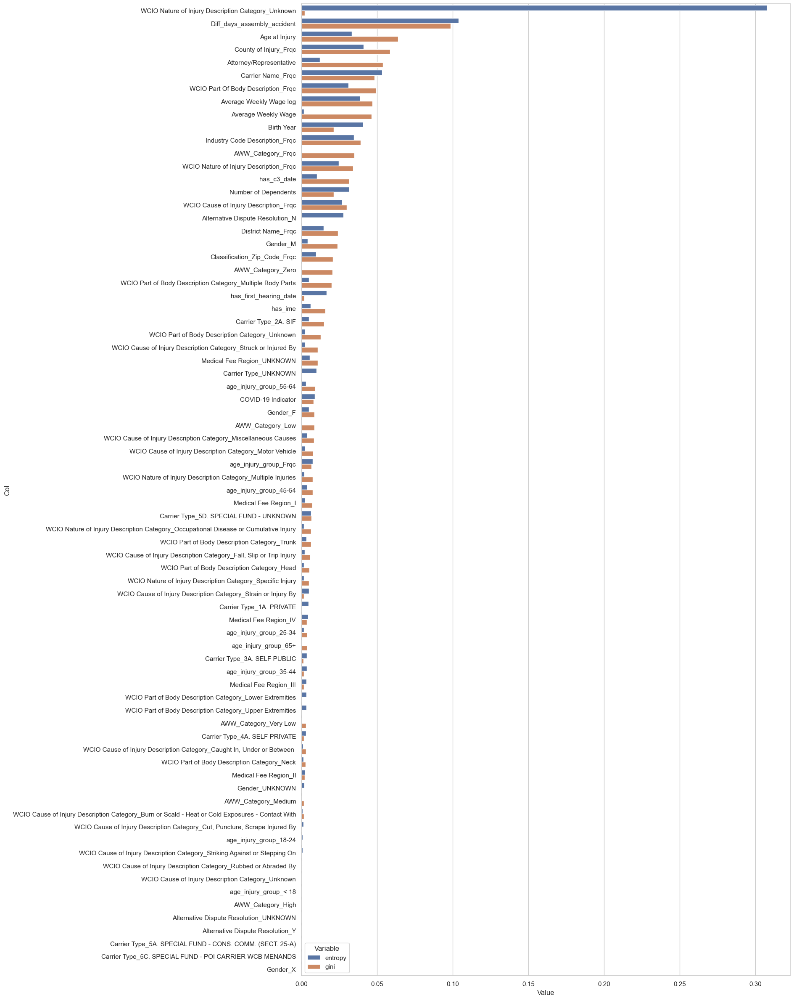

In [930]:
gini_importance = DecisionTreeClassifier().fit(X_train_all, target_train7).feature_importances_
entropy_importance = DecisionTreeClassifier(criterion='entropy').fit(X_train_all, target_train0).feature_importances_

zippy = pd.DataFrame(zip(gini_importance, entropy_importance), columns = ['gini','entropy'])
zippy['col'] = X_train_all.columns
tidy = zippy.melt(id_vars='col').rename(columns=str.title)
tidy.sort_values(['Value'], ascending = False, inplace = True)

plt.figure(figsize=(15,30))
sns.barplot(y='Col', x='Value', hue='Variable', data=tidy)

#### Overall features importance for class 7

***Best Categorical:*** 'AWW_Category_Zero', 'has_first_hearing_date', 'has_c3_date'<br>
***Best Numerical:*** 'Birth Year', 'WCIO Nature of Injury Description_Frqc'<br>

***Worst Categorical:*** 'Medical Fee Region_I', 'Alternative Dispute Resolution_UNKNOWN', Carrier Type 5C <br>
***Worst Numerical:*** 'District Name_Frqc', 'Number of Dependents' <br>

### Overall insights of the Class specific analysis

- DT evaluation shows severe imbalance. Only a few features dominate in importance, while the rest contribute minimally. In addition to this, it always shows the WCIO Category Unknowns as the most important for first division across most classes, using entropy criteriation.

- 'Birth Year' variable shows to be amongst the most important for some classes while it is the least important for others. Maybe this trait could have advantages in a multiclassification problem as this one. We consider it as relevant to include in our model.

- 

## Final Insights
Selection of which features to mantain and which to drop. <br> Based on the  methods used, we present a summary table below with the features we will include, discard and try with or without in the model.

<hr>

### Numerical Data
| Predictor                              | Univariate V. ?| Pearson/Spearman  | Select K-best | RFECV | Random Forest                  | Lasso                                | Ridge                                | What to do?                     |
|----------------------------------------|---------------|-------------------------|---------------|-------|--------------------------------|-------------------------------------|-------------------------------------|----------------------------------|
| Age at Injury                          | Keep          | Keep (if discard B.Y.) | Keep          | Keep  | Discard                        | Discard                             | Keep                            | Discard                          |
| Average Weekly Wage                    | Keep          | Keep (if discard AWW log) | Keep          | Keep  | Keep                           | Keep                                | Keep                                | Discard (keep AWW log)                          |
| Birth Year                             | Keep          | Keep (if discard A.I.) | Keep          | Keep  | Discard                        | Keep                                | Keep                                | Include                          |
| Diff_days_assembly_accident            | Keep          | Discard   | Keep          | Keep  | Keep          |Keep                           | Keep                                | Include                          |
| WCIO Nature of Injury Description_Frqc | Keep          | ?  | Keep          | Keep  | Discard                        | Keep                                | Keep                                | Include                          |
| WCIO Part Of Body Description_Frqc     | Keep          | ?  | Keep          | Keep  | Discard                           | Keep                                | Keep                                | Include                          |
| Number of Dependents                   | Keep          | Discard  | Discard       | Discard| Discard                        | ?                           | Discard                             | Discard                          |
| Average Weekly Wage log                | Keep          | Keep (if discard AWW)  | Keep          | Keep  | Keep                           | Keep                                | Keep                                | Include                          |
| Carrier Name_Frqc                      | Keep          | ?  | Keep          | Keep| Keep                           | Keep                                | Discard                                | Include                          |
| County of Injury_Frqc                  | Keep          | ?  | Keep          | Discard| Discard                        | Keep                                | Discard                                | Discard                         |
| Industry Code Description_Frqc         | Keep          | ?  | Keep          | Keep| Discard                        | Keep                                | Discard                               | Discard                         |
| District Name_Frqc                     | Keep          | Discard | Discard          | Discard| Discard                        | Keep                                | Keep                                | Discard                         |
| AWW_Category_Frqc                      | Keep          | Discard | Keep          | Keep  | Keep                           | Keep                                | Keep                                | Discard (keep AWW log)                          |
| age_injury_group_Frqc                  | Keep          | Discard | Discard         | Keep | Discard                        |                             | Discard                             | Discard                          |
| Classification_Zip_Code_Frqc           | Keep          | Discard  | Discard       | Discard| Discard                        | Keep                          | Keep                             | Discard     
| WCIO Cause of Injury Description_Frq   | Keep    | ?    | Discard|Discard|Discard|Discard|Discard| Discard


<hr>

### Categorical Data
| Feature                                                | Chi-Square  | Cramers'v | Random Forest  | MI | Select K-Best | Decision |
|--------------------------------------------------------|-------------|-----------|----------------|----|---------------|----------|
| Attorney/Representative                                 | Keep        | Keep  | Keep           | Keep | Keep         | Keep     |
| has_c3_date                                             | Keep        | Discard      | Keep           | ? | Keep         | Discard  (Because of Cramer's V)  |
| COVID-19 Indicator                                      | Keep        | Discard         | Discard           | ? | Keep         | Discard     |
| has_first_hearing_date                                  | Keep        | Keep   | Keep           | ? | Keep         | Keep     |
| has_ime                                                 | Keep        | Keep   | Keep           | ? | Keep         | Keep    |
| Alternative Dispute Resolution_N                        | Keep     | ?         | Discard     | ? | Keep     | Keep  |
| Alternative Dispute Resolution_UNKNOWN                  | Discard     | ?         | Discard        | Discard | Discard     | Discard  |
| Alternative Dispute Resolution_Y                        | Keep        | ?         | Discard           | Discard | Keep         | Discard    |
| Carrier Type_1A. PRIVATE                                | Keep        | ?         | Discard          | ? | Keep         | Keep     |
| Carrier Type_2A. SIF                                    | Keep        | ?         | Discard        | ? | Keep         | Keep     |
| Carrier Type_3A. SELF PUBLIC                             | Keep        | ?         | Discard         | ? | Keep         | Keep     |
| Carrier Type_4A. SELF PRIVATE                            | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A) | Keep        | ?         | Discard        | Discard | Discard      | Discard  |
| Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS  | Keep        | ?         | Discard        | Discard | Discard      | Discard  |
| Carrier Type_5D. SPECIAL FUND - UNKNOWN                 | Keep        | ?         | Discard        | Discard | Discard      | Discard  |
| Carrier Type_UNKNOWN                                    | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| Gender_F                                                | Keep        | Discard (if Gender_M is Kept)| Discard | ? | Keep       | Discard  |
| Gender_M                                                | Keep        | Keep         | Discard           | Keep | Keep       | Keep  |
| Gender_UNKNOWN                                          | Keep        | ?   | Discard | Discard | Discard     | Discard  |
| Gender_X                                                | Discard     | ?         | Discard        | Discard | Discard     | Discard  |
| Medical Fee Region_I                                    | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| Medical Fee Region_II                                   | Keep        | ?         | Discard           | ? | Discard         | Discard  |
| Medical Fee Region_III                                  | Keep        | ?         | Discard           | Discard | Discard         | Discard  |
| Medical Fee Region_IV                                   | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| Medical Fee Region_UNKNOWN                              | Keep        | ?         | Discard           | ? | Discard     | Discard   |
| WCIO Part of Body Description Category_Head             | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Part of Body Description Category_Lower Extremities | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Part of Body Description Category_Multiple Body Parts | Keep     | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Part of Body Description Category_Neck             | Keep        | ?         | Discard           | Discard | Keep         | Discard     |
| WCIO Part of Body Description Category_Trunk            | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Part of Body Description Category_Unknown          | Keep        | Discard     | Discard           | Discard | Keep         | Discard     |
| WCIO Part of Body Description Category_Upper Extremities | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Nature of Injury Description Category_Multiple Injuries | Keep    | ?         | Discard           | Discard | Discard         | Discard     |
| WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury | Discard | ? | Discard | ? | Keep | Discard| 
| WCIO Nature of Injury Description Category_Specific Injury | Keep   | ?      | Discard           | Keep | Keep         | Keep     |
| WCIO Nature of Injury Description Category_Unknown      | Keep        | Discard (if keep the unknown cause)     | Discard           | ? | Keep         | Discard     |
| WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With | Keep | ? | Discard | Discard | Keep | Discard| 
| WCIO Cause of Injury Description Category_Caught In, Under or Between | Discard  | ? | Discard | Discard | Discard | Discard |
| WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By | Keep | ? | Discard | ? | Keep | Keep |
| WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury | Keep  | ? | Discard | ? | Keep | Keep |
| WCIO Cause of Injury Description Category_Miscellaneous Causes | Keep   | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Cause of Injury Description Category_Motor Vehicle | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Cause of Injury Description Category_Rubbed or Abraded By | Keep | ? | Discard           | Discard  | Discard         | Discard  |
| WCIO Cause of Injury Description Category_Strain or Injury By | Keep | ?         | Discard           | ? | Keep         | Keep     |
| WCIO Cause of Injury Description Category_Striking Against or Stepping On | Keep | ?  | Discard | Discard | Keep | Discard |
| WCIO Cause of Injury Description Category_Struck or Injured By | Keep | ?     | Discard           | ? | Keep         | Keep     |
| WCIO Cause of Injury Description Category_Unknown        | Keep | Discard (if keep the unknown nature) | Discard  | ? | Keep         | Discard     |
| AWW_Category_High                                        | Keep        | ?     | Discard           | ? | Keep         | Keep     |
| AWW_Category_Low                                         | Keep        | ?      | Keep           | Keep | Keep         | Keep     |
| AWW_Category_Medium                                      | Keep        | Keep   | Keep           | ? | Keep         | Keep     |
| AWW_Category_Very Low                                    | Keep        | ?      | Keep           | ? | Keep         | Keep     |
| AWW_Category_Zero                                        | Keep        | Keep      | Keep           | Keep | Keep         | Keep     |
| age_injury_group_18-24                                   | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| age_injury_group_25-34                                   | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| age_injury_group_35-44                                   | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| age_injury_group_45-54                                   | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| age_injury_group_55-64                                   | Keep        | ?         | Discard           | ? | Keep         | Keep     |
| age_injury_group_65+                                     | Keep        | ?         | Discard           | Discard | Discard         | Discard     |
| age_injury_group_< 18                                    | Keep     | ?         | Discard        | Discard | Discard     | Discard  |


<hr>

In [429]:
select_features_num2 = [
    "Birth Year",
    "Diff_days_assembly_accident",
    "WCIO Nature of Injury Description_Frqc",
    "WCIO Part Of Body Description_Frqc",
    "Average Weekly Wage log",
    "Carrier Name_Frqc"
]

In [458]:
select_features_cat2 = [
    'Attorney/Representative',  
    'has_first_hearing_date', 'has_ime',
    'Alternative Dispute Resolution_N', 'Carrier Type_1A. PRIVATE',
    'Carrier Type_2A. SIF', 'Carrier Type_3A. SELF PUBLIC', 
    'Carrier Type_4A. SELF PRIVATE', 'Carrier Type_UNKNOWN',
    'Gender_M', 'Medical Fee Region_I',
    'Medical Fee Region_IV',
    'WCIO Part of Body Description Category_Head',
    'WCIO Part of Body Description Category_Lower Extremities', 
    'WCIO Part of Body Description Category_Multiple Body Parts', 
    'WCIO Part of Body Description Category_Trunk',
    'WCIO Part of Body Description Category_Upper Extremities',
    'WCIO Nature of Injury Description Category_Specific Injury', 
    'WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By',
    'WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury', 
    'WCIO Cause of Injury Description Category_Miscellaneous Causes',
    'WCIO Cause of Injury Description Category_Motor Vehicle', 
    'WCIO Cause of Injury Description Category_Strain or Injury By',
    'WCIO Cause of Injury Description Category_Struck or Injured By', 
    'AWW_Category_High', 'AWW_Category_Low', 'AWW_Category_Medium',
    'AWW_Category_Very Low', 'AWW_Category_Zero', 'age_injury_group_18-24', 
    'age_injury_group_25-34', 'age_injury_group_35-44',
    'age_injury_group_45-54', 'age_injury_group_55-64'
]

# Usar para a open ended?

**Chi-squared**

**RFECV - Using Logistic Regression as the base estimator**

In [634]:
model = LogisticRegression()
rfe = RFE(estimator = model, n_features_to_select = 11)
X_rfe = rfe.fit_transform(X = X_train_num, y = target_train0)

In [635]:
selected_features = pd.Series(rfe.support_, index = X_train_num.columns)
selected_features

Age at Injury                              True
Average Weekly Wage                        True
Birth Year                                 True
Number of Dependents                      False
Diff_days_assembly_accident                True
Average Weekly Wage log                    True
Carrier Name_Frqc                          True
County of Injury_Frqc                      True
District Name_Frqc                        False
Industry Code Description_Frqc             True
WCIO Part Of Body Description_Frqc        False
WCIO Nature of Injury Description_Frqc     True
WCIO Cause of Injury Description_Frqc     False
AWW_Category_Frqc                          True
age_injury_group_Frqc                      True
Classification_Zip_Code_Frqc              False
dtype: bool

**Random Forest- Numerical Variables**

In [638]:
embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=110))
embeded_rf_selector.fit(X_train_num,target_train0)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X_train_num.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features:')
for feature in embeded_rf_feature:
    print(feature)


9 selected features:
Age at Injury
Birth Year
Diff_days_assembly_accident
Carrier Name_Frqc
County of Injury_Frqc
Industry Code Description_Frqc
WCIO Part Of Body Description_Frqc
WCIO Nature of Injury Description_Frqc
WCIO Cause of Injury Description_Frqc


# Models

In This section, we will create the models for our predition and do the model assessment consecutively, the main objective is to help us undertand which models could be best for our problem based on the scores of the models.

In [436]:
#Creating a function to define the metrics for the CBN Model
def metrics(y_train, pred_train , y_val, pred_val):
    print('___________________________________________________________________________________________________________')
    print('                                                     TRAIN                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_train, pred_train))
    print(confusion_matrix(y_train, pred_train))


    print('___________________________________________________________________________________________________________')
    print('                                                VALIDATION                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_val, pred_val))
    print(confusion_matrix(y_val, pred_val))

## Categorical Naive Bayes

In [439]:
X_train_cnb = X_train_cat #[cat_f] #X_train_all[cat_f]
X_val_cnb = X_val_cat #[cat_f]  #X_val_all[cat_f]

In [441]:
modelCNB = CategoricalNB()
modelCNB.fit(X = X_train_cnb, y = target_train)

CategoricalNB()

In [442]:
labels_train_cnb = modelCNB.predict(X_train_cnb)

In [443]:
np.unique(labels_train_cnb)

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [444]:
labels_val_cnb =modelCNB.predict(X_val_cnb)

In [448]:
np.unique(labels_val_cnb)

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [449]:
modelCNB.score(X_train_cnb, target_train)

0.7186520180847511

In [451]:
modelCNB.score(X_val_cnb, target_val)

0.7177889528941744

In [111]:
metrics(target_train, labels_train_cnb, target_val, labels_val_cnb)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.44      0.56      0.49      8717
           1       0.86      0.92      0.89    203590
           2       0.25      0.11      0.15     48128
           3       0.70      0.67      0.68    103731
           4       0.47      0.59      0.53     33723
           5       0.12      0.12      0.12      2940
           6       0.02      0.06      0.03        68
           7       0.04      0.50      0.08       325

    accuracy                           0.72    401222
   macro avg       0.36      0.44      0.37    401222
weighted avg       0.70      0.72      0.70    401222

[[  4924   2803    740   

In [112]:
X_train_cat

,Attorney/Representative,has_c3_date,COVID-19 Indicator,has_first_hearing_date,has_ime,Alternative Dispute Resolution_N,Alternative Dispute Resolution_UNKNOWN,Alternative Dispute Resolution_Y,Carrier Type_1A. PRIVATE,Carrier Type_2A. SIF,Carrier Type_3A. SELF PUBLIC,Carrier Type_4A. SELF PRIVATE,Carrier Type_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A),Carrier Type_5C. SPECIAL FUND - POI CARRIER WCB MENANDS,Carrier Type_5D. SPECIAL FUND - UNKNOWN,Carrier Type_UNKNOWN,Gender_F,Gender_M,Gender_UNKNOWN,Gender_X,Medical Fee Region_I,Medical Fee Region_II,Medical Fee Region_III,Medical Fee Region_IV,Medical Fee Region_UNKNOWN,WCIO Part of Body Description Category_Head,WCIO Part of Body Description Category_Lower Extremities,WCIO Part of Body Description Category_Multiple Body Parts,WCIO Part of Body Description Category_Neck,WCIO Part of Body Description Category_Trunk,WCIO Part of Body Description Category_Unknown,WCIO Part of Body Description Category_Upper Extremities,WCIO Nature of Injury Description Category_Multiple Injuries,WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury,WCIO Nature of Injury Description Category_Specific Injury,WCIO Nature of Injury Description Category_Unknown,WCIO Cause of Injury Description Category_Burn or Scald - Heat or Cold Exposures - Contact With,"WCIO Cause of Injury Description Category_Caught In, Under or Between","WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By","WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury",WCIO Cause of Injury Description Category_Miscellaneous Causes,WCIO Cause of Injury Description Category_Motor Vehicle,WCIO Cause of Injury Description Category_Rubbed or Abraded By,WCIO Cause of Injury Description Category_Strain or Injury By,WCIO Cause of Injury Description Category_Striking Against or Stepping On,WCIO Cause of Injury Description Category_Struck or Injured By,WCIO Cause of Injury Description Category_Unknown,AWW_Category_High,AWW_Category_Low,AWW_Category_Medium,AWW_Category_Very Low,AWW_Category_Zero,age_injury_group_18-24,age_injury_group_25-34,age_injury_group_35-44,age_injury_group_45-54,age_injury_group_55-64,age_injury_group_65+,age_injury_group_< 18
Claim Identifier,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5479022,0,0,0,0,0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6023025,1,1,0,1,1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5851908,1,1,0,1,1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
5913931,1,0,0,1,1,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
5845976,0,0,0,0,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5655355,0,0,1,0,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5940234,1,1,0,0,0,1.0,0.0,0.0,0.0,1.0,0.0,0.

In [113]:
final_features_for_model_corrected = [
"Attorney/Representative",
"has_c3_date",
"has_first_hearing_date" ,
"has_ime",
"WCIO Part of Body Description Category_Unknown",        
"WCIO Nature of Injury Description Category_Unknown",
"WCIO Cause of Injury Description Category_Unknown", 
"AWW_Category_Low","AWW_Category_Medium","AWW_Category_Zero"]          

In [114]:
X_train_cnb_v2 = X_train_cat[final_features_for_model_corrected] 
X_val_cnb_v2 = X_val_cat[final_features_for_model_corrected]

In [115]:
modelCNB_v2 = CategoricalNB()
modelCNB_v2.fit(X = X_train_cnb_v2, y = target_train)

CategoricalNB()

In [116]:
labels_train_cnb_v2 = modelCNB_v2.predict(X_train_cnb_v2)

In [117]:
np.unique(labels_train_cnb_v2)

array([0, 1, 2, 3, 4, 6, 7], dtype=int64)

In [118]:
labels_val_cnb_v2 =modelCNB_v2.predict(X_val_cnb_v2)

In [119]:
np.unique(labels_val_cnb_v2)

array([0, 1, 2, 3, 4, 6], dtype=int64)

In [120]:
modelCNB_v2.score(X_train_cnb_v2, target_train)

0.70803943951229

In [121]:
modelCNB_v2.score(X_val_cnb_v2, target_val)

0.7070577441233856

In [122]:
metrics(target_train, labels_train_cnb_v2, target_val, labels_val_cnb_v2)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.45      0.56      0.50      8717
           1       0.85      0.93      0.89    203590
           2       0.23      0.09      0.13     48128
           3       0.64      0.68      0.66    103731
           4       0.37      0.41      0.39     33723
           5       0.00      0.00      0.00      2940
           6       0.00      0.00      0.00        68
           7       0.50      0.01      0.01       325

    accuracy                           0.71    401222
   macro avg       0.38      0.34      0.32    401222
weighted avg       0.67      0.71      0.68    401222

[[  4877   2933    737   

### another try

In [124]:
final_features_for_model_corrected = [
    "Attorney/Representative", 
    "Birth Year", 
    "Average Weekly Wage log",
    "Diff_days_assembly_accident",
    "COVID-19 Indicator",
    "Gender_M",
    "Medical Fee Region_IV",
    'WCIO Part of Body Description Category_Lower Extremities', 
    'WCIO Part of Body Description Category_Multiple Body Parts',
    'WCIO Part of Body Description Category_Neck', 
    'WCIO Part of Body Description Category_Trunk', 
    'WCIO Part of Body Description Category_Upper Extremities', 
    'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury', 
    'WCIO Nature of Injury Description Category_Specific Injury', 
    'WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By', 
    'WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury', 
    'WCIO Cause of Injury Description Category_Miscellaneous Causes', 
    'WCIO Cause of Injury Description Category_Motor Vehicle', 
    'WCIO Cause of Injury Description Category_Strain or Injury By',
    'WCIO Cause of Injury Description Category_Struck or Injured By'
]

In [125]:
X_train_all = pd.concat([X_train_num, X_train_cat], axis=1)
print(len(X_train_all))
print(len(target_train))

401222
401222


In [126]:
X_vall_all = pd.concat([X_val_num, X_val_cat], axis=1)
print(len(X_vall_all))
print(len(target_val))

172208
172208


In [130]:
# Base models
best_params_dt = {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10}
decision_tree = DecisionTreeClassifier(**best_params_dt)

random_forest = RandomForestClassifier(
    n_estimators= 100,
    min_samples_split= 2,
    min_samples_leaf= 1,
    max_features= 'sqrt',
    max_depth= 20,
    random_state= 42
)

# Meta-learner: Logistic Regression
meta_learner = LogisticRegression(C=1, solver='lbfgs', max_iter=500, random_state=42)


# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree),
        ('random_forest', random_forest)
    ],
    final_estimator=meta_learner,  # Logistic Regression as the meta-learner
    cv=3  # 3-fold cross-validation
)

# Train the stacking model
stacking_model.fit(X_train_all[final_features_for_model_corrected], target_train)

# Evaluate the stacking model
y_pred_train = stacking_model.predict(X_train_all[final_features_for_model_corrected])
y_pred_val = stacking_model.predict(X_val_all[final_features_for_model_corrected])

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val))

Stacking Model Performance (Train):
               precision    recall  f1-score   support

           0       0.71      0.48      0.58      8717
           1       0.85      0.98      0.91    203590
           2       0.64      0.08      0.14     48128
           3       0.76      0.92      0.83    103731
           4       0.80      0.66      0.73     33723
           5       1.00      0.23      0.37      2940
           6       0.00      0.00      0.00        68
           7       0.96      0.08      0.14       325

    accuracy                           0.81    401222
   macro avg       0.72      0.43      0.46    401222
weighted avg       0.80      0.81      0.77    401222

Stacking Model Performance (Validation):
               precision    recall  f1-score   support

           0       0.62      0.37      0.46      3743
           1       0.83      0.97      0.89     87324
           2       0.27      0.03      0.06     20672
           3       0.69      0.85      0.76     44552

In [132]:
y_test_predictions = stacking_model.predict(employees_test_all[final_features_for_model_corrected])
classes_enc2 = [
    '1. CANCELLED',
    '2. NON-COMP',
    '3. MED ONLY',
    '4. TEMPORARY',
    '5. PPD SCH LOSS',
    '6. PPD NSL',
    '7. PTD',
    '8. DEATH'
]
mapping = {i: label for i, label in enumerate(classes_enc2)}
#mapping
final_res = pd.DataFrame([employees_test_all.index.T, predicted_labels]).T
final_res.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res.to_csv('Group35_Version02.csv', index = None)

NameError: name 'predicted_labels' is not defined

In [ ]:
len(y_test_predictions)

In [ ]:
classes_enc2 = [
    '1. CANCELLED',
    '2. NON-COMP',
    '3. MED ONLY',
    '4. TEMPORARY',
    '5. PPD SCH LOSS',
    '6. PPD NSL',
    '7. PTD',
    '8. DEATH'
]

In [ ]:
mapping = {i: label for i, label in enumerate(classes_enc2)}
mapping

In [ ]:
predicted_labels = [mapping[pred] for pred in y_test_predictions]

In [ ]:
#predicted_labels

In [ ]:
set(predicted_labels)

In [ ]:
final_res = pd.DataFrame([employees_test_all.index.T, predicted_labels]).T
final_res.columns = ['Claim Identifier','Claim Injury Type']
final_res

In [ ]:
final_res.to_csv('Group35_Version02.csv', index = None)

In [ ]:
features_to_used

In [ ]:
# Base models
best_params_dt = {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10}
decision_tree = DecisionTreeClassifier(**best_params_dt)

random_forest = RandomForestClassifier(
    n_estimators= 100,
    min_samples_split= 2,
    min_samples_leaf= 1,
    max_features= 'sqrt',
    max_depth= 20,
    random_state= 42
)

# Meta-learner: Logistic Regression
meta_learner = LogisticRegression(C=100, solver='lbfgs', max_iter=500, random_state=42)


# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree),
        ('random_forest', random_forest)
    ],
    final_estimator=meta_learner,  # Logistic Regression as the meta-learner
    cv=3  # 3-fold cross-validation
)

# Train the stacking model
stacking_model.fit(X_train_all[final_features_for_model_corrected], target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train = stacking_model.predict(X_train_all[final_features_for_model_corrected])
y_pred_val = stacking_model.predict(X_val_all[final_features_for_model_corrected])

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val))

In [ ]:
y_test_predictions_v3 = stacking_model.predict(employees_test_all[final_features_for_model_corrected])
predicted_labels_v3 = [mapping[pred] for pred in y_test_predictions_v3]

In [ ]:
final_res_v3 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v3]).T
final_res_v3.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v3.to_csv('Group35_Version03.csv', index = None)

### afonso features

In [ ]:
final_features_for_model = ["Attorney/Representative", 
                            "Birth Year", 
                            "Average Weekly Wage log",
                            "Classification_Zip_Code_Frqc",
                            'Diff_days_assembly_accident', 'Accident_Year',
                            'Accident_Month', 
                            'Assembly_Year', 
                            'Assembly_Month',
                            'District Name_Frqc',
                            "COVID-19 Indicator",
                            "Gender_M",
                            "Medical Fee Region_IV",
                           'Accident_Day_Of_Week_Frqc',
                            'Assembly_Day_Of_Week_Frqc',
                           'County of Injury_Frqc',
                           'Carrier Name_Frqc',
                            'WCIO Part of Body Description Category_Lower Extremities', 
                            'WCIO Part of Body Description Category_Multiple Body Parts',
                            'WCIO Part of Body Description Category_Neck', 
                            'WCIO Part of Body Description Category_Trunk', 
                           # 'WCIO Part of Body Description Category_Unknown', 
                            'WCIO Part of Body Description Category_Upper Extremities', 
                            'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury', 
                            'WCIO Nature of Injury Description Category_Specific Injury', 
                            #'WCIO Nature of Injury Description Category_Unknown', 
                          #  'WCIO Cause of Injury Description Category_Caught In, Under or Between ', 
                            'WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By', 
                           'WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury', 
                            'WCIO Cause of Injury Description Category_Miscellaneous Causes', 
                            'WCIO Cause of Injury Description Category_Motor Vehicle', 
                           # 'WCIO Cause of Injury Description Category_Rubbed or Abraded By', 
                            'WCIO Cause of Injury Description Category_Strain or Injury By',
                          #  'WCIO Cause of Injury Description Category_Striking Against or Stepping On', 
                            'WCIO Cause of Injury Description Category_Struck or Injured By', 
                            #'WCIO Cause of Injury Description Category_Unknown',
                            'AWW_Category_Low',
                            'AWW_Category_Medium', 
                            'AWW_Category_Very Low', 
                            'AWW_Category_Zero',
                            'age_injury_group_25-34', 
                            'age_injury_group_35-44',
                            'age_injury_group_45-54', 
                            'age_injury_group_55-64',
                            'age_injury_group_65+', 
                            'age_injury_group_< 18',
                            'Accident_Quarter_2',
                            'Accident_Quarter_3', 
                            'Accident_Quarter_4', 
                            'Assembly_Quarter_2',
                            'Assembly_Quarter_3',
                            'Assembly_Quarter_4'
                            ]

In [ ]:
# Base models
best_params_dt = {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10}
decision_tree = DecisionTreeClassifier(**best_params_dt)

random_forest = RandomForestClassifier(
    n_estimators= 100,
    min_samples_split= 2,
    min_samples_leaf= 1,
    max_features= 'sqrt',
    max_depth= 20,
    random_state= 42
)

# Meta-learner: Logistic Regression
meta_learner = LogisticRegression(C=100, solver='lbfgs', max_iter=500, random_state=42)


# Stacking Classifier
stacking_model = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree),
        ('random_forest', random_forest)
    ],
    final_estimator=meta_learner,  # Logistic Regression as the meta-learner
    cv=3  # 3-fold cross-validation
)

# Train the stacking model
stacking_model.fit(X_train_all[final_features_for_model], target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train = stacking_model.predict(X_train_all[final_features_for_model])
y_pred_val = stacking_model.predict(X_val_all[final_features_for_model])

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val))

In [ ]:
y_test_predictions_v4 = stacking_model.predict(employees_test_all[final_features_for_model])
predicted_labels_v4 = [mapping[pred] for pred in y_test_predictions_v4]

In [ ]:
final_res_v4 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v4]).T
final_res_v4.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v4.to_csv('Group35_Version04.csv', index = None)

### Afonso features and AWW Nan with zero

In [ ]:
final_features_for_model = ["Attorney/Representative", 
                            "Birth Year", 
                            "Average Weekly Wage log",
                            "Classification_Zip_Code_Frqc",
                            'Diff_days_assembly_accident', 'Accident_Year',
                            'Accident_Month', 
                            'Assembly_Year', 
                            'Assembly_Month',
                            'District Name_Frqc',
                            "COVID-19 Indicator",
                            "Gender_M",
                            "Medical Fee Region_IV",
                           'Accident_Day_Of_Week_Frqc',
                            'Assembly_Day_Of_Week_Frqc',
                           'County of Injury_Frqc',
                           'Carrier Name_Frqc',
                            'WCIO Part of Body Description Category_Lower Extremities', 
                            'WCIO Part of Body Description Category_Multiple Body Parts',
                            'WCIO Part of Body Description Category_Neck', 
                            'WCIO Part of Body Description Category_Trunk', 
                           # 'WCIO Part of Body Description Category_Unknown', 
                            'WCIO Part of Body Description Category_Upper Extremities', 
                            'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury', 
                            'WCIO Nature of Injury Description Category_Specific Injury', 
                            #'WCIO Nature of Injury Description Category_Unknown', 
                          #  'WCIO Cause of Injury Description Category_Caught In, Under or Between ', 
                            'WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By', 
                           'WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury', 
                            'WCIO Cause of Injury Description Category_Miscellaneous Causes', 
                            'WCIO Cause of Injury Description Category_Motor Vehicle', 
                           # 'WCIO Cause of Injury Description Category_Rubbed or Abraded By', 
                            'WCIO Cause of Injury Description Category_Strain or Injury By',
                          #  'WCIO Cause of Injury Description Category_Striking Against or Stepping On', 
                            'WCIO Cause of Injury Description Category_Struck or Injured By', 
                            #'WCIO Cause of Injury Description Category_Unknown',
                            'AWW_Category_Low',
                            'AWW_Category_Medium', 
                            'AWW_Category_Very Low', 
                            'AWW_Category_Zero',
                            'age_injury_group_25-34', 
                            'age_injury_group_35-44',
                            'age_injury_group_45-54', 
                            'age_injury_group_55-64',
                            'age_injury_group_65+', 
                            'age_injury_group_< 18',
                            'Accident_Quarter_2',
                            'Accident_Quarter_3', 
                            'Accident_Quarter_4', 
                            'Assembly_Quarter_2',
                            'Assembly_Quarter_3',
                            'Assembly_Quarter_4'
                            ]

In [ ]:
# Base models
best_params_dt_v2 = {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10}
decision_tree_v2 = DecisionTreeClassifier(**best_params_dt_v2)

random_forest_v2 = RandomForestClassifier(
    n_estimators= 100,
    min_samples_split= 2,
    min_samples_leaf= 1,
    max_features= 'sqrt',
    max_depth= 20,
    random_state= 42
)

# Meta-learner: Logistic Regression
meta_learner_v2 = LogisticRegression(C=100, solver='lbfgs', max_iter=500, random_state=42)


# Stacking Classifier
stacking_model_v2 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v2),
        ('random_forest', random_forest_v2)
    ],
    final_estimator=meta_learner_v2,  # Logistic Regression as the meta-learner
    cv=3  # 3-fold cross-validation
)

# Train the stacking model
stacking_model_v2.fit(X_train_all[final_features_for_model], target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v2 = stacking_model_v2.predict(X_train_all[final_features_for_model])
y_pred_val_v2 = stacking_model_v2.predict(X_val_all[final_features_for_model])

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v2))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v2))

In [ ]:
mapping

In [ ]:
y_test_predictions_v5 = stacking_model_v2.predict(employees_test_all[final_features_for_model])
predicted_labels_v5 = [mapping[pred] for pred in y_test_predictions_v5]

In [ ]:
final_res_v5 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v5]).T
final_res_v5.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v5.to_csv('Group35_Version05.csv', index = None)

### more features

In [ ]:
final_features_for_model_v2 = ["Attorney/Representative", 
                            "Birth Year", 
                            "Average Weekly Wage log",
                            "Classification_Zip_Code_Frqc",
                            'Diff_days_assembly_accident', 'Accident_Year',
                            'Accident_Month', 
                            'Assembly_Year', 
                            'Assembly_Month',
                            'District Name_Frqc',
                            "COVID-19 Indicator",
                            "Gender_M",
                            "Medical Fee Region_IV",
                           'Accident_Day_Of_Week_Frqc',
                            'Assembly_Day_Of_Week_Frqc',
                           'County of Injury_Frqc',
                           'Carrier Name_Frqc',
                            'WCIO Part of Body Description Category_Lower Extremities', 
                            'WCIO Part of Body Description Category_Multiple Body Parts',
                            'WCIO Part of Body Description Category_Neck', 
                            'WCIO Part of Body Description Category_Trunk', 
                           'WCIO Part of Body Description Category_Unknown', 
                            'WCIO Part of Body Description Category_Upper Extremities', 
                            'WCIO Nature of Injury Description Category_Occupational Disease or Cumulative Injury', 
                            'WCIO Nature of Injury Description Category_Specific Injury', 
                            'WCIO Nature of Injury Description Category_Unknown', 
                            'WCIO Cause of Injury Description Category_Caught In, Under or Between ', 
                            'WCIO Cause of Injury Description Category_Cut, Puncture, Scrape Injured By', 
                           'WCIO Cause of Injury Description Category_Fall, Slip or Trip Injury', 
                            'WCIO Cause of Injury Description Category_Miscellaneous Causes', 
                            'WCIO Cause of Injury Description Category_Motor Vehicle', 
                            'WCIO Cause of Injury Description Category_Rubbed or Abraded By', 
                            'WCIO Cause of Injury Description Category_Strain or Injury By',
                            'WCIO Cause of Injury Description Category_Striking Against or Stepping On', 
                            'WCIO Cause of Injury Description Category_Struck or Injured By', 
                            'WCIO Cause of Injury Description Category_Unknown',
                            'AWW_Category_Low',
                            'AWW_Category_Medium', 
                            'AWW_Category_Very Low', 
                            'AWW_Category_Zero',
                            'age_injury_group_25-34', 
                            'age_injury_group_35-44',
                            'age_injury_group_45-54', 
                            'age_injury_group_55-64',
                            'age_injury_group_65+', 
                            'age_injury_group_< 18',
                            'Accident_Quarter_2',
                            'Accident_Quarter_3', 
                            'Accident_Quarter_4', 
                            'Assembly_Quarter_2',
                            'Assembly_Quarter_3',
                            'Assembly_Quarter_4'
                            ]

In [ ]:
# Base models
best_params_dt_v3 = {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10}
decision_tree_v3 = DecisionTreeClassifier(**best_params_dt_v3)

random_forest_v3 = RandomForestClassifier(
    n_estimators= 100,
    min_samples_split= 2,
    min_samples_leaf= 1,
    max_features= 'sqrt',
    max_depth= 20,
    random_state= 42
)

# Meta-learner: Logistic Regression
meta_learner_v3 = LogisticRegression(C=100, solver='lbfgs', max_iter=500, random_state=42)


# Stacking Classifier
stacking_model_v3 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v3),
        ('random_forest', random_forest_v3)
    ],
    final_estimator=meta_learner_v3,  # Logistic Regression as the meta-learner
    cv=3  # 3-fold cross-validation
)

# Train the stacking model
stacking_model_v3.fit(X_train_all[final_features_for_model_v2], target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v3 = stacking_model_v3.predict(X_train_all[final_features_for_model_v2])
y_pred_val_v3 = stacking_model_v3.predict(X_val_all[final_features_for_model_v2])

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v3))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v3))

In [ ]:
mapping

In [ ]:
y_test_predictions_v6 = stacking_model_v3.predict(employees_test_all[final_features_for_model_v2])
predicted_labels_v6 = [mapping[pred] for pred in y_test_predictions_v6]

In [ ]:
final_res_v6 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v6]).T
final_res_v6.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v6.to_csv('Group35_Version06.csv', index = None)

### chatgtp

In [ ]:
# Base models
best_params_dt_v4 = {'criterion': 'entropy', 'max_depth': 15, 'min_samples_leaf': 4, 'min_samples_split': 10}
decision_tree_v4 = DecisionTreeClassifier(**best_params_dt_v4)

random_forest_v4 = RandomForestClassifier(
    n_estimators= 100,
    min_samples_split= 2,
    min_samples_leaf= 1,
    max_features= 'sqrt',
    max_depth= 20,
    random_state= 42
)

# Meta-learner: Logistic Regression
meta_learner_v4 = LogisticRegression(C=100, solver='lbfgs', max_iter=500, random_state=42)


# Stacking Classifier
stacking_model_v4 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v4),
        ('random_forest', random_forest_v4)
    ],
    final_estimator=meta_learner_v4,  # Logistic Regression as the meta-learner
    cv=3  # 3-fold cross-validation
)

# Train the stacking model
stacking_model_v4.fit(X_train_all, target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v4 = stacking_model_v4.predict(X_train_all)
y_pred_val_v4 = stacking_model_v4.predict(X_val_all)

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v4))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v4))

In [ ]:
mapping

In [ ]:
y_test_predictions_v7 = stacking_model_v4.predict(employees_test_all)
predicted_labels_v7 = [mapping[pred] for pred in y_test_predictions_v7]

In [ ]:
final_res_v7 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v7]).T
final_res_v7.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v7.to_csv('Group35_Version07.csv', index = None)

In [ ]:
metrics(target_train,y_pred_train_v4,target_val,y_pred_val_v4)

In [ ]:
f1_macro = f1_score(target_val, y_pred_val_v4, average='macro')
f1_macro

In [ ]:
mapping

### the five hours torture

In [ ]:
best_params_dt_v5 = {'criterion': 'gini', 'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 10}
best_params_rf_v5 = {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
best_params_lr_v5 = {'C': 100, 'max_iter': 500, 'solver': 'lbfgs'}

In [ ]:
decision_tree_v5 = DecisionTreeClassifier(**best_params_dt_v5)

random_forest_v5 = RandomForestClassifier(**best_params_rf_v5)

meta_learner_v5 = LogisticRegression(**best_params_lr_v5)

# Recrie o Stacking Classifier
stacking_model_v5 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v5),
        ('random_forest', random_forest_v5)
    ],
    final_estimator=meta_learner_v5,
    cv=3
)

# Treine novamente
stacking_model_v5.fit(X_train_all, target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v5 = stacking_model_v5.predict(X_train_all)
y_pred_val_v5 = stacking_model_v5.predict(X_val_all)

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v5))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v5))

In [ ]:
y_test_predictions_v8 = stacking_model_v5.predict(employees_test_all)
predicted_labels_v8 = [mapping[pred] for pred in y_test_predictions_v8]

In [ ]:
final_res_v8 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v8]).T
final_res_v8.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v8.to_csv('Group35_Version08.csv', index = None)

In [ ]:
#metrics(target_train,y_pred_train_v4,target_val,y_pred_val_v4)

In [ ]:
f1_macro = f1_score(target_val, y_pred_val_v5, average='macro')
f1_macro

### try last method but with new df

In [ ]:
classes_enc2 = [
    '1. CANCELLED',
    '2. NON-COMP',
    '3. MED ONLY',
    '4. TEMPORARY',
    '5. PPD SCH LOSS',
    '6. PPD NSL',
    '7. PTD',
    '8. DEATH'
]
mapping = {i: label for i, label in enumerate(classes_enc2)}

In [ ]:
best_params_dt_v6 = {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 10, 'min_samples_split': 10}
best_params_rf_v6 = {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 10, 'min_samples_split': 20, 'n_estimators': 100}
best_params_lr_v6 = {'C': 100, 'max_iter': 500, 'solver': 'lbfgs'}

In [ ]:
decision_tree_v6 = DecisionTreeClassifier(**best_params_dt_v6)

random_forest_v6 = RandomForestClassifier(**best_params_rf_v6)

meta_learner_v6 = LogisticRegression(**best_params_lr_v6)

# Recrie o Stacking Classifier
stacking_model_v6 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v6),
        ('random_forest', random_forest_v6)
    ],
    final_estimator=meta_learner_v6,
    cv=3
)

# Treine novamente
stacking_model_v6.fit(X_train_all, target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v6 = stacking_model_v6.predict(X_train_all)
y_pred_val_v6 = stacking_model_v6.predict(X_val_all)

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v6))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v6))

In [ ]:
y_test_predictions_v9 = stacking_model_v6.predict(employees_test_all)
predicted_labels_v9 = [mapping[pred] for pred in y_test_predictions_v9]

In [ ]:
final_res_v10 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v9]).T
final_res_v10.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v10.to_csv('Group35_Version10.csv', index = None)

In [ ]:
#metrics(target_train,y_pred_train_v4,target_val,y_pred_val_v4)

In [ ]:
f1_macro = f1_score(target_val, y_pred_val_v6, average='macro')
f1_macro

### with new features

In [ ]:
best_params_dt_v7 = {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 10, 'min_samples_split': 10}
best_params_rf_v7 = {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 10, 'min_samples_split': 20, 'n_estimators': 100}
best_params_lr_v7 = {'C': 100, 'max_iter': 500, 'solver': 'lbfgs'}

In [ ]:
decision_tree_v7 = DecisionTreeClassifier(**best_params_dt_v7,class_weight="balanced")

random_forest_v7 = RandomForestClassifier(**best_params_rf_v7,class_weight="balanced")

meta_learner_v7 = LogisticRegression(**best_params_lr_v7)

# Recrie o Stacking Classifier
stacking_model_v7 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v7),
        ('random_forest', random_forest_v7)
    ],
    final_estimator=meta_learner_v7,
    cv=3
)

# Treine novamente
stacking_model_v7.fit(X_train_all, target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v7 = stacking_model_v7.predict(X_train_all)
y_pred_val_v7 = stacking_model_v7.predict(X_val_all)

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v7))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v7))

In [ ]:
y_test_predictions_v10 = stacking_model_v7.predict(employees_test_all)
predicted_labels_v10 = [mapping[pred] for pred in y_test_predictions_v10]

In [ ]:
final_res_v11 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v10]).T
final_res_v11.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v11.to_csv('Group35_Version13.csv', index = None)

In [ ]:
f1_macro = f1_score(target_val, y_pred_val_v7, average='macro')
f1_macro

### with gini

In [ ]:
best_params_dt_v8 = {'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 10, 'min_samples_split': 10}
best_params_rf_v8 = {'max_depth': 30, 'max_features': 'sqrt', 'min_samples_leaf': 10, 'min_samples_split': 20, 'n_estimators': 100}
best_params_lr_v8 = {'C': 100, 'max_iter': 500, 'solver': 'lbfgs'}

In [ ]:
decision_tree_v8 = DecisionTreeClassifier(**best_params_dt_v8,class_weight="balanced")

random_forest_v8 = RandomForestClassifier(**best_params_rf_v8,class_weight="balanced")

meta_learner_v8 = LogisticRegression(**best_params_lr_v8)

# Recrie o Stacking Classifier
stacking_model_v8 = StackingClassifier(
    estimators=[
        ('decision_tree', decision_tree_v8),
        ('random_forest', random_forest_v8)
    ],
    final_estimator=meta_learner_v8,
    cv=3
)

# Treine novamente
stacking_model_v8.fit(X_train_all, target_train)


In [ ]:

# Evaluate the stacking model
y_pred_train_v8 = stacking_model_v8.predict(X_train_all)
y_pred_val_v8 = stacking_model_v8.predict(X_val_all)

# Performance evaluation
print("Stacking Model Performance (Train):\n", classification_report(target_train, y_pred_train_v8))
print("Stacking Model Performance (Validation):\n", classification_report(target_val, y_pred_val_v8))

In [ ]:
y_test_predictions_v11 = stacking_model_v8.predict(employees_test_all)
predicted_labels_v11 = [mapping[pred] for pred in y_test_predictions_v11]

In [ ]:
final_res_v12 = pd.DataFrame([employees_test_all.index.T, predicted_labels_v11]).T
final_res_v12.columns = ['Claim Identifier','Claim Injury Type']
#final_res
final_res_v12.to_csv('Group35_Version15.csv', index = None)

In [ ]:
metrics(target_train,y_pred_train_v8,target_val,y_pred_val_v8)

In [ ]:
f1_macro = f1_score(target_val, y_pred_val_v8, average='macro')
f1_macro

## Decision Tree

### Decision Tree with all features

In [ ]:
DT_all = DecisionTreeClassifier(max_depth = 10, min_samples_leaf=4).fit(X = X_train_all, y = target_train)

In [ ]:
feature_importances = DT_all.feature_importances_

feature_importances_df = pd.DataFrame({"Feature": X_train_all.columns,"Importance": feature_importances})
feature_importances_df = feature_importances_df.sort_values(by="Importance", ascending=False)
plt.figure(figsize=(15, 20))
sns.barplot(data=feature_importances_df, x="Importance", y="Feature")
plt.title("Feature Importance in Decision Tree")
plt.show()

In [ ]:
predictions_train_dec_tree_all = DT_all.predict(X_train_all)
predictions_val_dec_tree_all = DT_all.predict(X_val_all)

In [ ]:
metrics(target_train, predictions_train_dec_tree_all, target_val, predictions_val_dec_tree_all)

### Decision Tree with X best features

<a class="anchor" id="ibl">

## 4.4. Logistic Regression

</a>

### Logistic Regression com f3 features

## Ensemble Models

We decided to try Ensemble Models because Ensemble methods can reduce the impact of class imbalance by aggregating predictions, helping to improve classification for minority classes, which is the case of our classification. Our dataset has high class imbalance, which makes the prediction harder for the models, so we decided to try RandomForest Classifier and Gradient Boosting.

### Random Forest

In [ ]:
#Initializing the RandomForestCLassifier
model_rf_classifier= RandomForestClassifier(n_estimators=200, random_state=42)

In [ ]:
#Training the model
model_rf_classifier.fit(X_train, target_train)

In [ ]:
#Making predictions
y_predict= model_rf_classifier.predict(X_val)

In [ ]:
#Model evaluation
print("Classification Report:\n", classification_report(target_val, y_predict))
print("Confusion Matrix:\n", confusion_matrix(target_val, y_predict))

In [ ]:
#Trying to create a confucion matrix heatmap

cm = confusion_matrix(target_val, y_predict)

plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=True, yticklabels=True)
plt.title("Confusion Matrix Heat Map")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

In [ ]:
accuracy = accuracy_score(target_val, y_predict)
accuracy

In [ ]:
# Calculating the precision with different averaging methods
precision_macro = precision_score(target_val, y_predict, average='macro')
precision_micro = precision_score(target_val, y_predict, average='micro')
precision_weighted = precision_score(target_val, y_predict, average='weighted')

print("Macro Precision:", precision_macro)
print("Micro Precision:", precision_micro)
print("Weighted Precision:", precision_weighted)

This score averages precision across all classes equally, regardless of their size. A low macro precision here suggests that the model is still struggling to predict minority classes accurately. Since each class contributes equally to this score, it indicates issues in handling the less frequent classes effectively.

### Gradient Boosting

In [ ]:
#Initialize the Gradient Boosting Classifier with random state at 42
gb_classifier = GradientBoostingClassifier(random_state=42)

In [ ]:
# Train the model on the training set
gb_classifier.fit(X_train, target_train)

In [ ]:
# Predict on the validation set
y_pred = gb_classifier.predict(X_val)

In [ ]:
# Evaluating the performance of the model
print("Classification Report:\n", classification_report(target_val, y_pred))
print("Confusion Matrix:\n", confusion_matrix(target_val, y_pred))

<a class="anchor" id="ibl">

## 4.5. Instance Based Learning

</a>